# Clustering Project 

# NOTE: most of the graphs have been commented using # for the sake of the notebook being small enough to upload on github

In [1]:
# if plotnine is not installed in Jupter then use the following command to install it 
!pip install plotnine


Defaulting to user installation because normal site-packages is not writeable


In [1]:
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn.preprocessing as prep
from sklearn.datasets import make_blobs
from plotnine import *   
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN
from scipy.cluster.hierarchy import *
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from itertools import combinations

from sklearn.metrics import silhouette_score

%matplotlib inline

In [2]:
def display_cluster(X, km=[], num_clusters=0, feature1='Feature 1', feature2='Feature 2'):
    colors = ['b', 'r', 'g', 'c', 'm', 'y', 'k', 'orange', 'purple', 'brown', 'pink', 'gray']
    alpha = 0.5
    s = 20
    if num_clusters == 0:
        plt.scatter(X[:, 0], X[:, 1], c=colors[0], alpha=alpha, s=s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[km.labels_ == i, 0], X[km.labels_ == i, 1], c=colors[i % len(colors)], alpha=alpha, s=s)
            plt.scatter(km.cluster_centers_[i][0], km.cluster_centers_[i][1], c=colors[i % len(colors)], marker='x', s=100)
    plt.title(f'Clustering with k={num_clusters}')
    plt.xlabel(feature1)
    plt.ylabel(feature2)
    plt.show()

## 1- Multi Blob Dataset 

In [3]:
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")

n_bins = 6  
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
#display_cluster(Multi_blob_Data)

## Kmeans Multiblob dataset 

In [4]:
df = pd.DataFrame(data=Multi_blob_Data, columns=['Feature1', 'Feature2'])

In [5]:
#choose range of clusters from 2 to 20 clusters

k_values = range(2, 21)
distortions = [] 


for k in k_values:
    km = KMeans(n_clusters=k)
    km.fit(df[['Feature1','Feature2']])    
    distortion = km.inertia_
    distortions.append(distortion)
    #display_cluster(df[['Feature1','Feature2']].values, km=km , num_clusters=k)

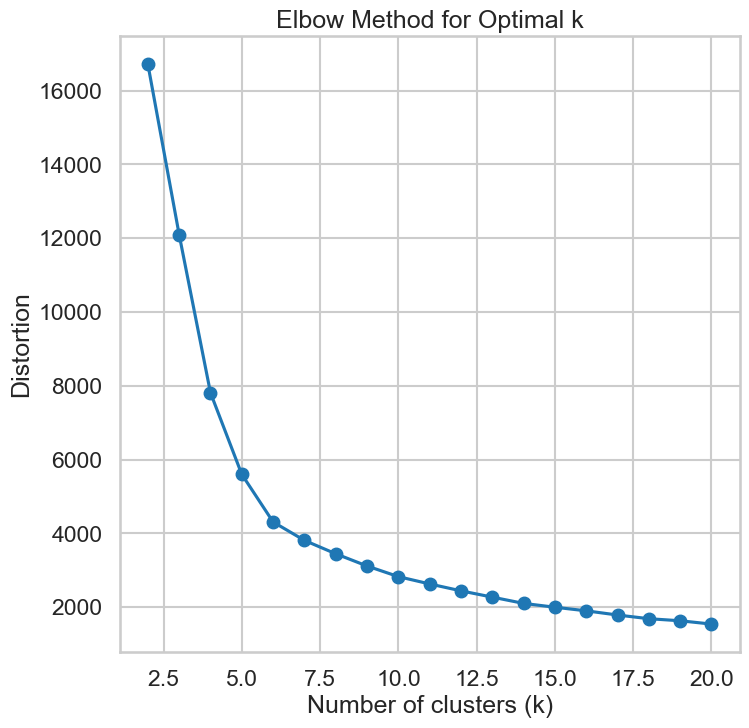

In [6]:
# Plot the distortion values for k means for multiblob dataset
plt.plot(k_values, distortions, marker='o')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Distortion')
plt.title('Elbow Method for Optimal k')
plt.show()

using elbow method, elbow is k=6

## Silhouette score

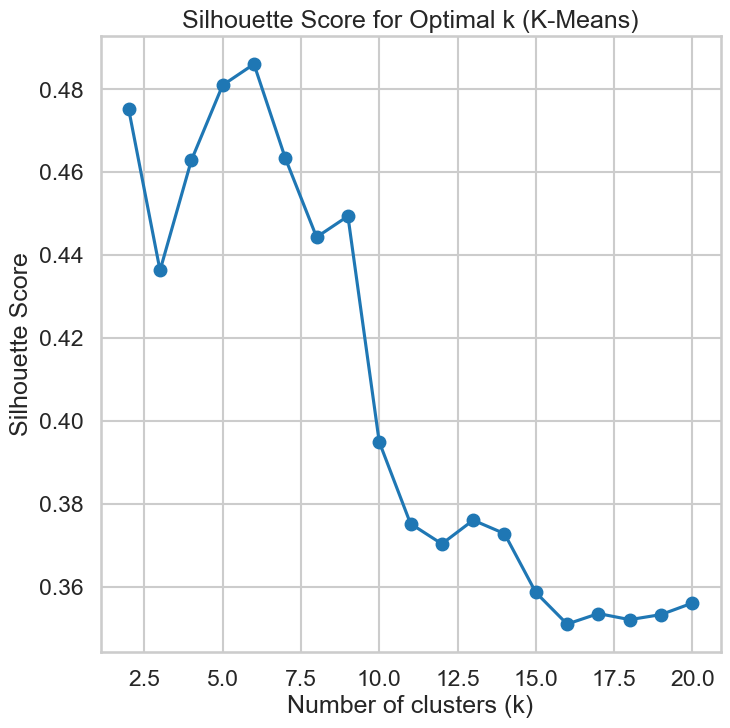

In [7]:
k_values = range(2, 21)
K_Means_silhouette_scores = []

for k in k_values:
    km = KMeans(n_clusters=k)
    km.fit(df[['Feature1', 'Feature2']])
    labels = km.labels_
    K_Means_silhouette_scores.append(silhouette_score(df[['Feature1', 'Feature2']], labels))

# Plot silhouette scores for different k values
plt.plot(k_values, K_Means_silhouette_scores, marker='o')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score for Optimal k (K-Means)')
plt.show()

max at k=6

## Hierarchal Clustering Multiblob data

Affinity: euclidean, Linkage: average, Distance Threshold: 2
36
Affinity: euclidean, Linkage: average, Distance Threshold: 2
Number of clusters: 36
Silhouette Score: 0.3155710172095083



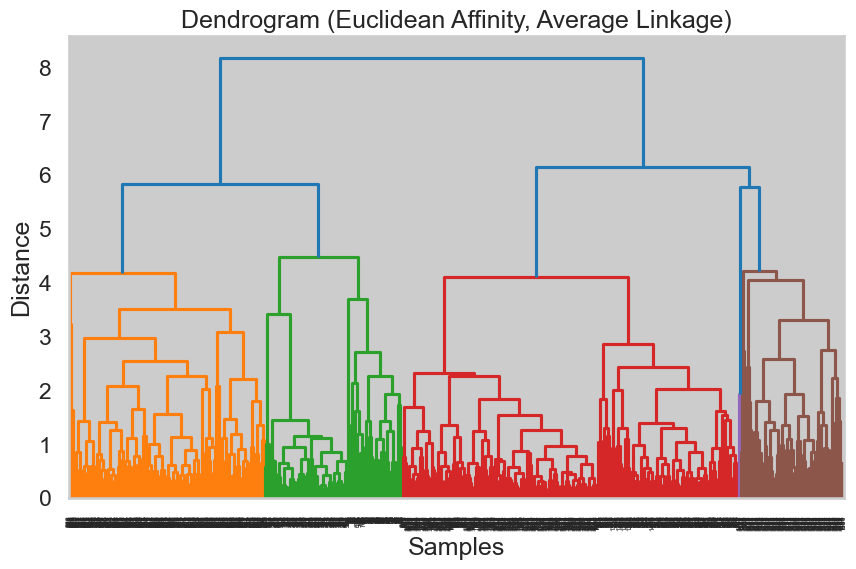

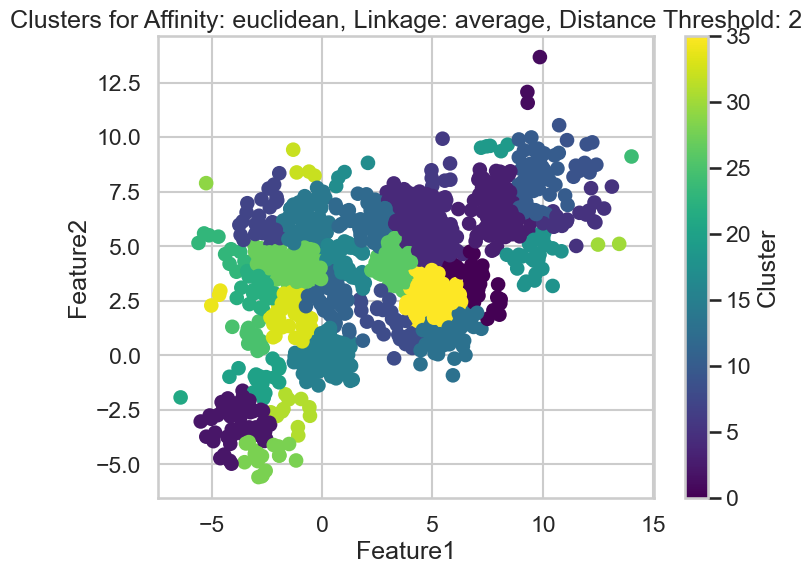

Affinity: euclidean, Linkage: average, Distance Threshold: 3
16
Affinity: euclidean, Linkage: average, Distance Threshold: 3
Number of clusters: 16
Silhouette Score: 0.35500586075131524



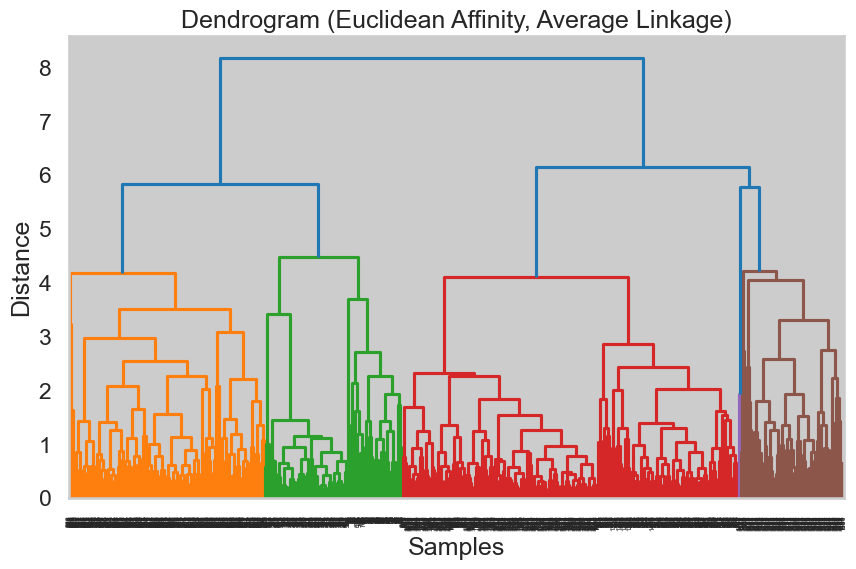

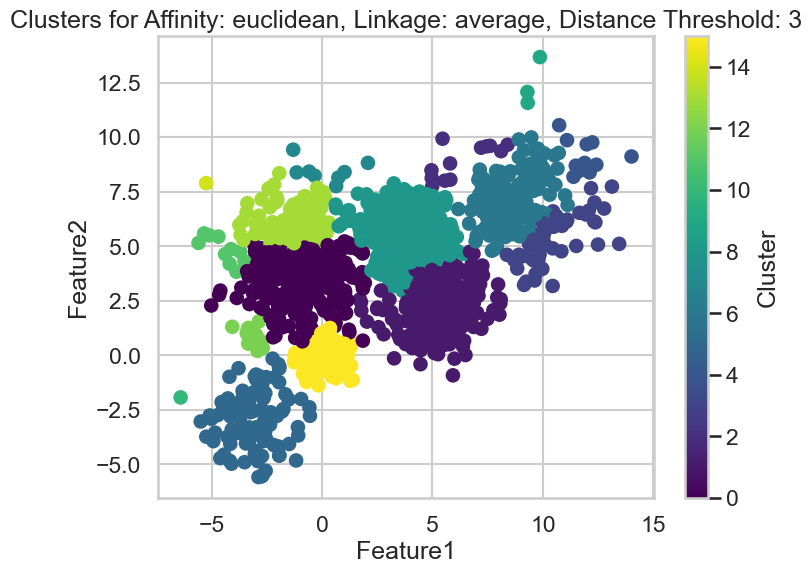

Affinity: euclidean, Linkage: average, Distance Threshold: 4
10
Affinity: euclidean, Linkage: average, Distance Threshold: 4
Number of clusters: 10
Silhouette Score: 0.37378418096239385



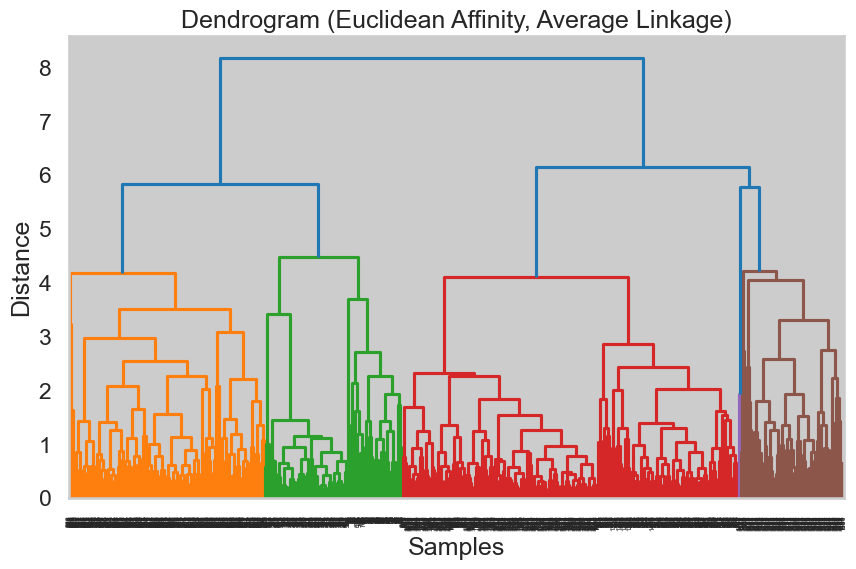

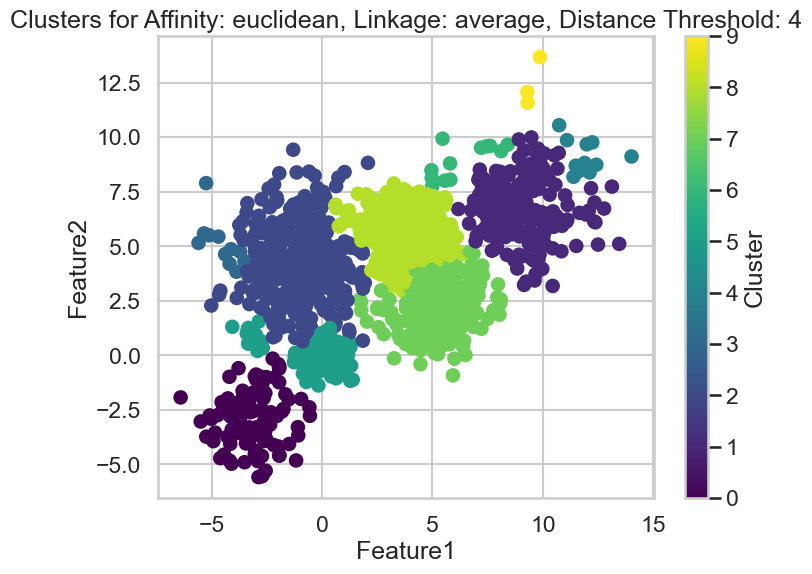

Affinity: euclidean, Linkage: average, Distance Threshold: 5
5
Affinity: euclidean, Linkage: average, Distance Threshold: 5
Number of clusters: 5
Silhouette Score: 0.433187948807373



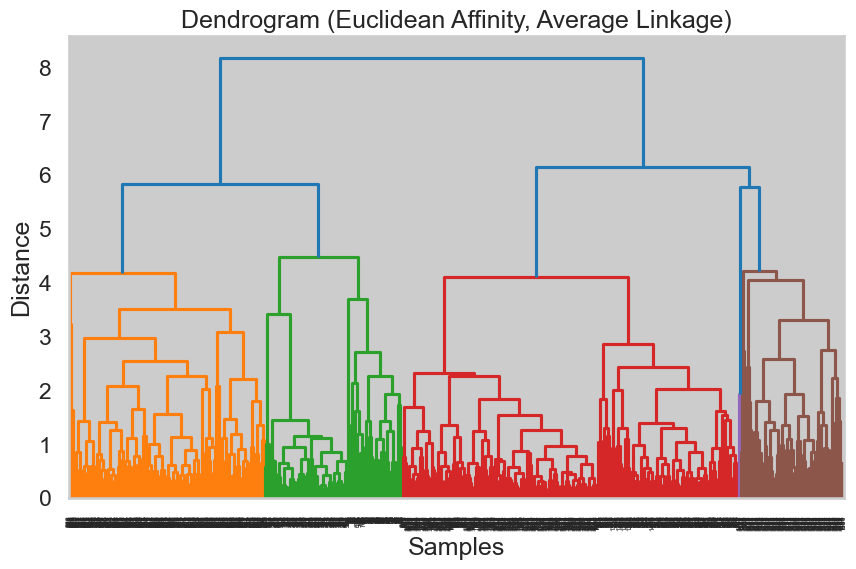

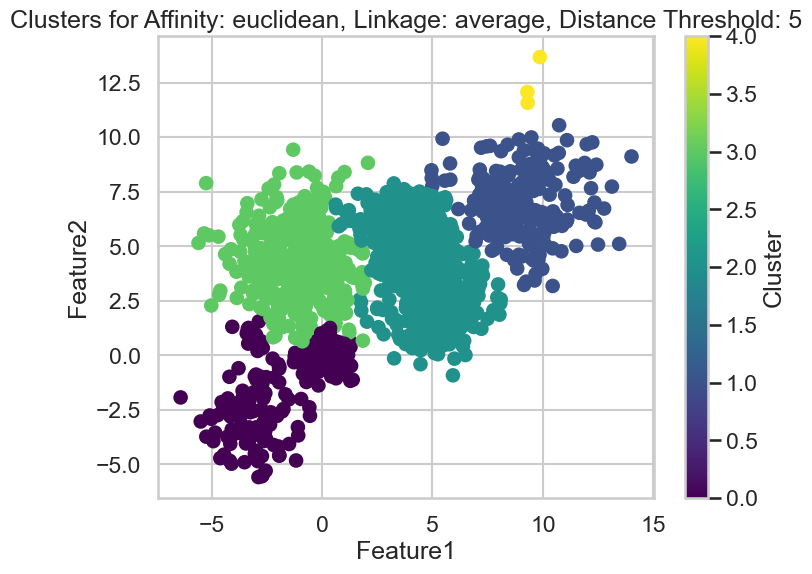

Affinity: euclidean, Linkage: average, Distance Threshold: 6
3
Affinity: euclidean, Linkage: average, Distance Threshold: 6
Number of clusters: 3
Silhouette Score: 0.4307906732655957



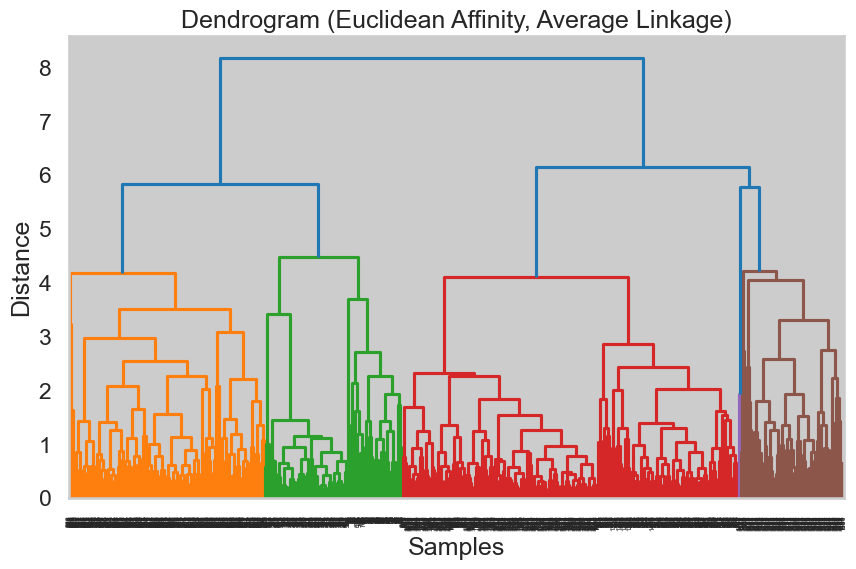

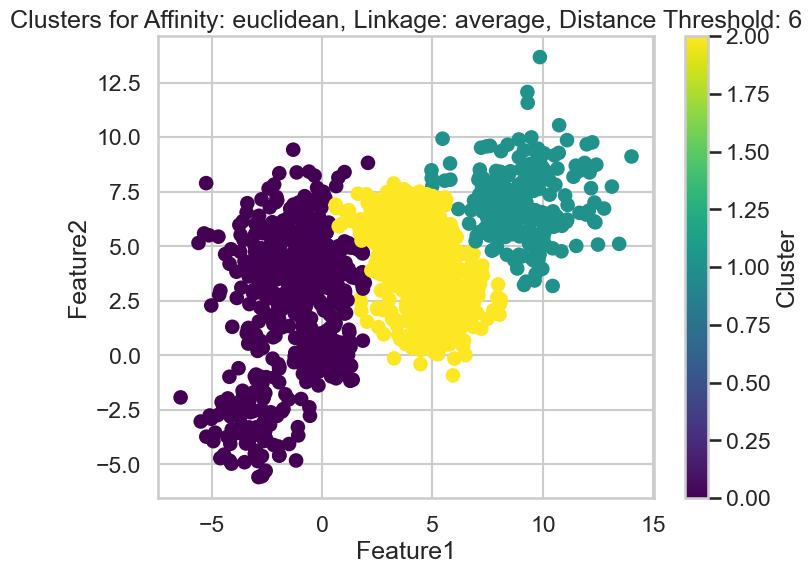

Affinity: euclidean, Linkage: average, Distance Threshold: 7
2
Affinity: euclidean, Linkage: average, Distance Threshold: 7
Number of clusters: 2
Silhouette Score: 0.4716908069861964



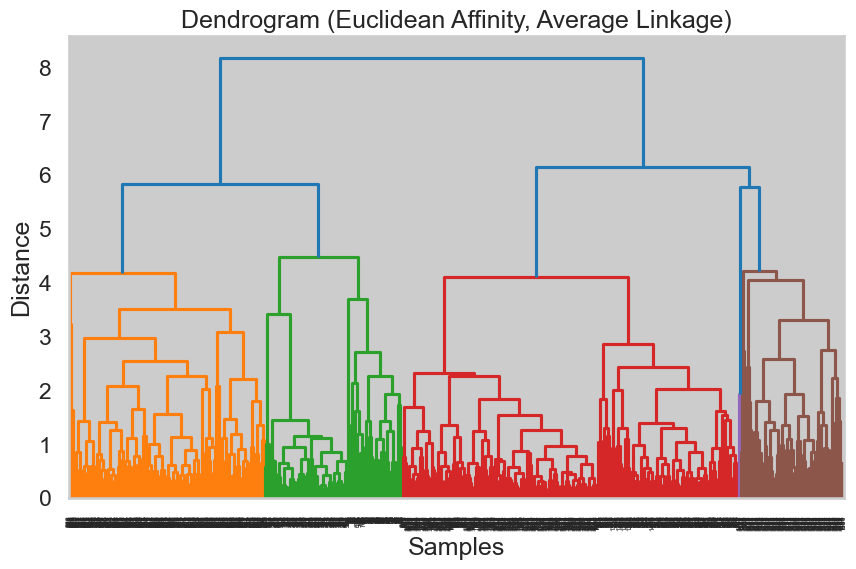

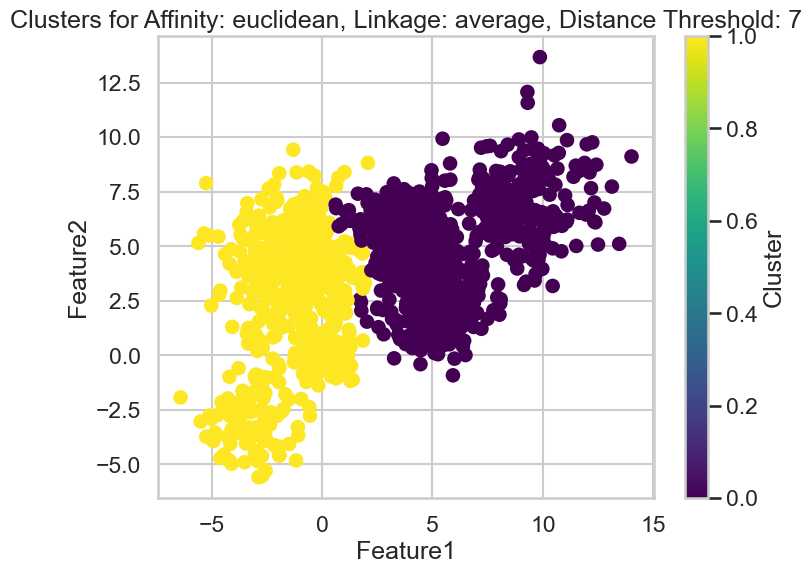

Affinity: euclidean, Linkage: average, Distance Threshold: 8
2
Affinity: euclidean, Linkage: average, Distance Threshold: 8
Number of clusters: 2
Silhouette Score: 0.4716908069861964



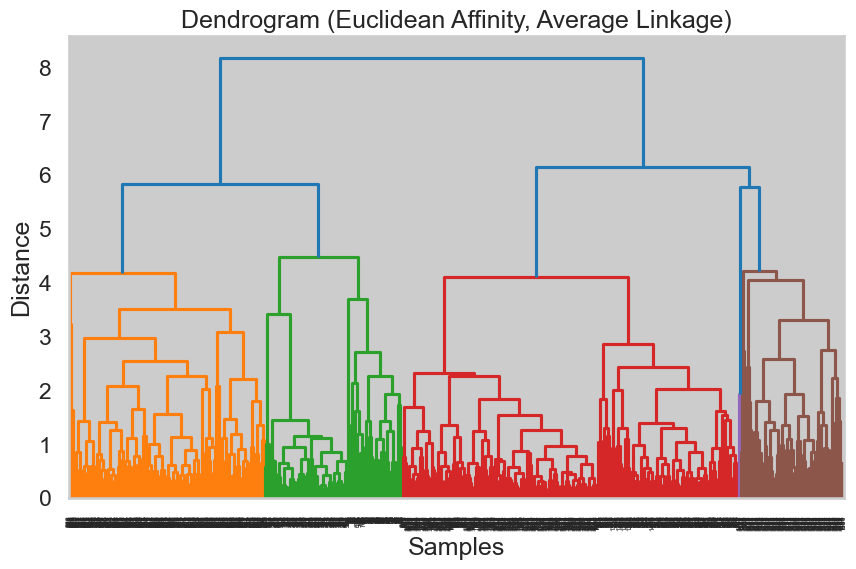

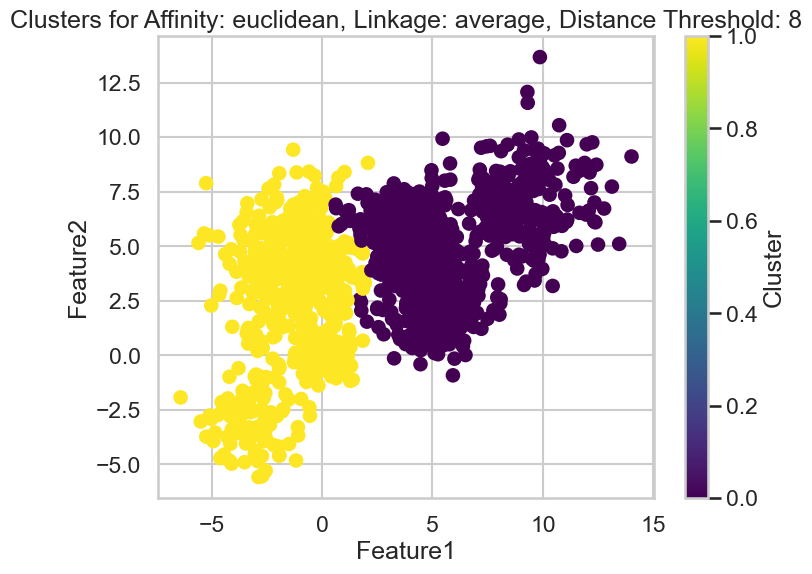

Affinity: euclidean, Linkage: average, Distance Threshold: 9
1
Affinity: euclidean, Linkage: single, Distance Threshold: 2
2
Affinity: euclidean, Linkage: single, Distance Threshold: 2
Number of clusters: 2
Silhouette Score: 0.3218066204847175



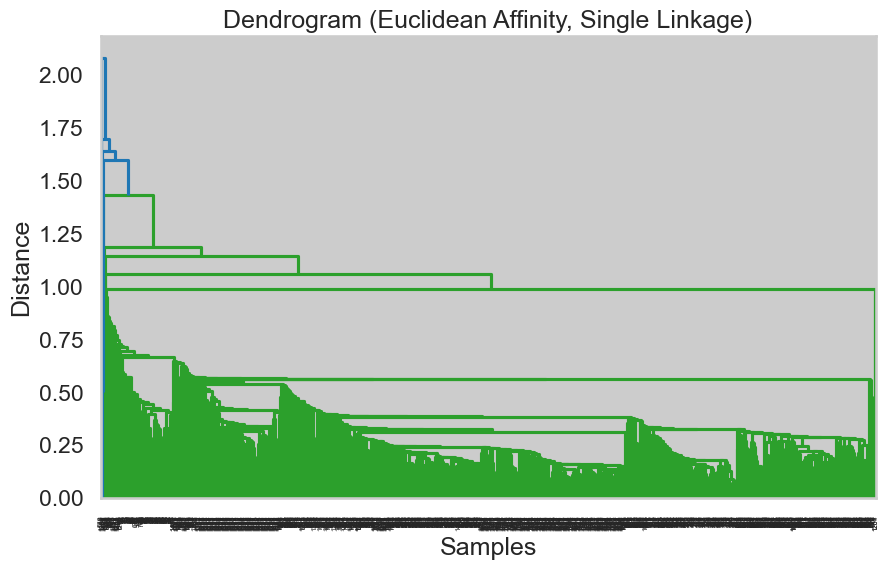

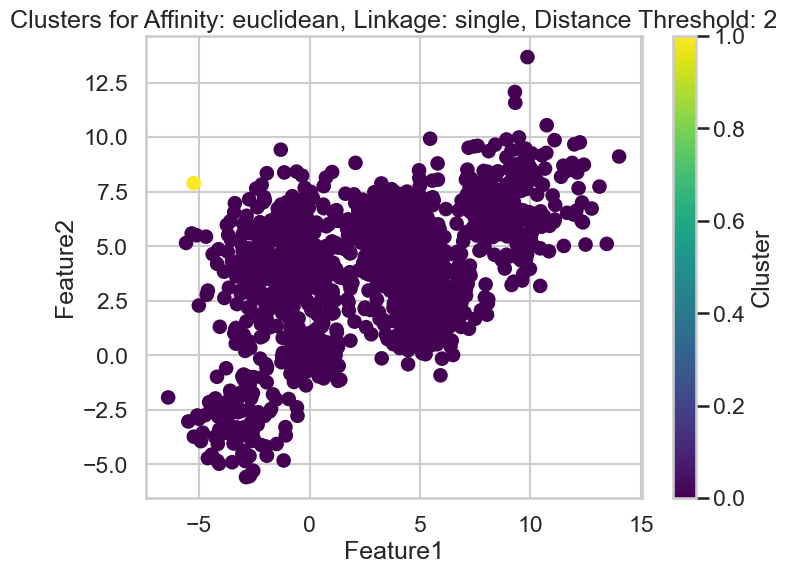

Affinity: euclidean, Linkage: single, Distance Threshold: 3
1
Affinity: euclidean, Linkage: single, Distance Threshold: 4
1
Affinity: euclidean, Linkage: single, Distance Threshold: 5
1
Affinity: euclidean, Linkage: single, Distance Threshold: 6
1
Affinity: euclidean, Linkage: single, Distance Threshold: 7
1
Affinity: euclidean, Linkage: single, Distance Threshold: 8
1
Affinity: euclidean, Linkage: single, Distance Threshold: 9
1
Affinity: cosine, Linkage: average, Distance Threshold: 2
1
Affinity: cosine, Linkage: average, Distance Threshold: 3
1
Affinity: cosine, Linkage: average, Distance Threshold: 4
1
Affinity: cosine, Linkage: average, Distance Threshold: 5
1
Affinity: cosine, Linkage: average, Distance Threshold: 6
1
Affinity: cosine, Linkage: average, Distance Threshold: 7
1
Affinity: cosine, Linkage: average, Distance Threshold: 8
1
Affinity: cosine, Linkage: average, Distance Threshold: 9
1
Affinity: cosine, Linkage: single, Distance Threshold: 2
1
Affinity: cosine, Linkage: 

In [14]:
# Define the range of parameters
affinities = ['euclidean', 'cosine']
linkages = ['average', 'single']
distance_thresholds = range(2, 10)

best_silhouette_score = -1
best_parameters = {}

# Iterate over different parameter combinations
for affinity in affinities:
    for linkage_method in linkages:
        for distance_threshold in distance_thresholds:
            agg_clustering = AgglomerativeClustering(n_clusters=None, affinity=affinity, linkage=linkage_method, distance_threshold=distance_threshold)
            # Fit the model to the data
            agg_clustering.fit(df[['Feature1', 'Feature2']])
            
            no_of_unique_clusters = len(np.unique(agg_clustering.labels_))
            
            print(f"Affinity: {affinity}, Linkage: {linkage_method}, Distance Threshold: {distance_threshold}")
            print(no_of_unique_clusters)
            
            if no_of_unique_clusters > 1:
                # Compute silhouette score
                silhouette_avg = silhouette_score(df[['Feature1', 'Feature2']], agg_clustering.labels_)
                # Check if the current silhouette score is the best so far
                if silhouette_avg > best_silhouette_score:
                    best_silhouette_score = silhouette_avg
                    best_parameters = {'Affinity': affinity, 'Linkage': linkage_method, 'Distance Threshold': distance_threshold}

                # Display the resulting clusters
                print(f"Affinity: {affinity}, Linkage: {linkage_method}, Distance Threshold: {distance_threshold}")
                print(f"Number of clusters: {agg_clustering.n_clusters_}")
                print(f"Silhouette Score: {silhouette_avg}\n")
                
                # Plot dendrogram
                plt.figure(figsize=(10, 6))
                dendrogram(linkage(df[['Feature1', 'Feature2']], method=linkage_method, metric=affinity))
                plt.title(f'Dendrogram ({affinity.capitalize()} Affinity, {linkage_method.capitalize()} Linkage)')
                plt.xlabel('Samples')  # Fixing the x-axis label here
                plt.ylabel('Distance')
                plt.show()
                
                # Visualize clusters
                plt.figure(figsize=(8, 6))
                plt.scatter(df['Feature1'], df['Feature2'], c=agg_clustering.labels_, cmap='viridis')
                plt.title(f'Clusters for Affinity: {affinity}, Linkage: {linkage_method}, Distance Threshold: {distance_threshold}')
                plt.xlabel('Feature1')  # Fixing the x-axis label here
                plt.ylabel('Feature2')
                plt.colorbar(label='Cluster')
                plt.show()
                
            else:
                continue


### Hierarchal Clustering Best Parameters

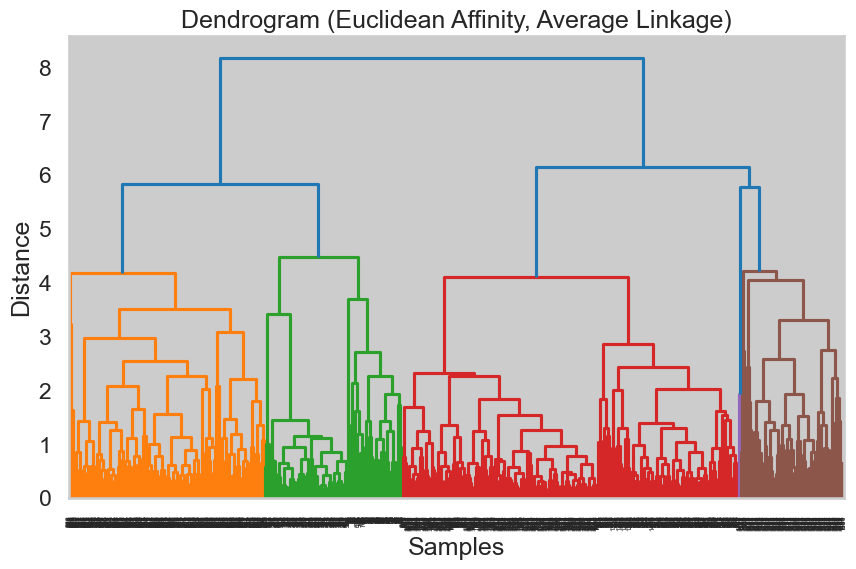

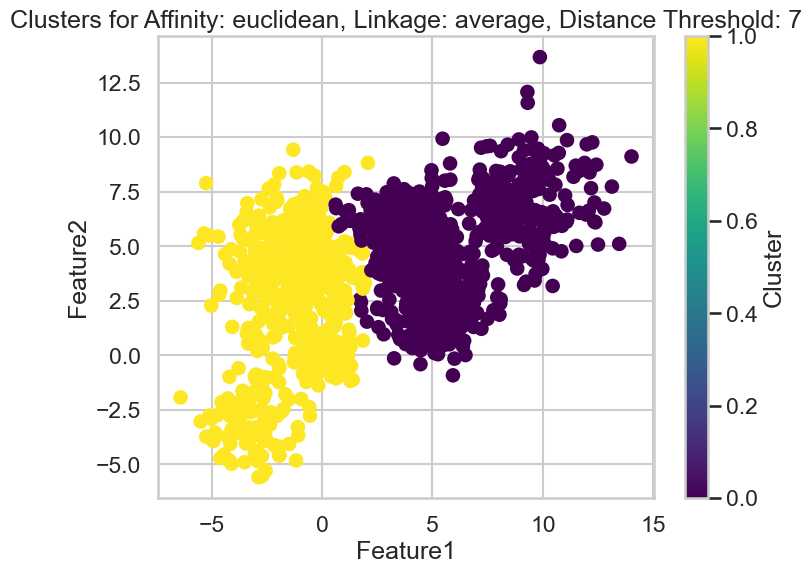

Best No.of clusters: 2
Best Parameters:
{'Affinity': 'euclidean', 'Linkage': 'average', 'Distance Threshold': 7}


In [15]:

plt.figure(figsize=(10, 6))
dendrogram(linkage(df[['Feature1', 'Feature2']], method=best_parameters['Linkage'], metric=best_parameters['Affinity']))
plt.title(f'Dendrogram ({best_parameters["Affinity"].capitalize()} Affinity, {best_parameters["Linkage"].capitalize()} Linkage)')
plt.xlabel('Samples')
plt.ylabel('Distance')
plt.show()


agg_clustering = AgglomerativeClustering(n_clusters=None, affinity=best_parameters['Affinity'], linkage=best_parameters['Linkage'], distance_threshold=best_parameters['Distance Threshold'])
# Fit the model to the data
agg_clustering.fit(df[['Feature1', 'Feature2']])
            

# Visualize clusters
plt.figure(figsize=(8, 6))
plt.scatter(df['Feature1'], df['Feature2'], c=agg_clustering.labels_, cmap='viridis')
plt.title(f'Clusters for Affinity: {best_parameters["Affinity"]}, Linkage: {best_parameters["Linkage"]}, Distance Threshold: {best_parameters["Distance Threshold"]}')
plt.xlabel('Feature1')  # Fixing the x-axis label here
plt.ylabel('Feature2')
plt.colorbar(label='Cluster')
plt.show()

print(f"Best No.of clusters: {len(np.unique(agg_clustering.labels_))}")
print("Best Parameters:")
print(best_parameters)


## DBScan Clustering Multiblob data


In [24]:
# Define the range of parameters
EPS_range = np.linspace(0.1, 3, 30)
Min_samples_range = range(5, 26)

best_silhouette_score = -1
best_parameters = {}

# Iterate over different parameter combinations
for EPS in EPS_range:
    for Min_samples in Min_samples_range:
        dbscan = DBSCAN(eps=EPS, min_samples=Min_samples)
        # Fit the model to the data
        dbscan.fit(df[['Feature1', 'Feature2']])
        no_of_unique_clusters = len(np.unique(dbscan.labels_))
            
        if no_of_unique_clusters > 1:
        
            # Compute silhouette score
            silhouette_avg = silhouette_score(df[['Feature1', 'Feature2']], dbscan.labels_)
            
            '''            
            # Plot the resulting clusters
            plt.figure(figsize=(8, 6))
            plt.scatter(df['Feature1'], df['Feature2'], c=dbscan.labels_, cmap='viridis')
            plt.title(f'Clusters for EPS: {EPS}, Min_samples: {Min_samples}')
            plt.xlabel('Feature1')
            plt.ylabel('Feature2')
            plt.colorbar(label='Cluster')
            plt.show()
            '''
            
            # Print silhouette score and parameters
            print(f"EPS: {EPS}, Min_samples: {Min_samples}")
            print(f"Number of clusters: {len(np.unique(dbscan.labels_))}")  # Exclude noise label
            print(f"Silhouette Score: {silhouette_avg}\n")

            # Check if the current silhouette score is the best so far
            if silhouette_avg > best_silhouette_score:
                best_silhouette_score = silhouette_avg
                best_parameters = {'EPS': EPS, 'Min_samples': Min_samples}
        else:
            continue


EPS: 0.1, Min_samples: 5
Number of clusters: 12
Silhouette Score: -0.5423348432605972

EPS: 0.1, Min_samples: 6
Number of clusters: 5
Silhouette Score: -0.5008065260955386

EPS: 0.2, Min_samples: 5
Number of clusters: 39
Silhouette Score: -0.3999643249301035

EPS: 0.2, Min_samples: 6
Number of clusters: 23
Silhouette Score: -0.4180866874540623

EPS: 0.2, Min_samples: 7
Number of clusters: 17
Silhouette Score: -0.48893307519972995

EPS: 0.2, Min_samples: 8
Number of clusters: 13
Silhouette Score: -0.44633773926928655

EPS: 0.2, Min_samples: 9
Number of clusters: 10
Silhouette Score: -0.44848274895257567

EPS: 0.2, Min_samples: 10
Number of clusters: 8
Silhouette Score: -0.4342356562032568

EPS: 0.2, Min_samples: 11
Number of clusters: 9
Silhouette Score: -0.44713367908702734

EPS: 0.2, Min_samples: 12
Number of clusters: 4
Silhouette Score: -0.4406511275226322

EPS: 0.2, Min_samples: 13
Number of clusters: 4
Silhouette Score: -0.44353913688654695

EPS: 0.2, Min_samples: 14
Number of clu

#### silhouette score versus variation in EPS and Min_samples

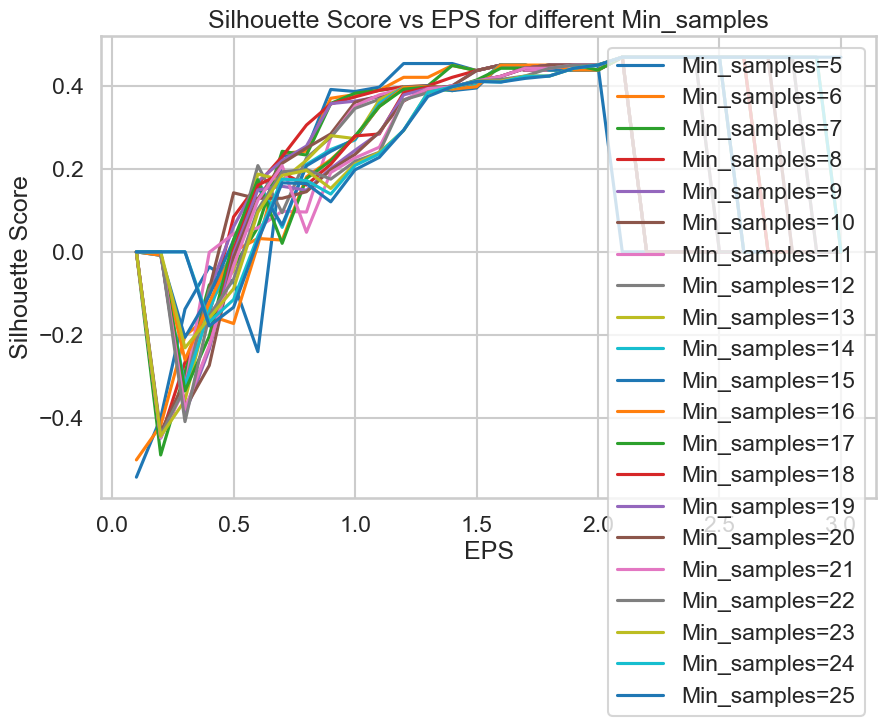

In [25]:
# Plot silhouette score versus variation in EPS and Min_samples
plt.figure(figsize=(10, 6))
for Min_samples in Min_samples_range:
    silhouette_scores = np.zeros_like(EPS_range)
    for i, EPS in enumerate(EPS_range):
        dbscan = DBSCAN(eps=EPS, min_samples=Min_samples)
        dbscan.fit(df[['Feature1', 'Feature2']])
        no_of_unique_clusters = len(np.unique(dbscan.labels_))
            
        if no_of_unique_clusters > 1:
            silhouette_scores[i] = silhouette_score(df[['Feature1', 'Feature2']], dbscan.labels_)
    plt.plot(EPS_range, silhouette_scores, label=f'Min_samples={Min_samples}')
plt.xlabel('EPS')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score vs EPS for different Min_samples')
plt.legend()
plt.show()

### DBSCAN Best Parameters

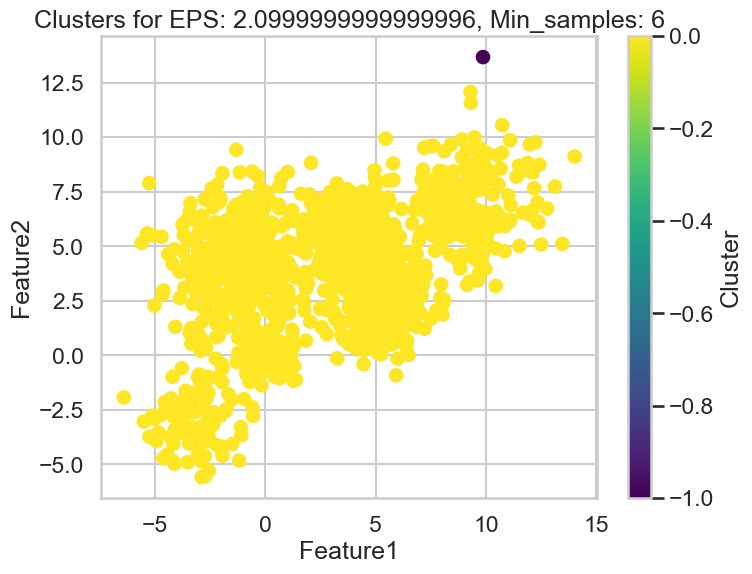

Best parameters:
{'EPS': 2.0999999999999996, 'Min_samples': 6}
Best Silhouette Score: 0.4685207355522043
Best No.of Clusters: 2


In [26]:
# Create a DBSCAN instance with the best parameters
best_dbscan = DBSCAN(eps=best_parameters['EPS'], min_samples=best_parameters['Min_samples'])

# Fit the model to the data
best_dbscan.fit(df[['Feature1', 'Feature2']])

# Plot the resulting clusters
plt.figure(figsize=(8, 6))
plt.scatter(df['Feature1'], df['Feature2'], c=best_dbscan.labels_, cmap='viridis')
plt.title(f'Clusters for EPS: {best_parameters["EPS"]}, Min_samples: {best_parameters["Min_samples"]}')
plt.xlabel('Feature1')
plt.ylabel('Feature2')
plt.colorbar(label='Cluster')
plt.show()

# Print the best parameters
print("Best parameters:")
print(best_parameters)
print(f"Best Silhouette Score: {best_silhouette_score}")
print(f"Best No.of Clusters: {len(np.unique(best_dbscan.labels_))}")





### Gaussian Mixture for Multiblob
 

In [27]:
covariance_types = ['full', 'tied', 'diag', 'spherical']

In [28]:
k_values = range(2, 11)
GMM_silhouette_scores = []

best_silhouette_score = -1
best_k = None
best_covariance_type = None

for k in k_values:
    for covariance_type in covariance_types:
        # Create and fit the Gaussian Mixture Model
        gmm = GaussianMixture(n_components=k, covariance_type=covariance_type, random_state=42)
        gmm.fit(df[['Feature1', 'Feature2']])

        # Calculate silhouette score
        labels = gmm.predict(df[['Feature1', 'Feature2']])
        silhouette_avg = silhouette_score(df[['Feature1', 'Feature2']], labels)
        GMM_silhouette_scores.append(silhouette_avg)

        # Check if the current silhouette score is better than the previous best score
        if silhouette_avg > best_silhouette_score:
            best_silhouette_score = silhouette_avg
            best_k = k
            best_covariance_type = covariance_type

# Print the best silhouette score, K, and covariance type
print("Best Silhouette Score:", best_silhouette_score)
print("Best K:", best_k)
print("Best Covariance Type:", best_covariance_type)


Best Silhouette Score: 0.48598896083665893
Best K: 6
Best Covariance Type: tied


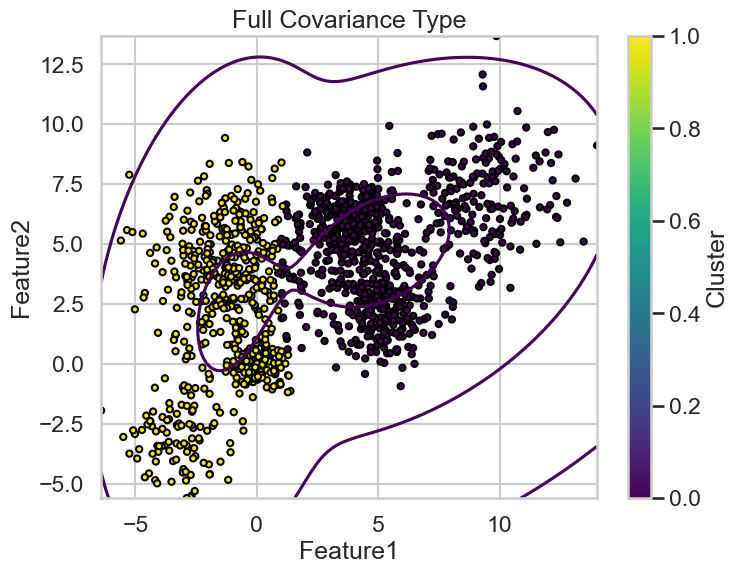

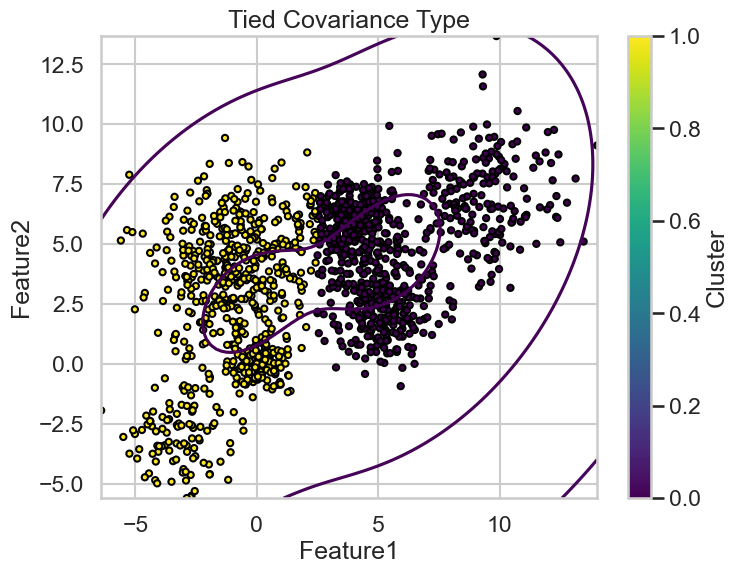

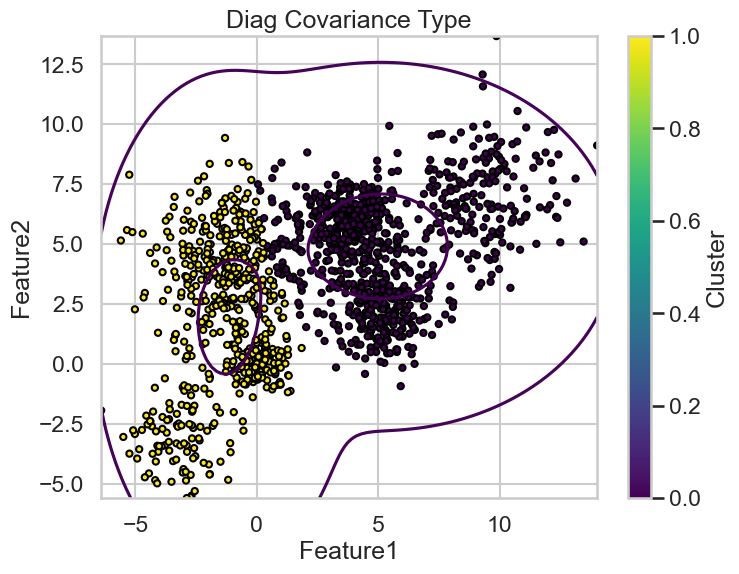

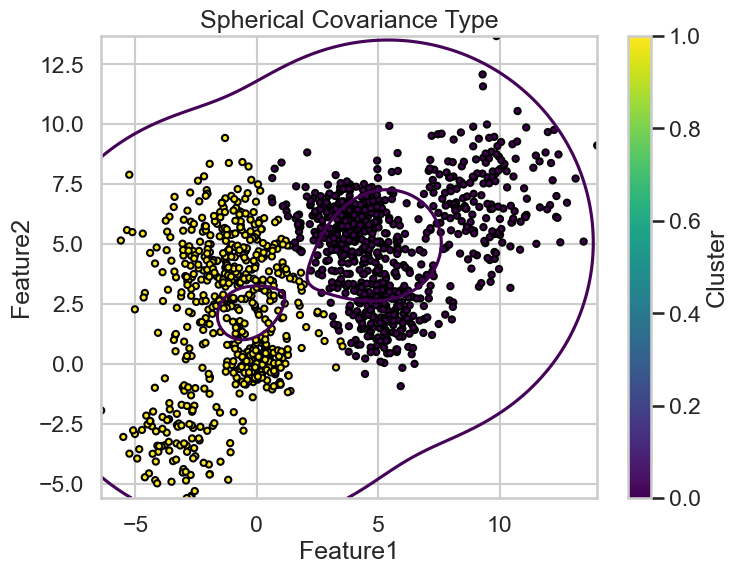

In [29]:
for covariance_type in covariance_types:
    # Create and fit the Gaussian Mixture Model
    gmm = GaussianMixture(n_components=2, covariance_type=covariance_type, random_state=42)
    gmm.fit(df[['Feature1', 'Feature2']])

    # Create a meshgrid for plotting the contour plot
    x = np.linspace(df['Feature1'].min(), df['Feature1'].max(), 100)
    y = np.linspace(df['Feature2'].min(), df['Feature2'].max(), 100)
    X, Y = np.meshgrid(x, y)
    XX = np.array([X.ravel(), Y.ravel()]).T
    
    # Get the probabilities for each point in the meshgrid
    Z = -gmm.score_samples(XX)
    Z = Z.reshape(X.shape)
    
    # Plot the contour plot
    plt.figure(figsize=(8, 6))
    plt.contour(X, Y, Z, levels=np.logspace(0, 3, 10), cmap='viridis')
    plt.scatter(df['Feature1'], df['Feature2'], c=gmm.predict(df[['Feature1', 'Feature2']]), cmap='viridis', s=20, edgecolor='k')
    plt.title(f'{covariance_type.capitalize()} Covariance Type')
    plt.xlabel('Feature1')
    plt.ylabel('Feature2')
    plt.colorbar(label='Cluster')
    plt.show()


# iris dataset 

In [30]:
from sklearn.datasets import load_iris
iris_data = load_iris()
iris_data.target[[10, 25, 50]]
#array([0, 0, 1])
list(iris_data.target_names)
['setosa', 'versicolor', 'virginica']

['setosa', 'versicolor', 'virginica']

In [31]:
iris_df = pd.DataFrame(data=iris_data.data, columns=iris_data.feature_names)

## K-Means iris dataset

------------------------------------------------------------------------------------------------------


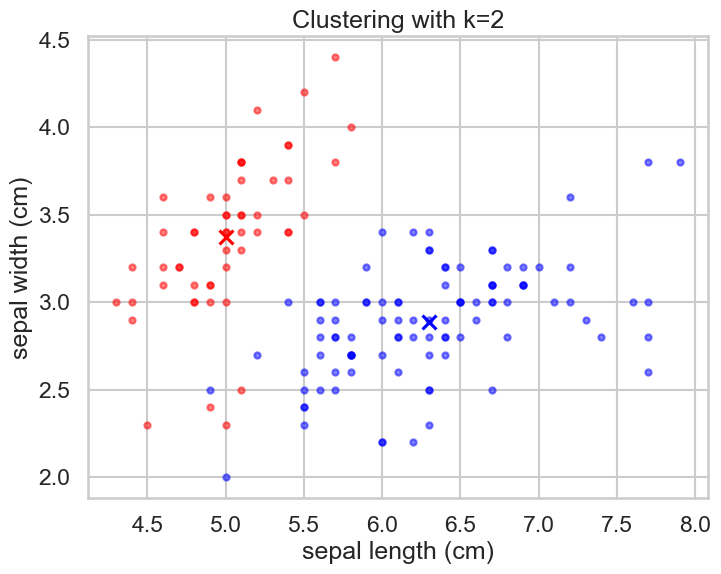

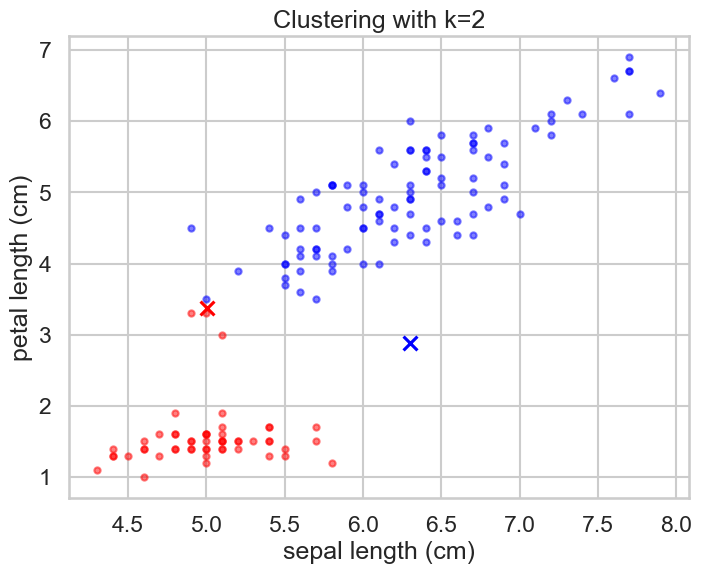

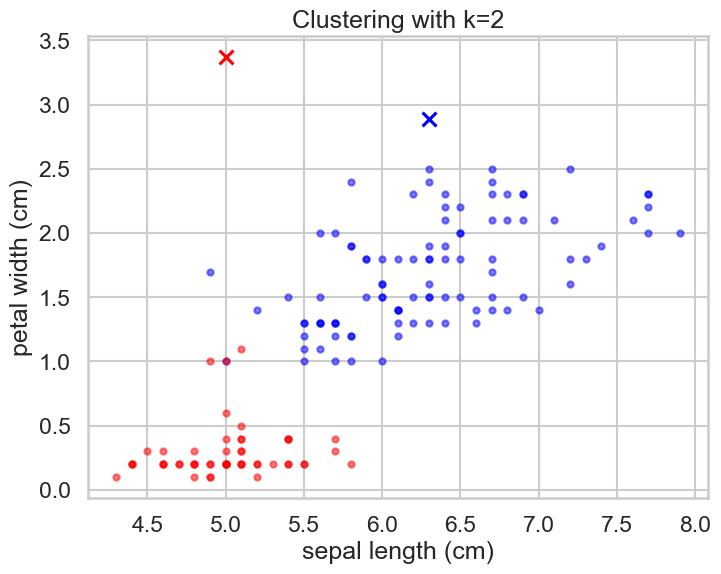

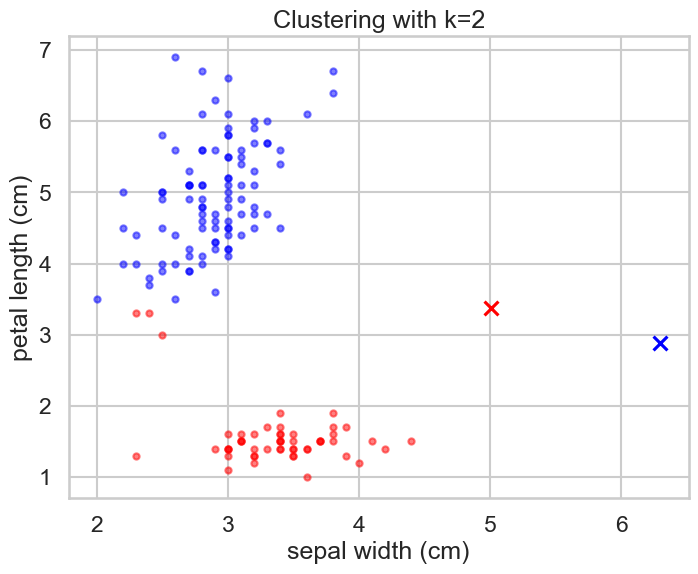

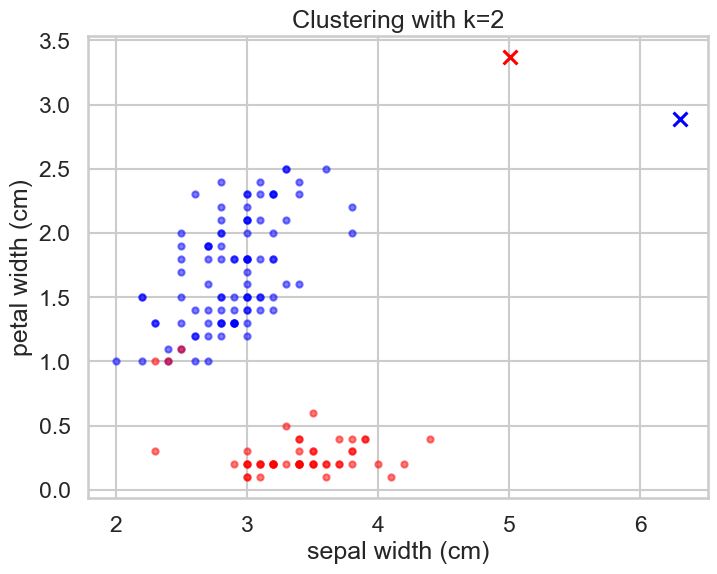

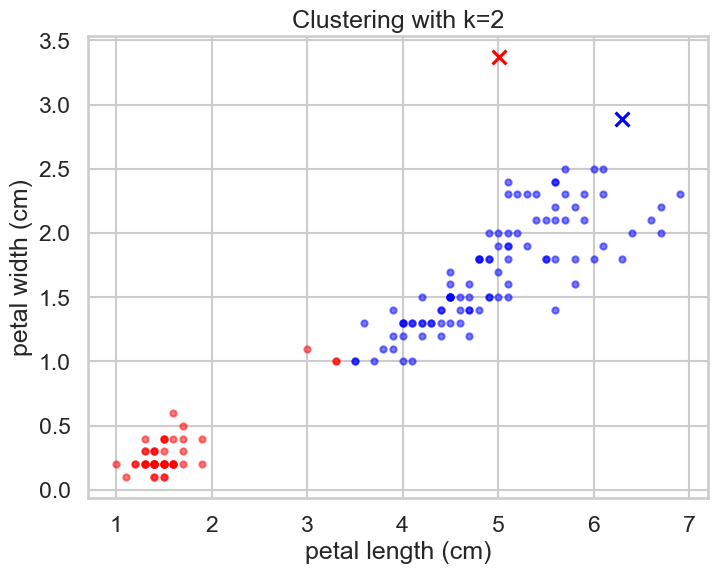

------------------------------------------------------------------------------------------------------


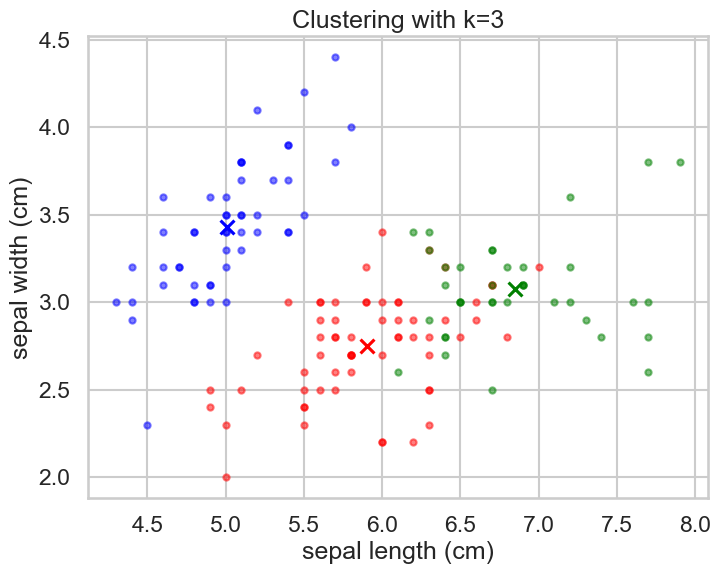

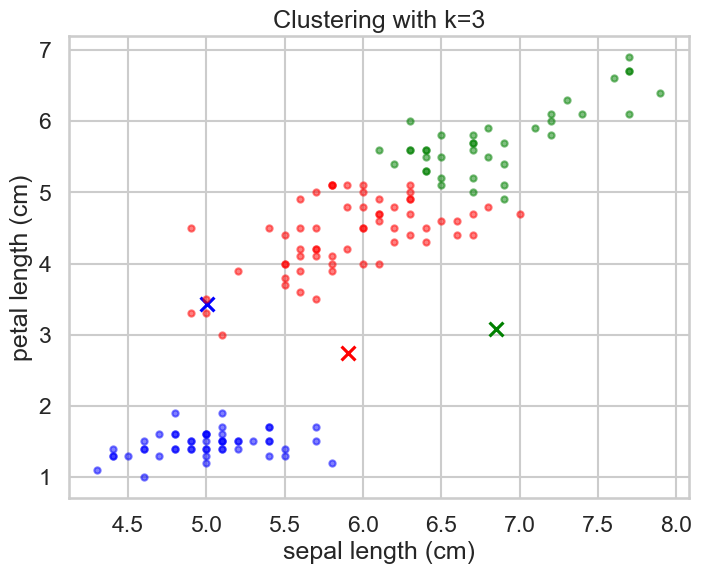

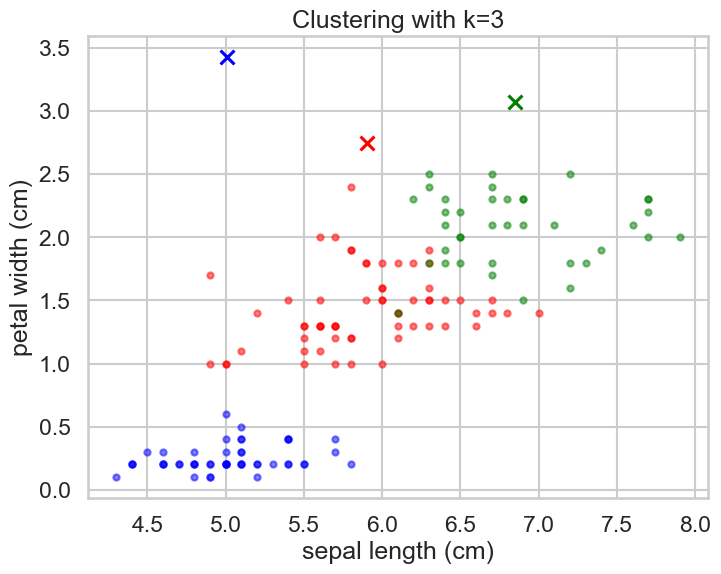

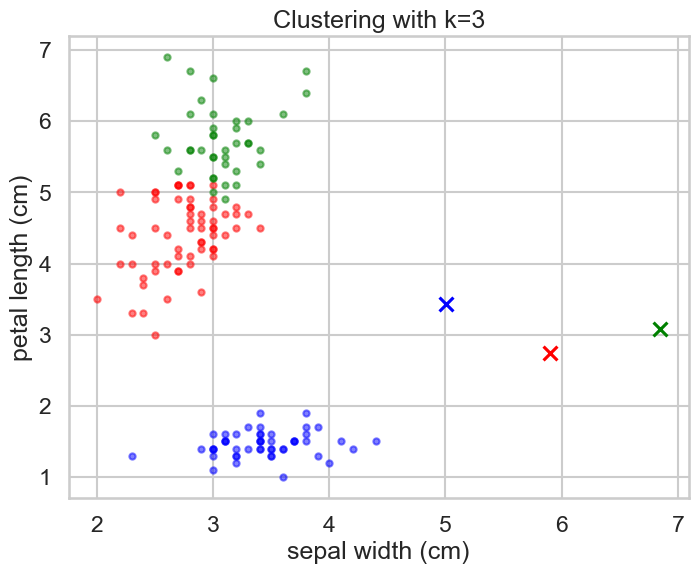

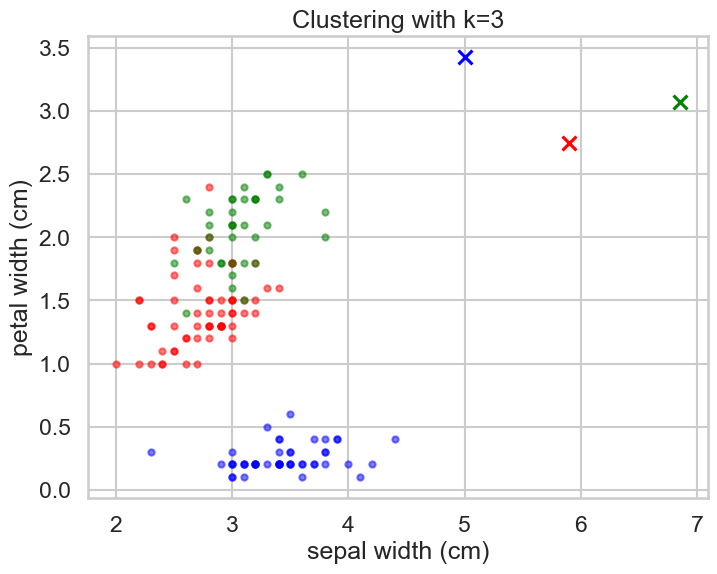

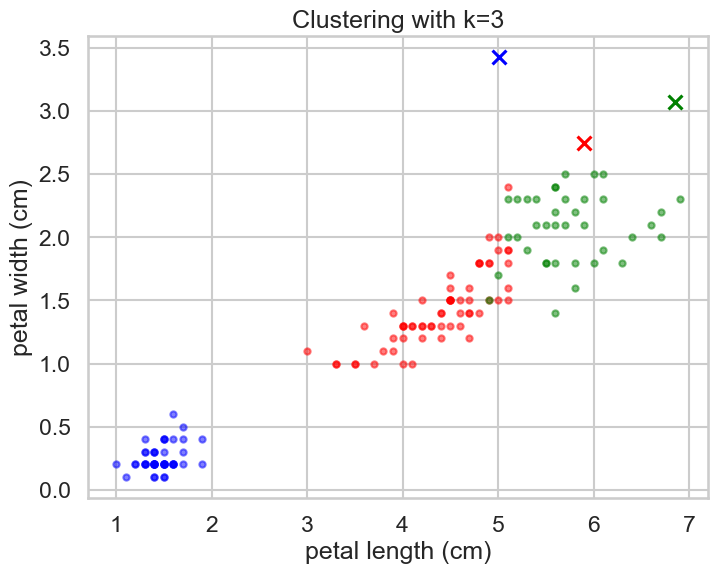

------------------------------------------------------------------------------------------------------


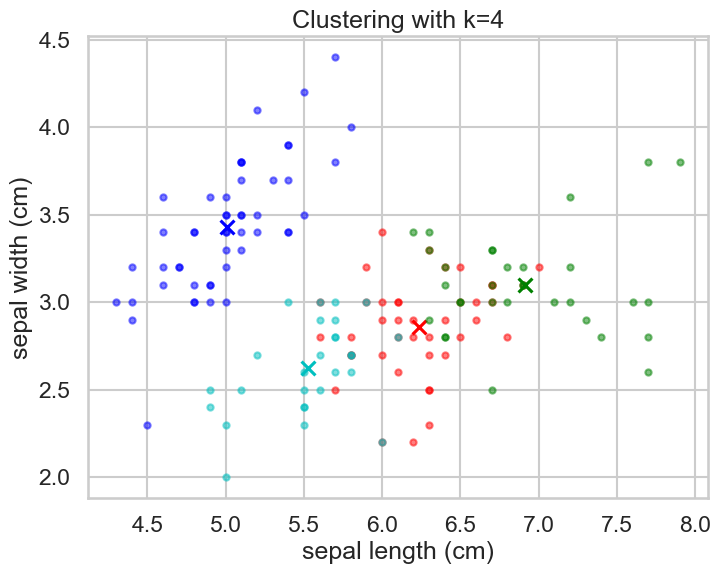

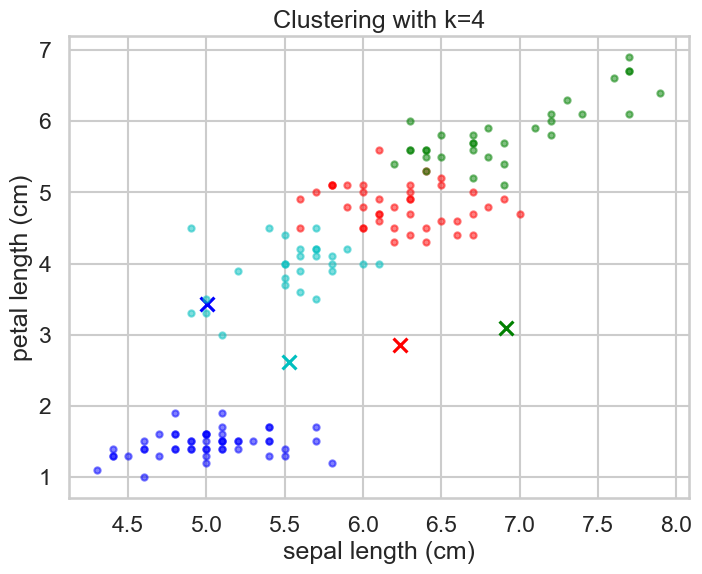

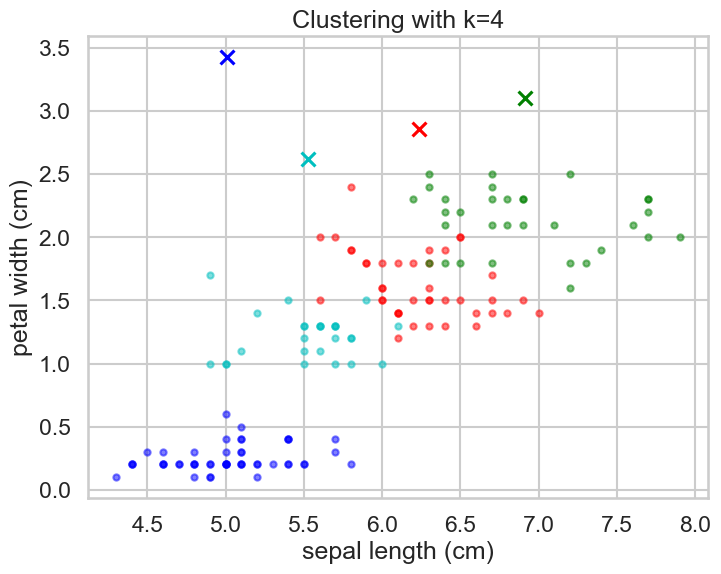

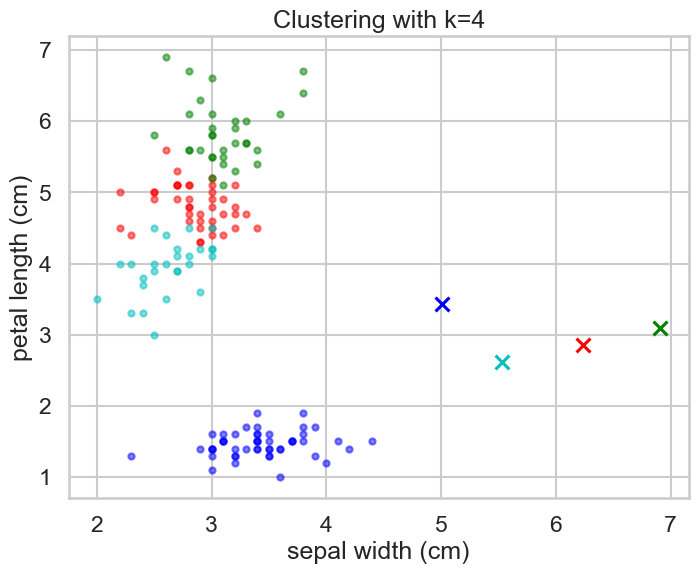

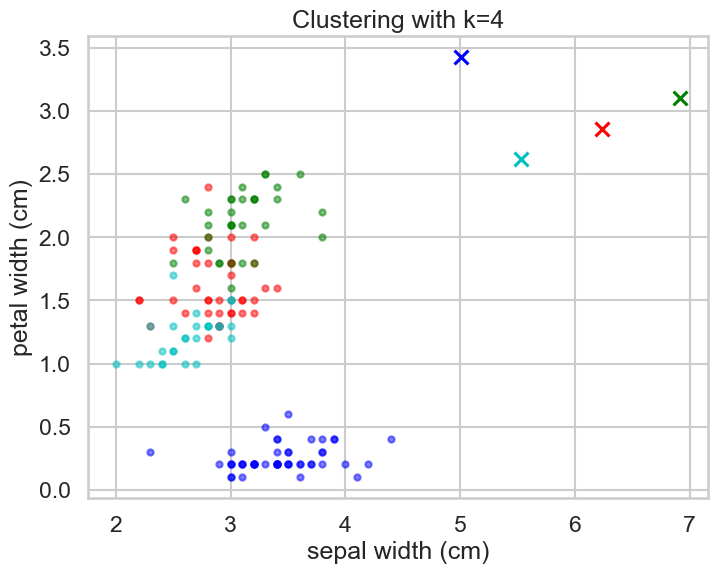

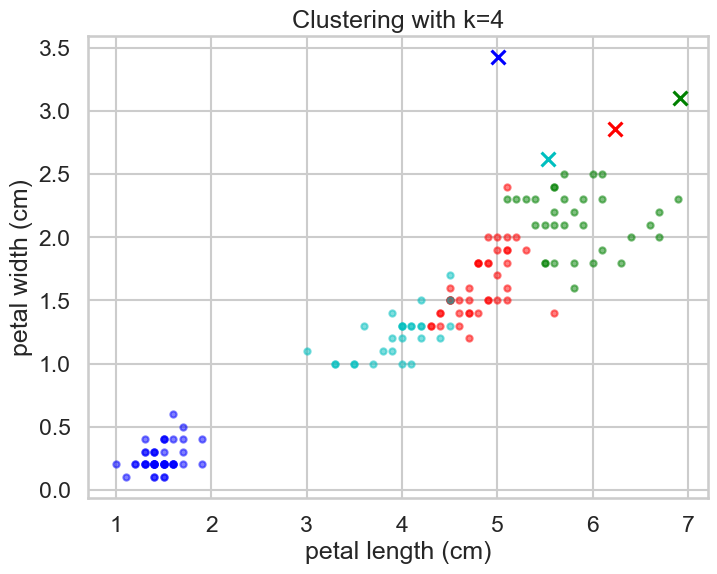

------------------------------------------------------------------------------------------------------


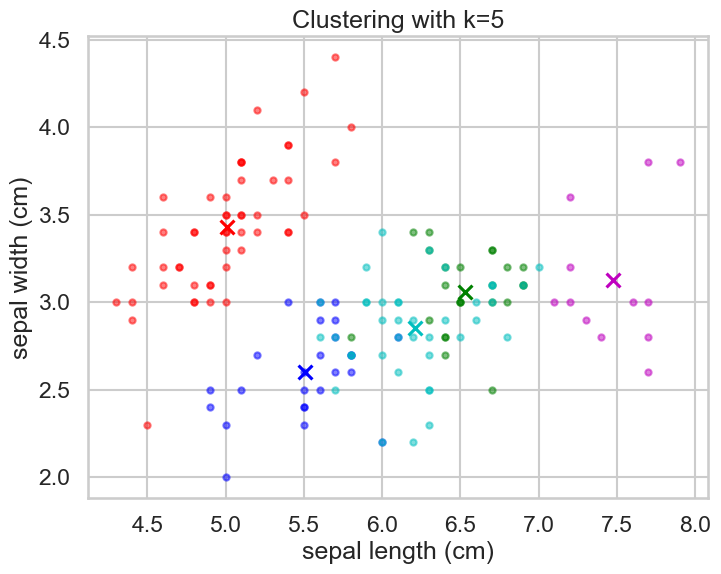

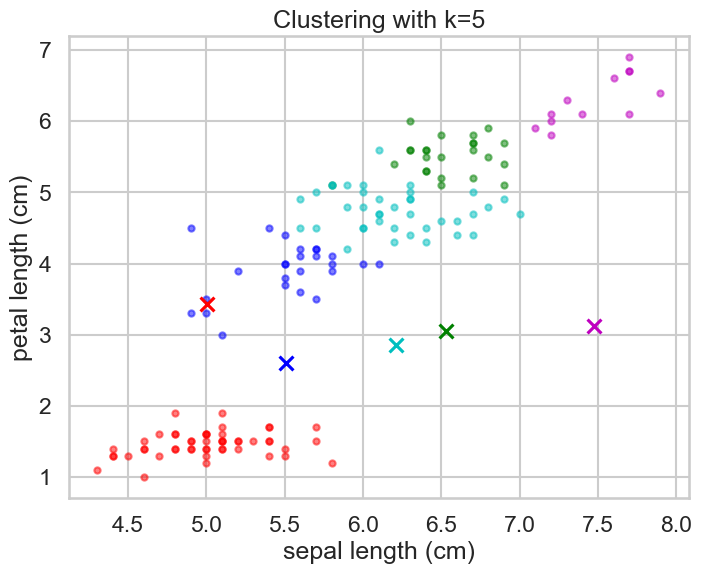

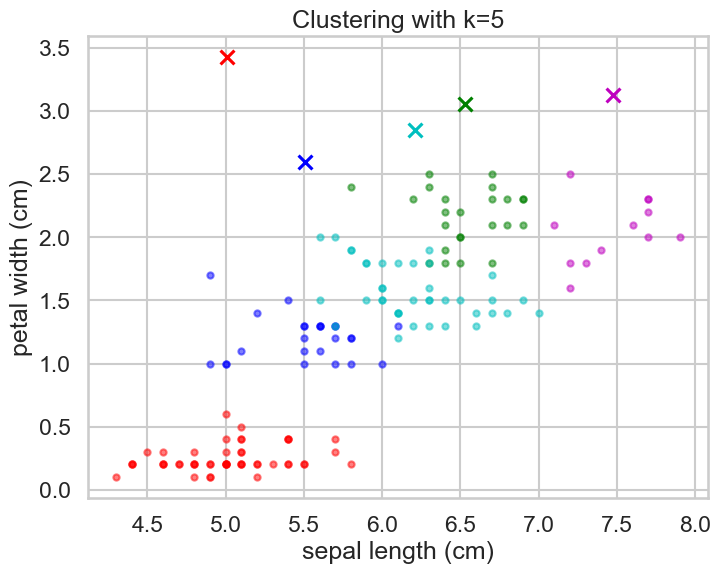

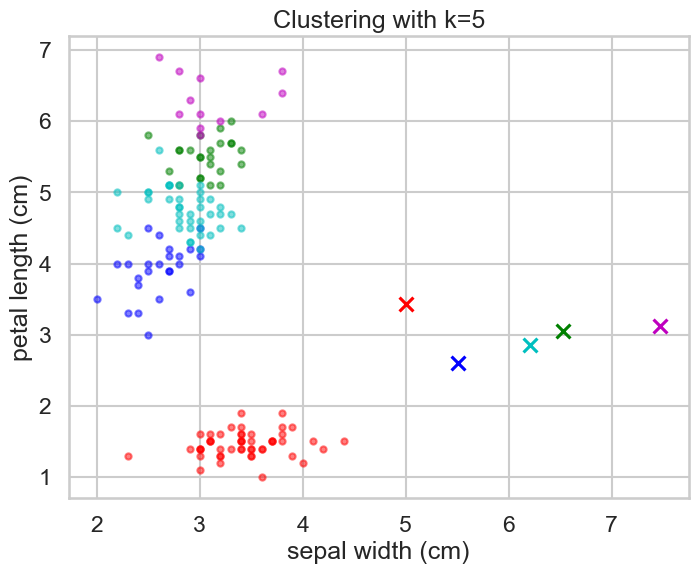

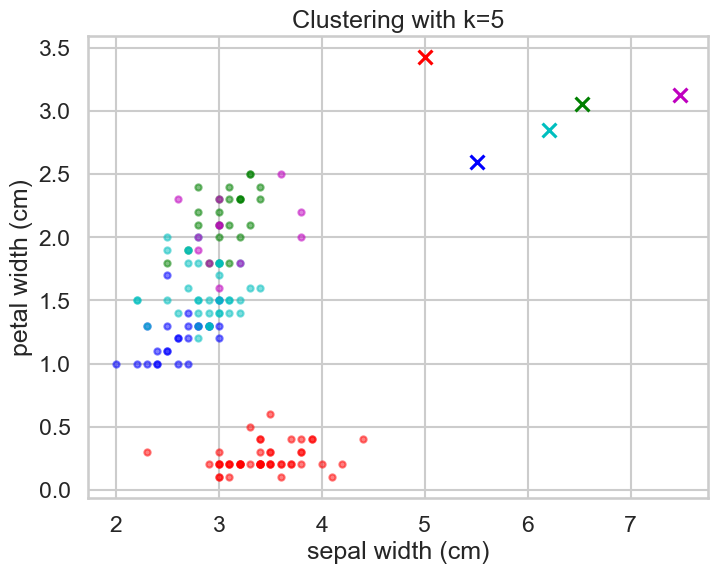

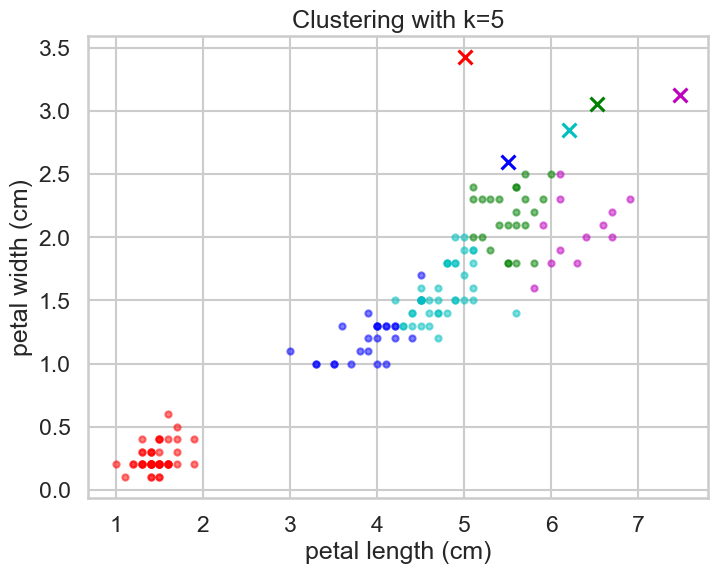

------------------------------------------------------------------------------------------------------


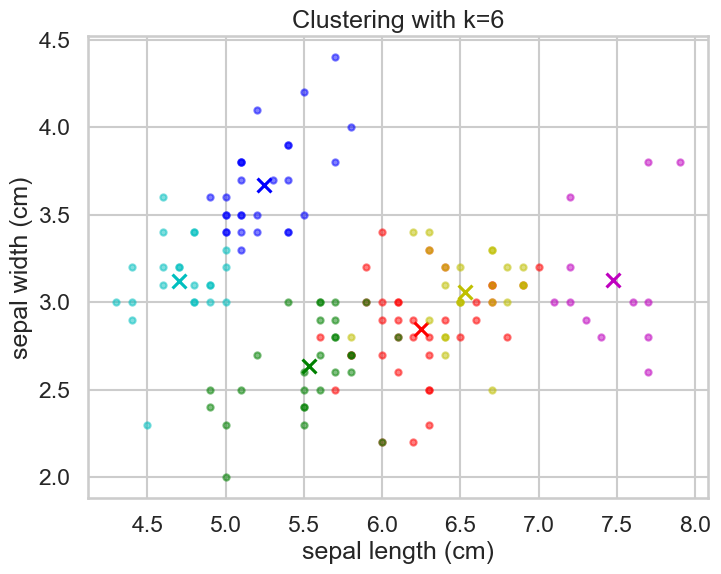

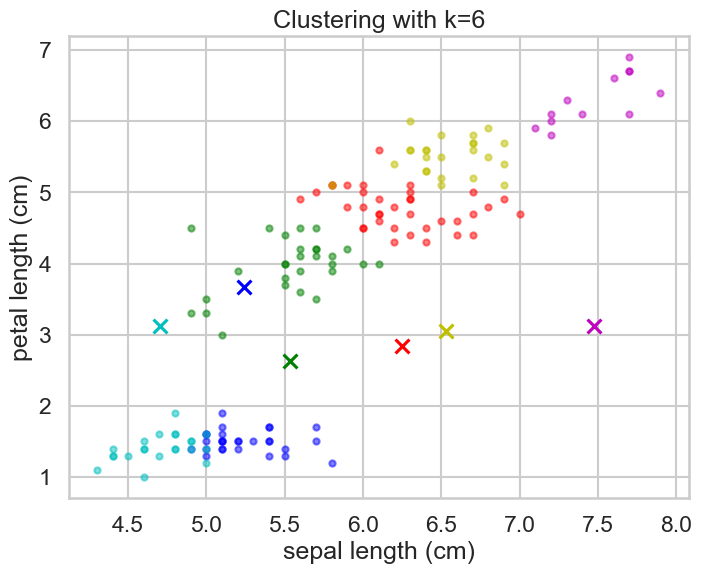

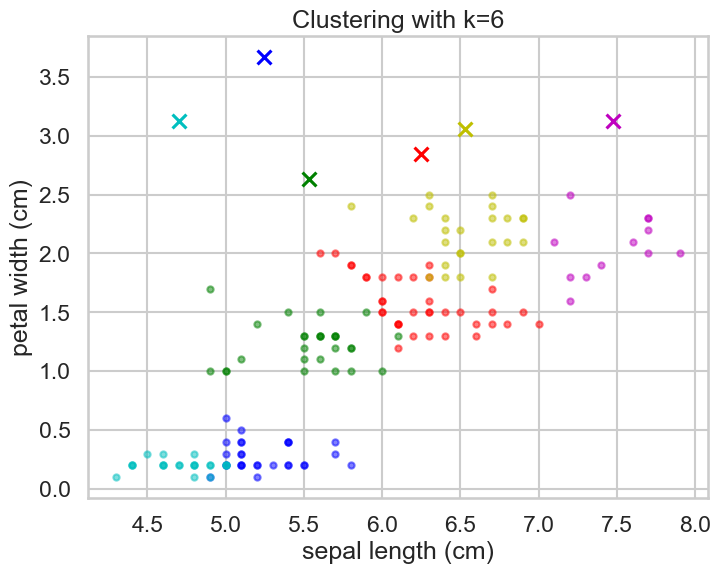

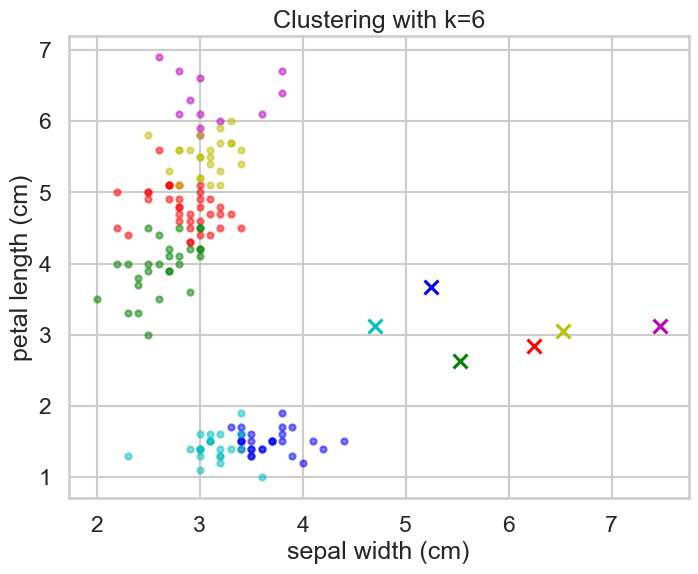

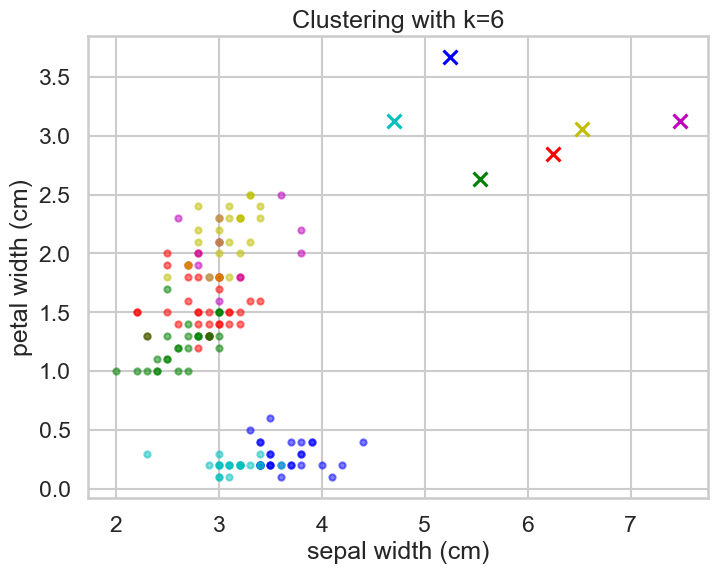

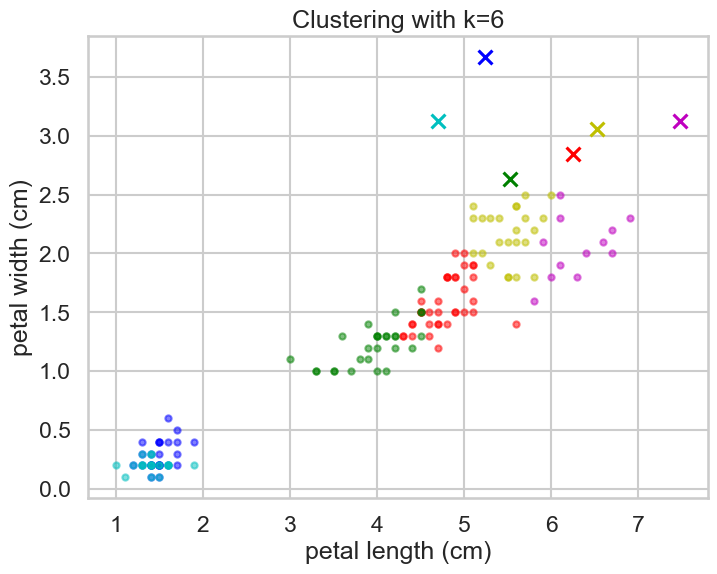

------------------------------------------------------------------------------------------------------


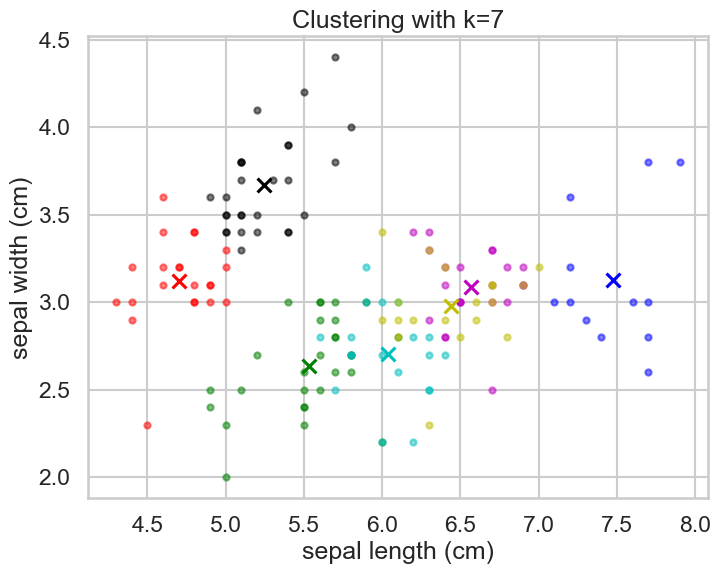

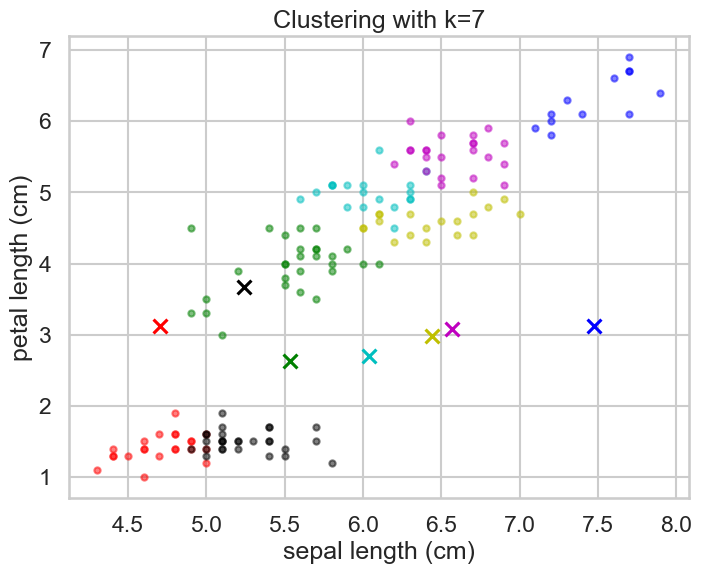

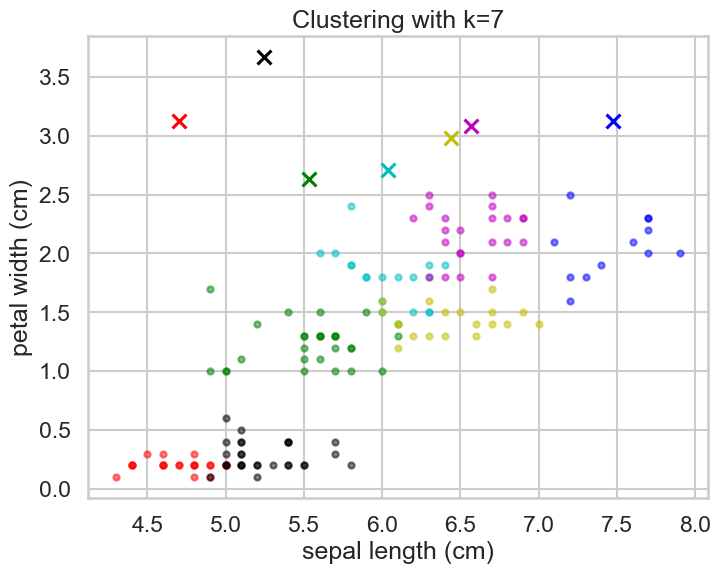

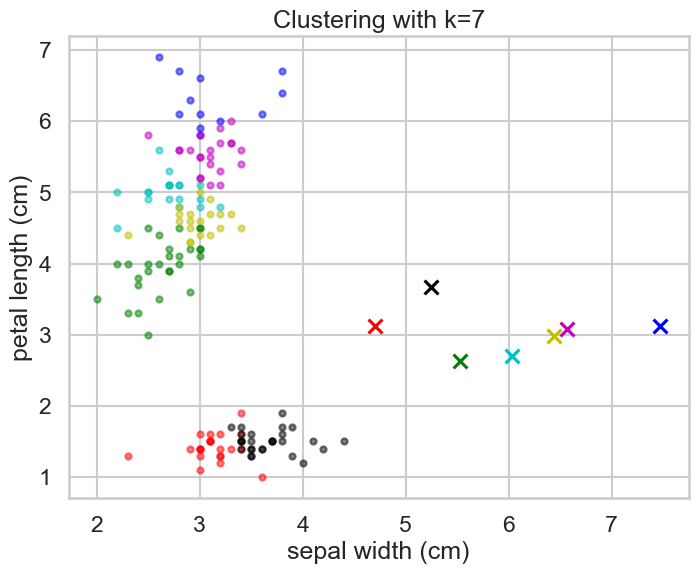

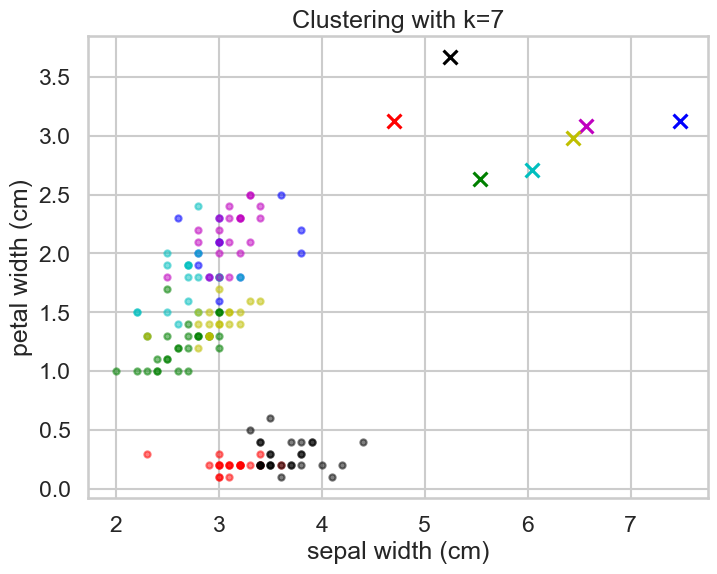

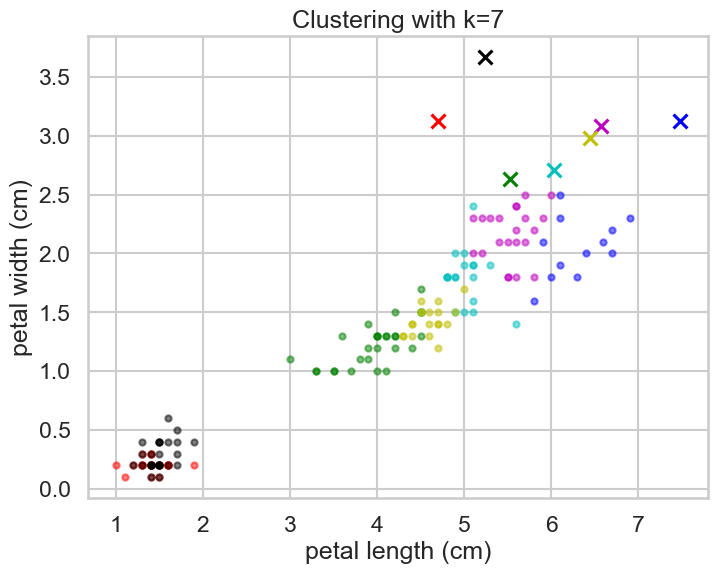

------------------------------------------------------------------------------------------------------


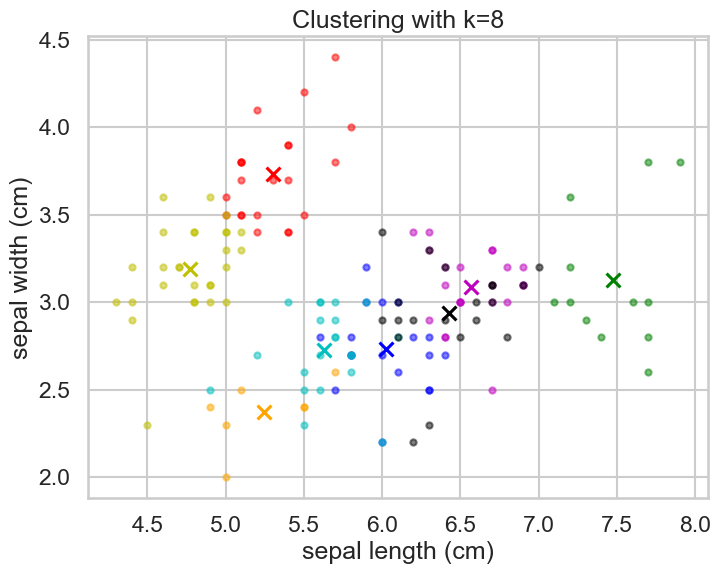

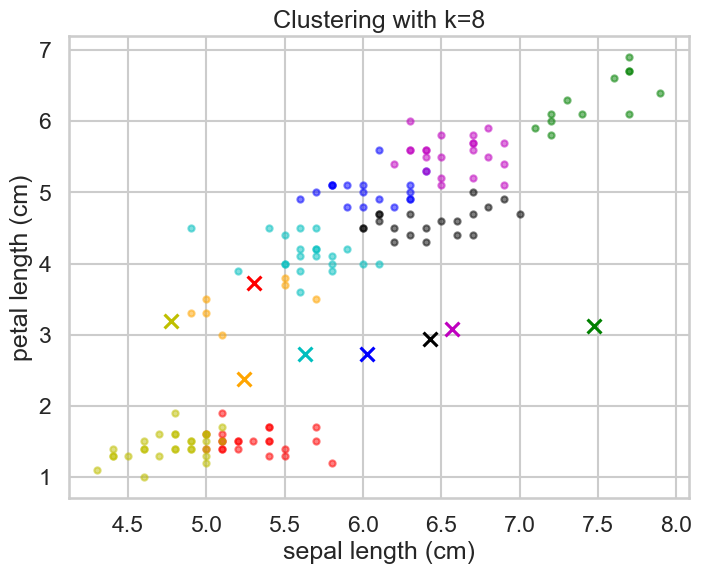

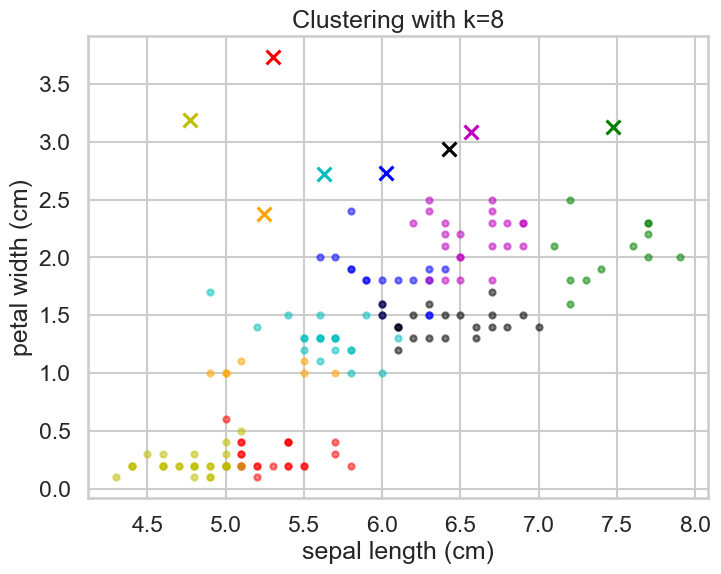

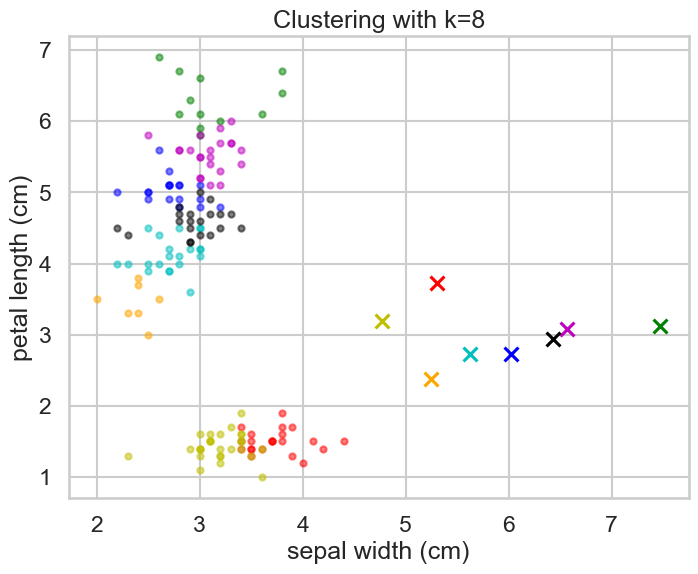

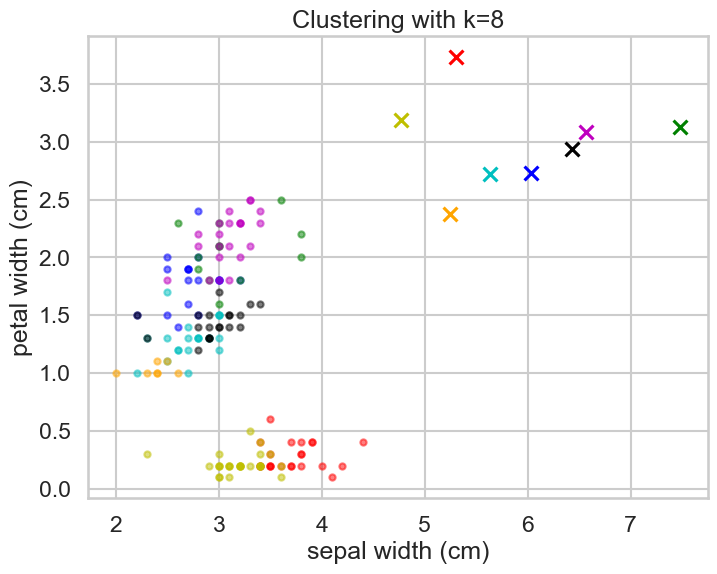

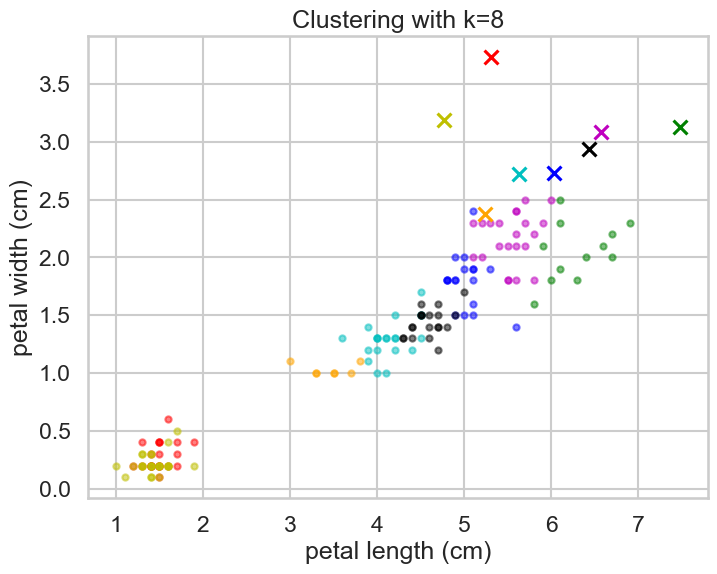

------------------------------------------------------------------------------------------------------


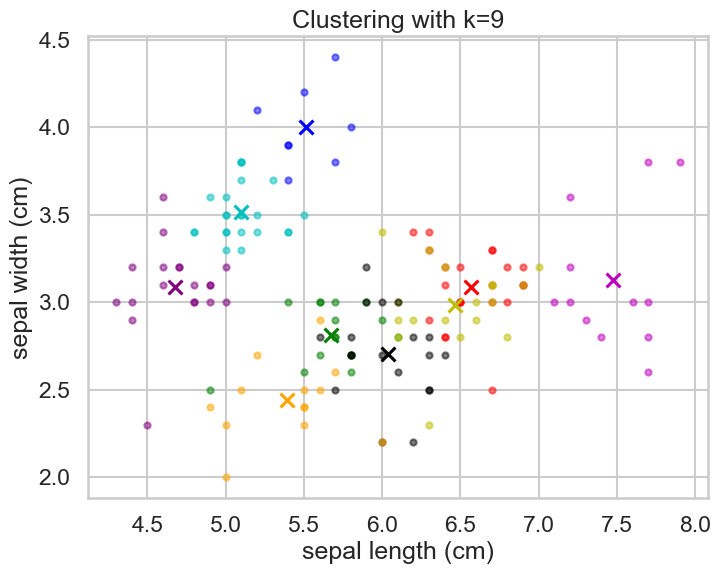

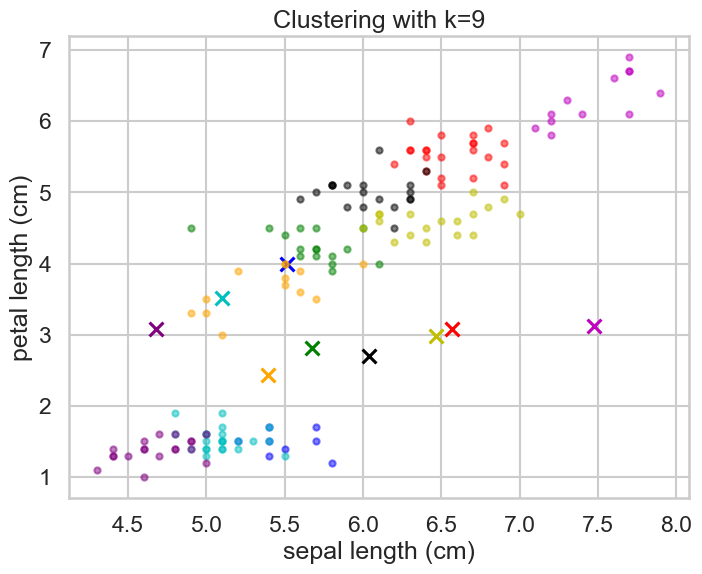

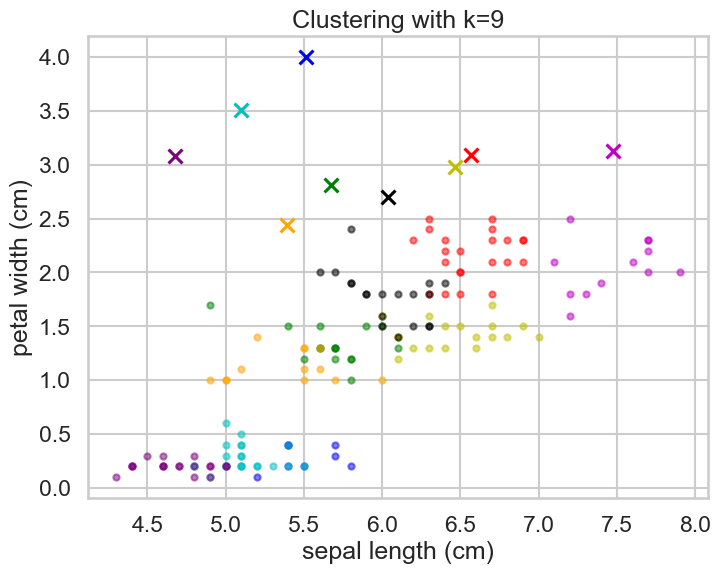

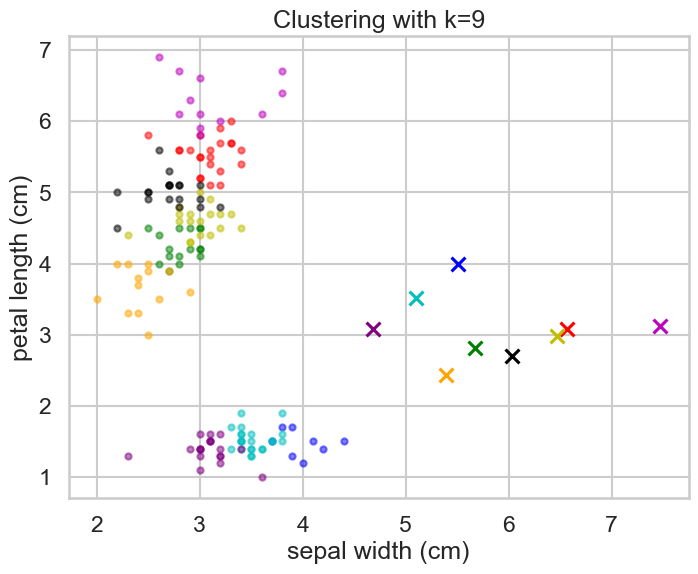

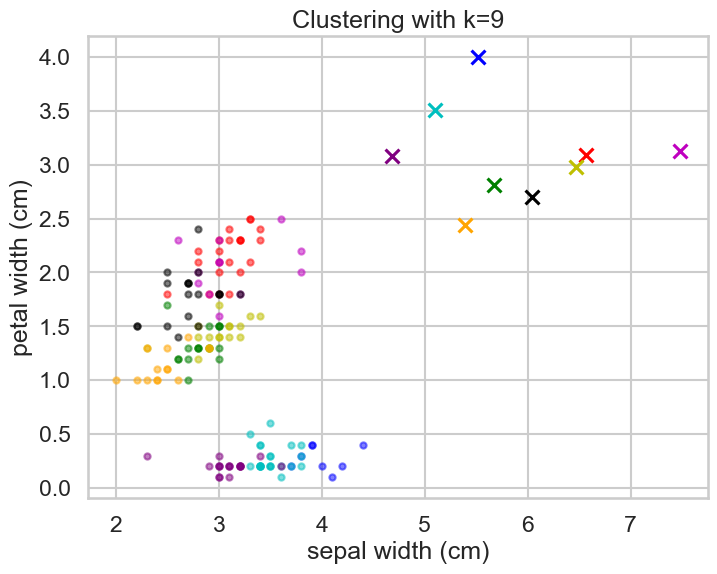

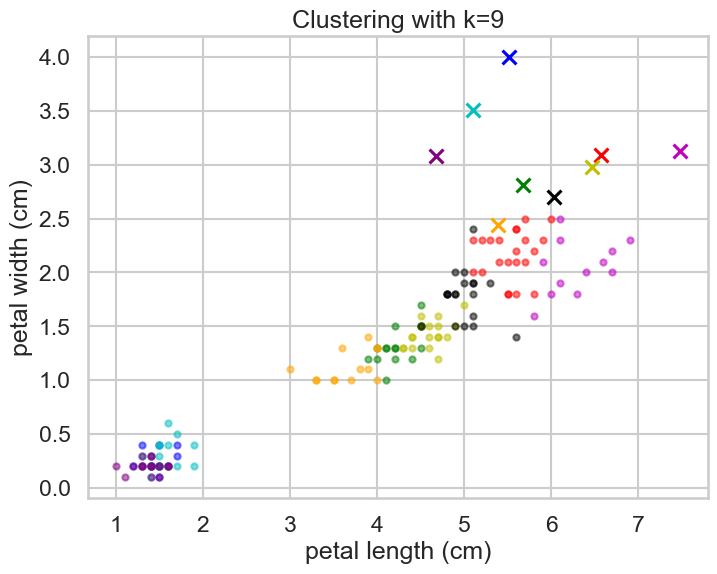

------------------------------------------------------------------------------------------------------


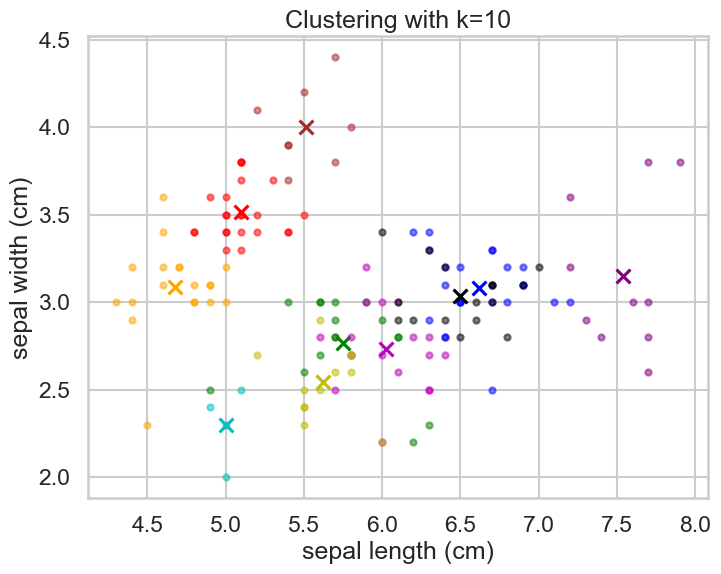

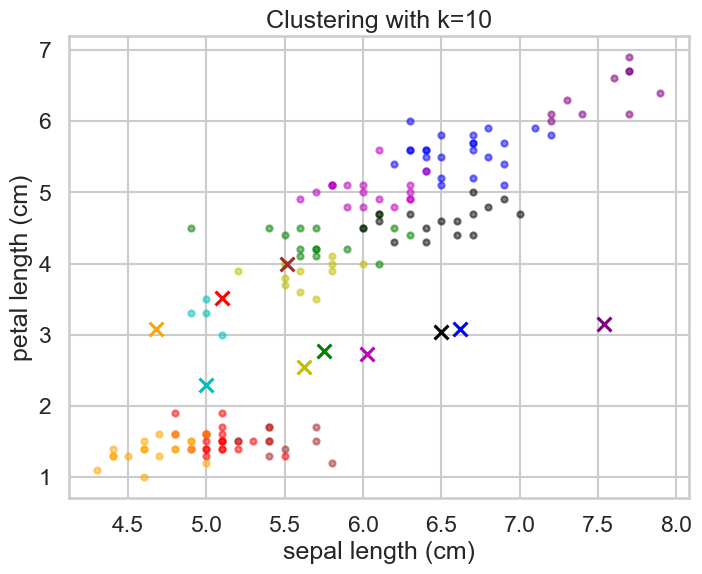

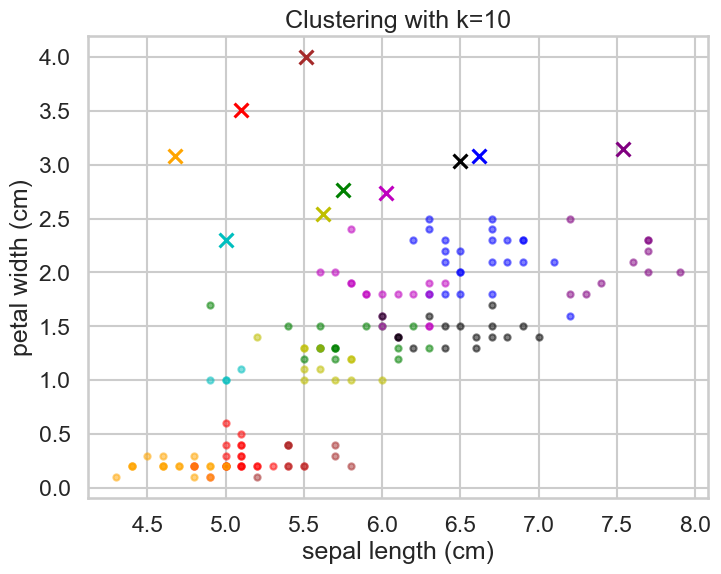

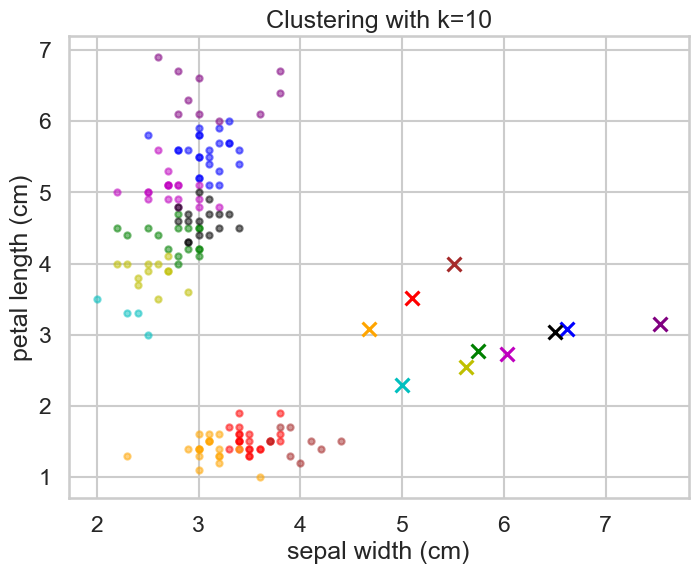

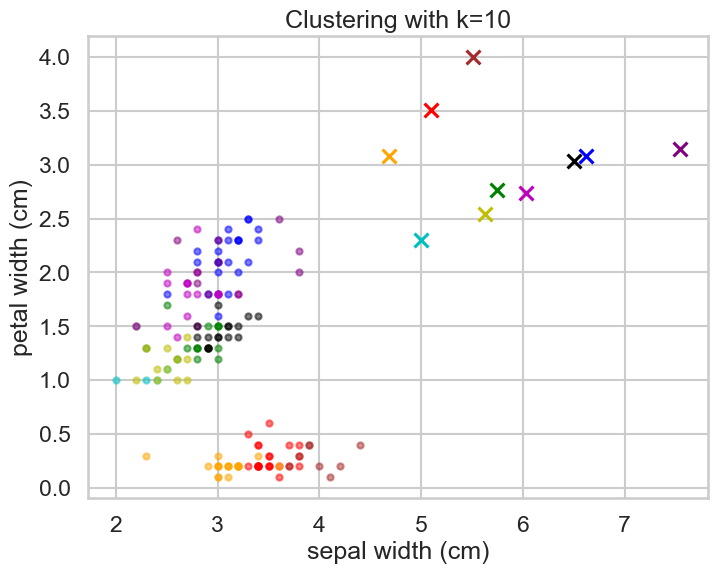

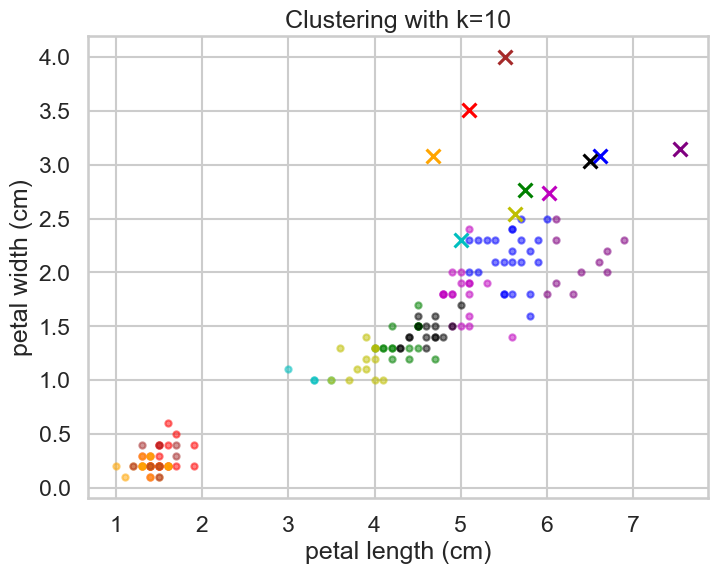

In [32]:
# Define pairs of features
feature_pairs = list(combinations(iris_df.columns, 2))

# Define range of k values, chosen to be 2-10 in order to decrease run time for larger datasets for more than 2 features
k_values = range(2, 11)
distortions = [] 

# Loop over each k value
for k in k_values:
    
    print("------------------------------------------------------------------------------------------------------")
    km = KMeans(n_clusters=k)
    km.fit(iris_df)    
    distortion = km.inertia_
    distortions.append(distortion)
    
    # Plot clusters for each pair of features
    for pair in feature_pairs:
        plt.figure(figsize=(8, 6))
        plt.title(f'Clustering with k={k}') 
        display_cluster(iris_df[list(pair)].values, km=km, num_clusters=k,feature1= pair[0] ,feature2=pair[1]) 
        plt.show()


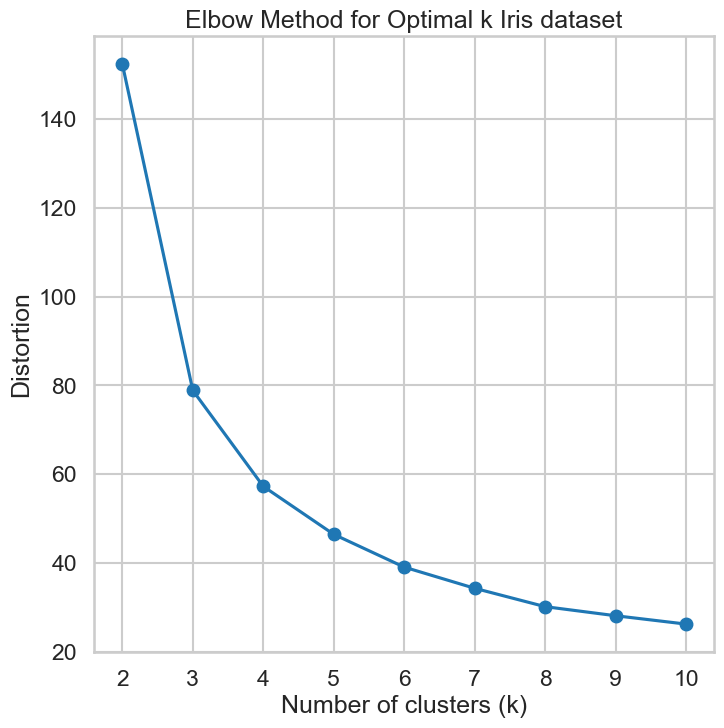

In [33]:
# Plot distortion  for Kmeans
plt.plot(k_values, distortions, marker='o')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Distortion')
plt.title('Elbow Method for Optimal k Iris dataset')
plt.show()

In [34]:
max(K_Means_silhouette_scores)

0.48609408962389006

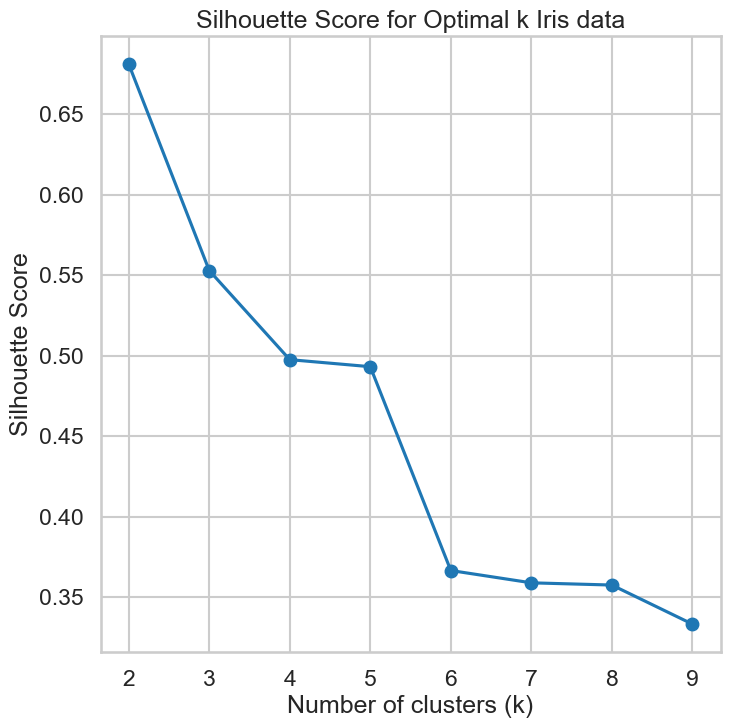

Best silhouette_score: 0.6810461692117462


In [35]:
k_values = range(2, 10)
K_Means_silhouette_scores = []

for k in k_values:
    km = KMeans(n_clusters=k)
    km.fit(iris_df)
    labels = km.labels_
    K_Means_silhouette_scores.append(silhouette_score(iris_df, labels))

# Plot silhouette scores for different k values
plt.plot(k_values, K_Means_silhouette_scores, marker='o')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score for Optimal k Iris data')
plt.show()

print(f"Best silhouette_score: {max(K_Means_silhouette_scores)}")

K = 2 is the optimal value

## Hierarchal Clustering iris dataset 

Affinity: euclidean, Linkage: average, Distance Threshold: 2
2
------------------------
Affinity: euclidean, Linkage: average, Distance Threshold: 2
Number of clusters: 2
Silhouette Score: 0.6867350732769777



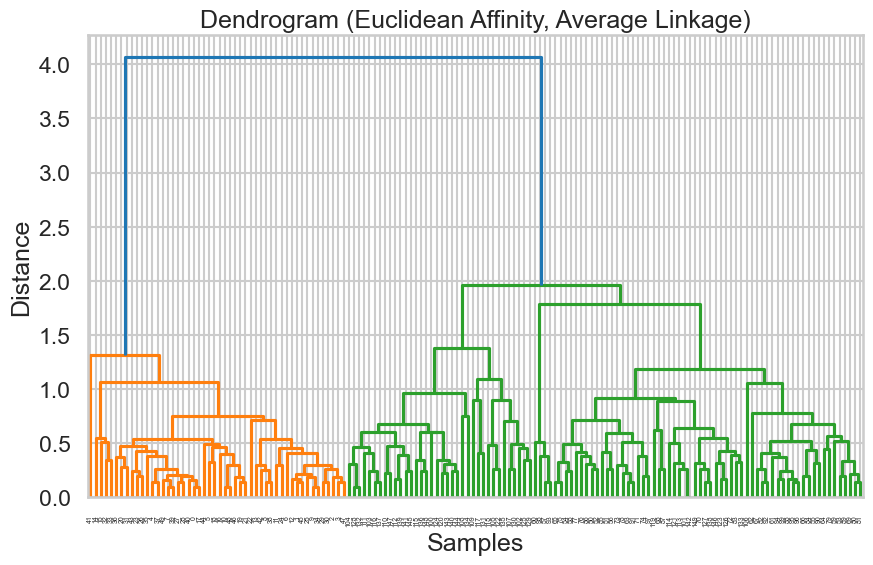

Affinity: euclidean, Linkage: average, Distance Threshold: 3
2
------------------------
Affinity: euclidean, Linkage: average, Distance Threshold: 3
Number of clusters: 2
Silhouette Score: 0.6867350732769777



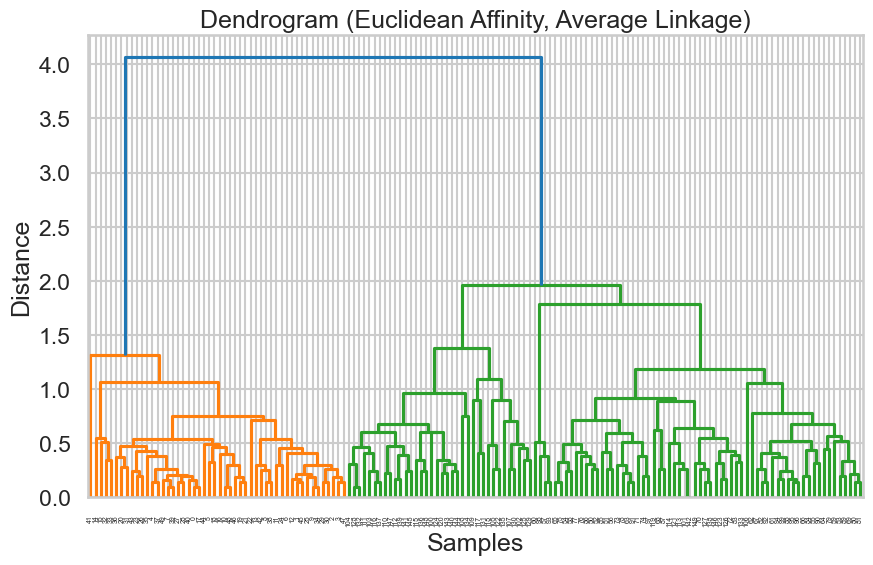

Affinity: euclidean, Linkage: average, Distance Threshold: 4
2
------------------------
Affinity: euclidean, Linkage: average, Distance Threshold: 4
Number of clusters: 2
Silhouette Score: 0.6867350732769777



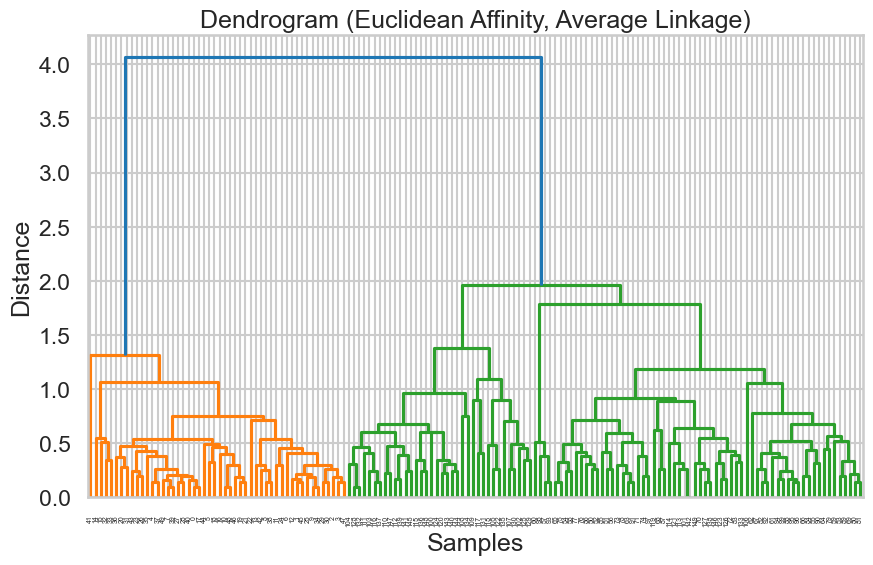

Affinity: euclidean, Linkage: single, Distance Threshold: 2
1
------------------------
Affinity: euclidean, Linkage: single, Distance Threshold: 3
1
------------------------
Affinity: euclidean, Linkage: single, Distance Threshold: 4
1
------------------------
Affinity: cosine, Linkage: average, Distance Threshold: 2
1
------------------------
Affinity: cosine, Linkage: average, Distance Threshold: 3
1
------------------------
Affinity: cosine, Linkage: average, Distance Threshold: 4
1
------------------------
Affinity: cosine, Linkage: single, Distance Threshold: 2
1
------------------------
Affinity: cosine, Linkage: single, Distance Threshold: 3
1
------------------------
Affinity: cosine, Linkage: single, Distance Threshold: 4
1
------------------------


In [36]:
# Define the range of parameters
affinities = ['euclidean', 'cosine']
linkages = ['average', 'single']
distance_thresholds = range(2, 5)

best_silhouette_score = -1
best_parameters = {}

# Iterate over different parameter combinations
for affinity in affinities:
    for linkage_method in linkages:
        for distance_threshold in distance_thresholds:
            agg_clustering = AgglomerativeClustering(n_clusters=None, affinity=affinity, linkage=linkage_method, distance_threshold=distance_threshold)
            # Fit the model to the data
            agg_clustering.fit(iris_df)
            
            no_of_unique_clusters = len(np.unique(agg_clustering.labels_))
            
            print(f"Affinity: {affinity}, Linkage: {linkage_method}, Distance Threshold: {distance_threshold}")
            print(no_of_unique_clusters)
            
            print("------------------------")
            
            if no_of_unique_clusters > 1:
                # Compute silhouette score
                silhouette_avg = silhouette_score(iris_df, agg_clustering.labels_)
                # Check if the current silhouette score is the best so far
                if silhouette_avg > best_silhouette_score:
                    best_silhouette_score = silhouette_avg
                    best_parameters = {'Affinity': affinity, 'Linkage': linkage_method, 'Distance Threshold': distance_threshold}

                # Display the resulting clusters
                print(f"Affinity: {affinity}, Linkage: {linkage_method}, Distance Threshold: {distance_threshold}")
                print(f"Number of clusters: {agg_clustering.n_clusters_}")
                print(f"Silhouette Score: {silhouette_avg}\n")
                
                
                # Plot dendrogram
                plt.figure(figsize=(10, 6))
                dendrogram(linkage(iris_df, method=linkage_method, metric=affinity))
                plt.title(f'Dendrogram ({affinity.capitalize()} Affinity, {linkage_method.capitalize()} Linkage)')
                plt.xlabel('Samples')  # Fixing the x-axis label here
                plt.ylabel('Distance')
                plt.show()
                
                '''
                # Plot clusters for each pair of features
                for pair in feature_pairs:
                    plt.figure(figsize=(8, 6))
                    plt.title(f'Clustering with k={k}') 
                    
                    plt.scatter(iris_df[pair[0]],iris_df[pair[1]], c=agg_clustering.labels_, cmap='viridis')
                    plt.title(f'Clusters for Affinity: {affinity}, Linkage: {linkage_method}, Distance Threshold: {distance_threshold}')
                    plt.xlabel(pair[0])  # Fixing the x-axis label here
                    plt.ylabel(pair[1])
                    plt.colorbar(label='Cluster')
                    plt.show()
                '''
                
            else:
                continue
                

### Hierarchal Clustering Best Parameters iris dataset

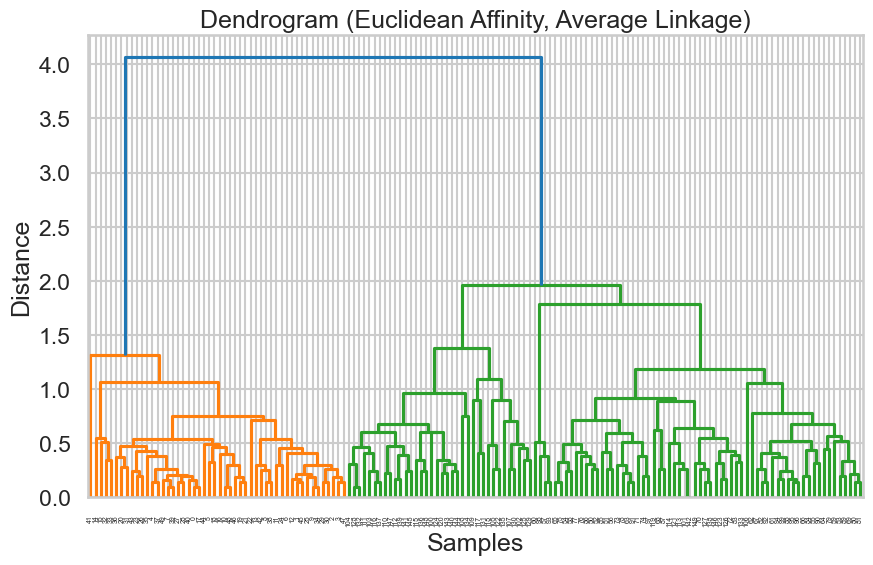

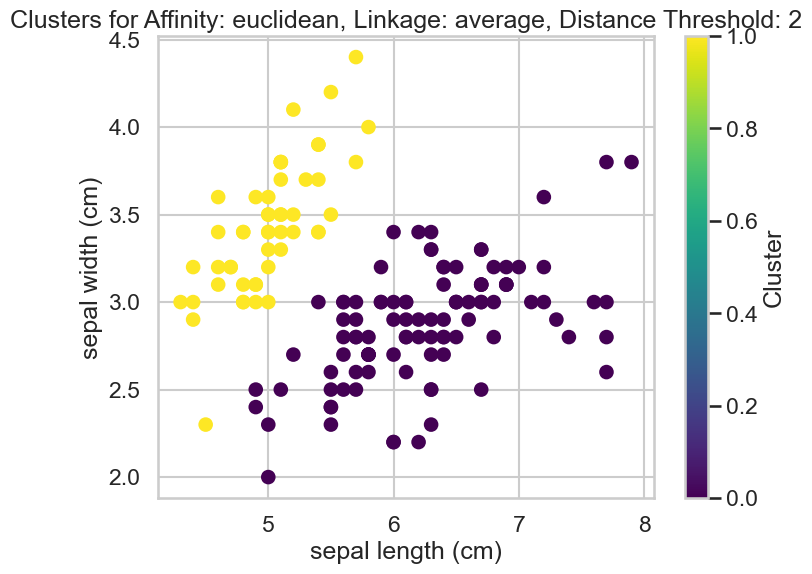

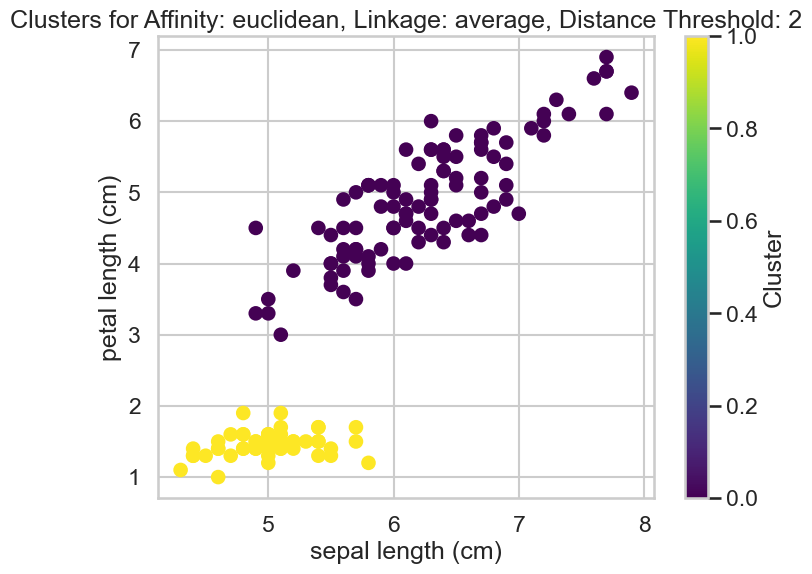

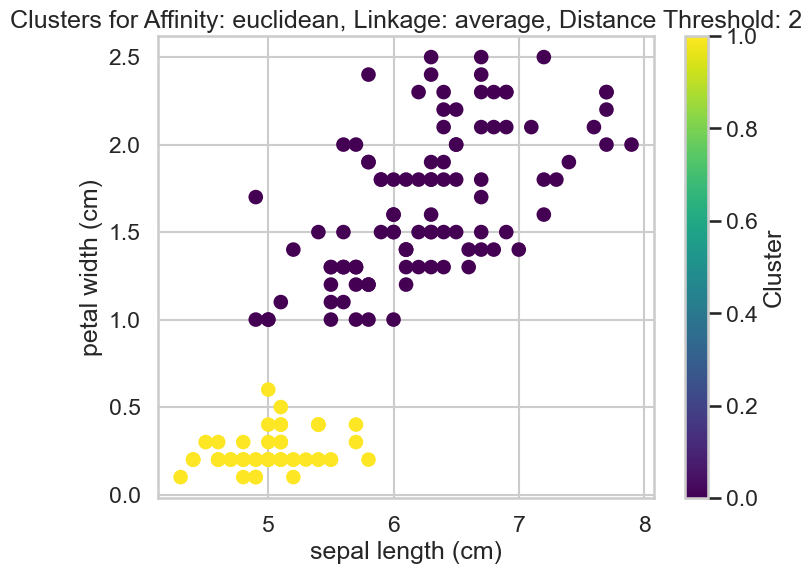

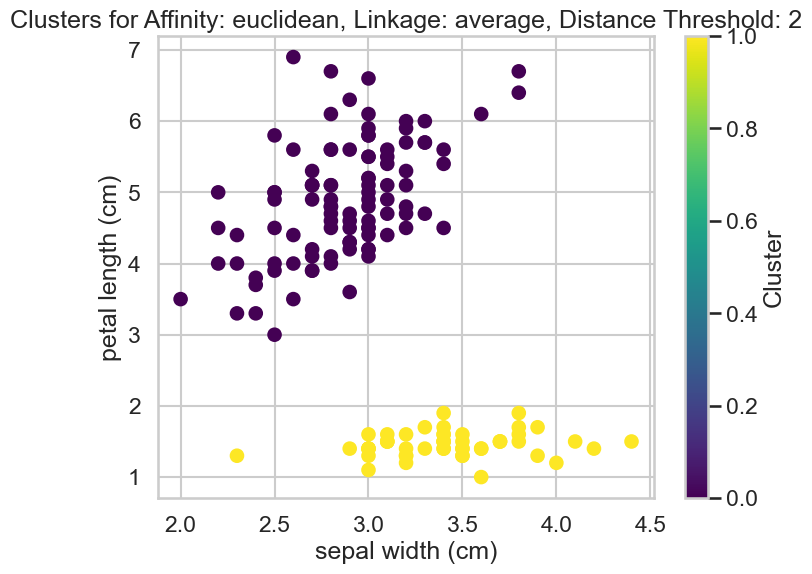

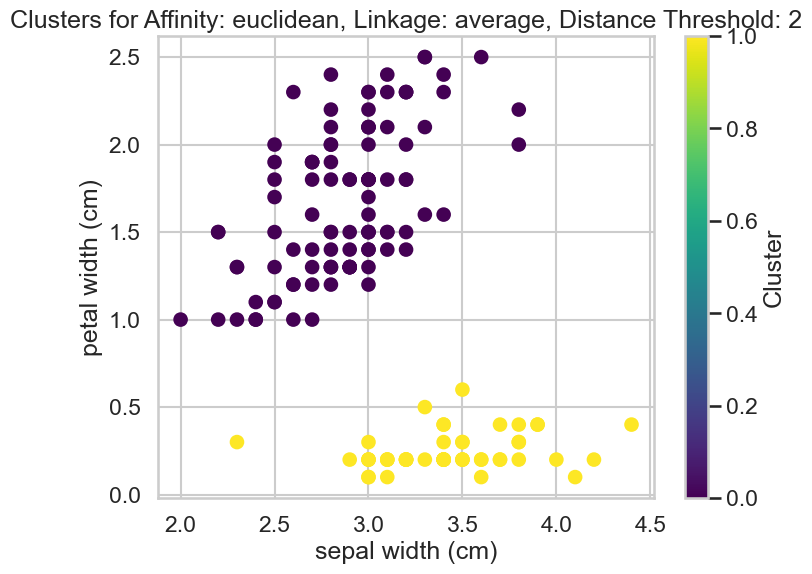

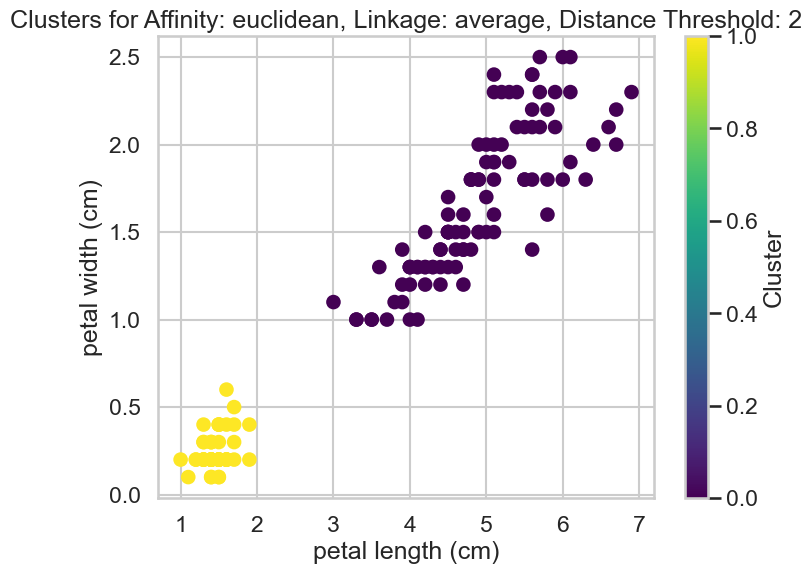

Best No.of clusters: 2
Best Parameters:
{'Affinity': 'euclidean', 'Linkage': 'average', 'Distance Threshold': 2}
Best silhouette score: 0.6867350732769777


In [37]:
plt.figure(figsize=(10, 6))
dendrogram(linkage(iris_df, method=best_parameters['Linkage'], metric=best_parameters['Affinity']))
plt.title(f'Dendrogram ({best_parameters["Affinity"].capitalize()} Affinity, {best_parameters["Linkage"].capitalize()} Linkage)')
plt.xlabel('Samples')
plt.ylabel('Distance')
plt.show()


agg_clustering = AgglomerativeClustering(n_clusters=None, affinity=best_parameters['Affinity'], linkage=best_parameters['Linkage'], distance_threshold=best_parameters['Distance Threshold'])
# Fit the model to the data
agg_clustering.fit(iris_df)


# Plot clusters for each pair of features
for pair in feature_pairs:
    plt.figure(figsize=(8, 6))
    plt.title(f'Clustering with k={k}') 

    plt.scatter(iris_df[pair[0]],iris_df[pair[1]], c=agg_clustering.labels_, cmap='viridis')
    plt.title(f'Clusters for Affinity: {best_parameters["Affinity"]}, Linkage: {best_parameters["Linkage"]}, Distance Threshold: {best_parameters["Distance Threshold"]}')
    plt.xlabel(pair[0])  # Fixing the x-axis label here
    plt.ylabel(pair[1])
    plt.colorbar(label='Cluster')
    plt.show()

print(f"Best No.of clusters: {len(np.unique(agg_clustering.labels_))}")
print("Best Parameters:")
print(best_parameters)

print(f"Best silhouette score: {best_silhouette_score}")


## DBscan iris 

In [38]:
# Define the range of parameters
EPS_range = np.linspace(0.1, 3, 10)
Min_samples_range = range(5, 16)

best_silhouette_score = -1
best_parameters = {}

# Iterate over different parameter combinations
for EPS in EPS_range:
    for Min_samples in Min_samples_range:
        dbscan = DBSCAN(eps=EPS, min_samples=Min_samples)
        # Fit the model to the data
        dbscan.fit(iris_df)
        no_of_unique_clusters = len(np.unique(dbscan.labels_))
            
        if no_of_unique_clusters > 1:
        
            # Compute silhouette score
            silhouette_avg = silhouette_score(iris_df, dbscan.labels_)
            '''
           # Plot clusters for each pair of features
            for pair in feature_pairs:
                plt.figure(figsize=(8, 6)) 
                plt.title(f'Clusters for EPS: {EPS}, Min_samples: {Min_samples}')
                plt.scatter(iris_df[pair[0]],iris_df[pair[1]], c=dbscan.labels_, cmap='viridis')
                plt.xlabel(pair[0])  # Fixing the x-axis label here
                plt.ylabel(pair[1])
                plt.colorbar(label='Cluster')
                plt.show()
            '''

            # Print silhouette score and parameters
            print(f"EPS: {EPS}, Min_samples: {Min_samples}")
            print(f"Number of clusters: {len(np.unique(dbscan.labels_))}")  # Exclude noise label
            print(f"Silhouette Score: {silhouette_avg}\n")

            # Check if the current silhouette score is the best so far
            if silhouette_avg > best_silhouette_score:
                best_silhouette_score = silhouette_avg
                best_parameters = {'EPS': EPS, 'Min_samples': Min_samples}
        else:
            continue


EPS: 0.42222222222222217, Min_samples: 5
Number of clusters: 4
Silhouette Score: 0.35789153664694195

EPS: 0.42222222222222217, Min_samples: 6
Number of clusters: 5
Silhouette Score: 0.28100330114570354

EPS: 0.42222222222222217, Min_samples: 7
Number of clusters: 8
Silhouette Score: 0.22485846560895395

EPS: 0.42222222222222217, Min_samples: 8
Number of clusters: 6
Silhouette Score: 0.18425548939583097

EPS: 0.42222222222222217, Min_samples: 9
Number of clusters: 4
Silhouette Score: 0.18337103823928563

EPS: 0.42222222222222217, Min_samples: 10
Number of clusters: 4
Silhouette Score: 0.13748588278565138

EPS: 0.42222222222222217, Min_samples: 11
Number of clusters: 3
Silhouette Score: 0.21821991130343743

EPS: 0.42222222222222217, Min_samples: 12
Number of clusters: 3
Silhouette Score: 0.21419038893488743

EPS: 0.42222222222222217, Min_samples: 13
Number of clusters: 2
Silhouette Score: 0.5998657220519231

EPS: 0.42222222222222217, Min_samples: 14
Number of clusters: 2
Silhouette Scor

#### Plot silhouette score versus variation in EPS and Min_samples

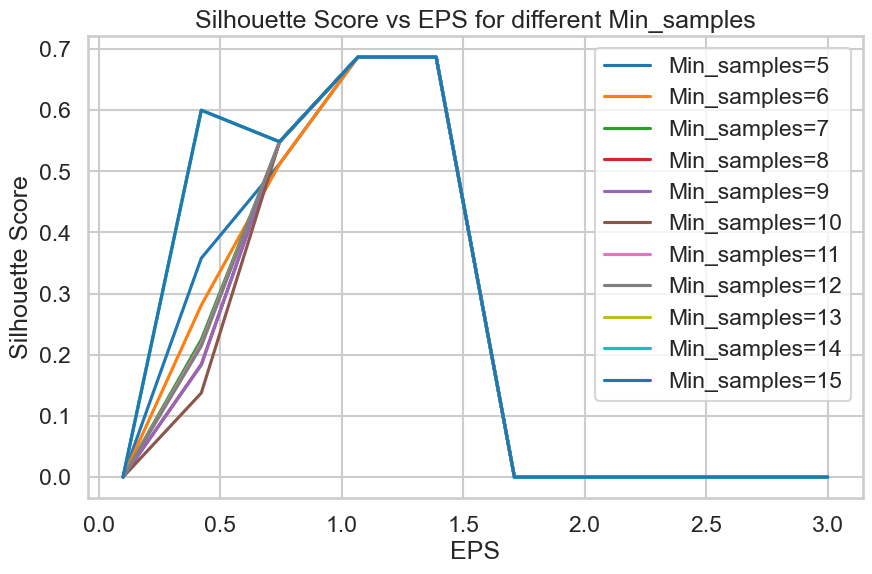

In [39]:
# Plot silhouette score versus variation in EPS and Min_samples
plt.figure(figsize=(10, 6))
for Min_samples in Min_samples_range:
    silhouette_scores = np.zeros_like(EPS_range)
    for i, EPS in enumerate(EPS_range):
        dbscan = DBSCAN(eps=EPS, min_samples=Min_samples)
        dbscan.fit(iris_df)
        no_of_unique_clusters = len(np.unique(dbscan.labels_))
            
        if no_of_unique_clusters > 1:
            silhouette_scores[i] = silhouette_score(iris_df, dbscan.labels_)
    plt.plot(EPS_range, silhouette_scores, label=f'Min_samples={Min_samples}')
plt.xlabel('EPS')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score vs EPS for different Min_samples')
plt.legend()
plt.show()


## DBScan Best Parameters 

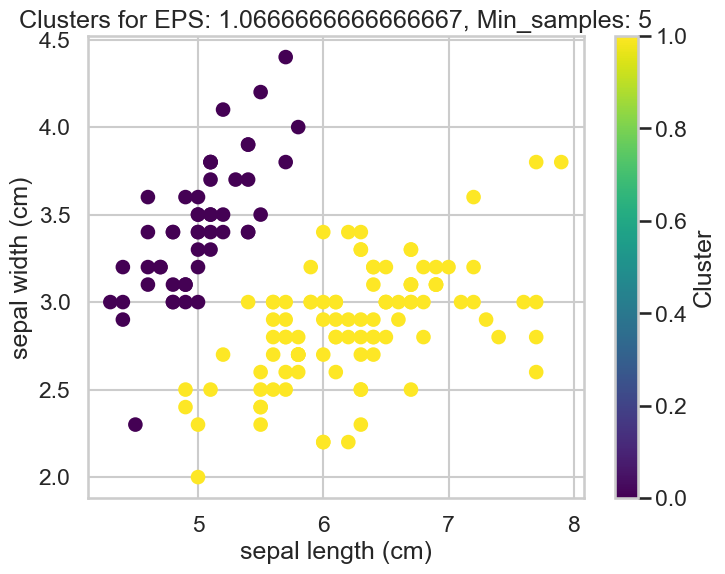

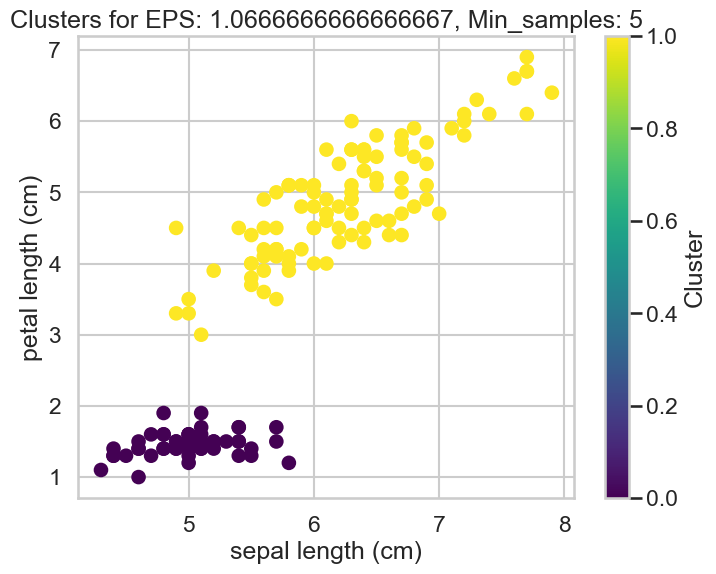

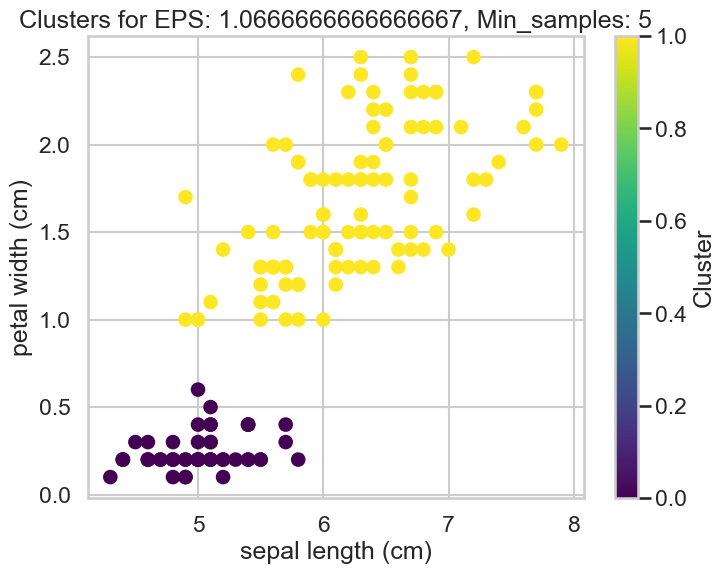

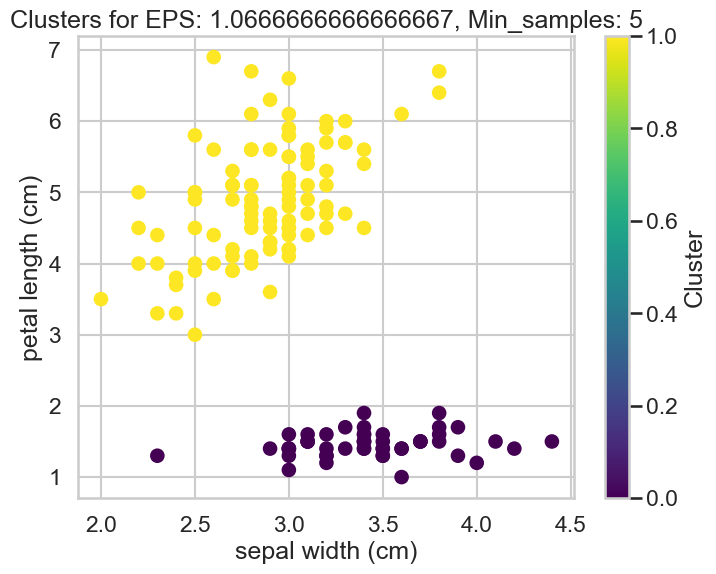

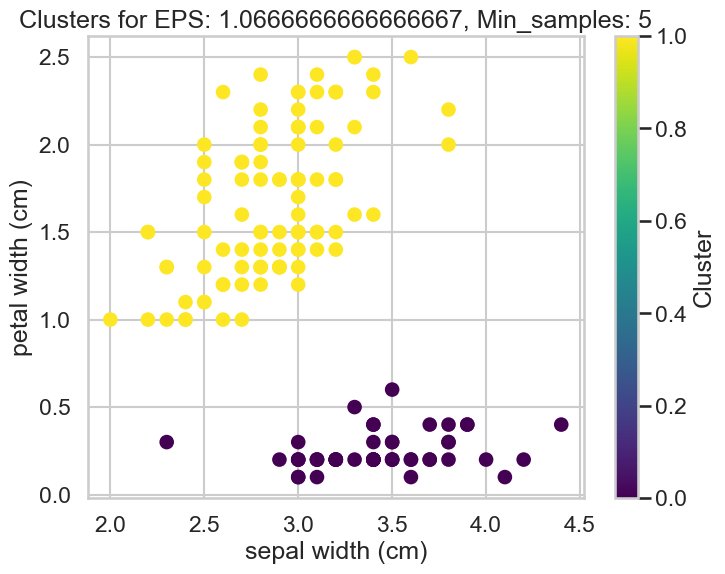

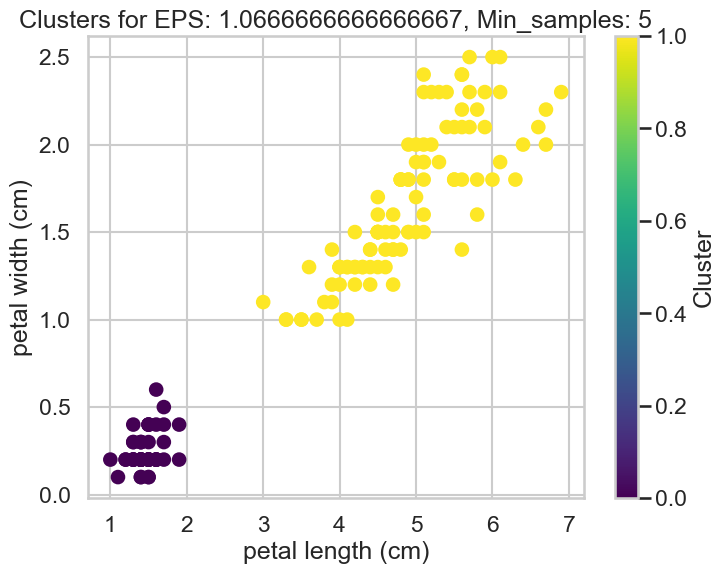

Best parameters:
{'EPS': 1.0666666666666667, 'Min_samples': 5}
Best Silhouette Score: 0.6867350732769776
Best No.of Clusters: 2


In [235]:
# Create a DBSCAN instance with the best parameters
best_dbscan = DBSCAN(eps=best_parameters['EPS'], min_samples=best_parameters['Min_samples'])

# Fit the model to the data
best_dbscan.fit(iris_df)


# Plot clusters for each pair of features
for pair in feature_pairs:
    plt.figure(figsize=(8, 6)) 
    plt.title(f'Clusters for EPS: {best_parameters["EPS"]}, Min_samples: {best_parameters["Min_samples"]}')
    plt.scatter(iris_df[pair[0]],iris_df[pair[1]], c=best_dbscan.labels_, cmap='viridis')
    plt.xlabel(pair[0])  # Fixing the x-axis label here
    plt.ylabel(pair[1])
    plt.colorbar(label='Cluster')
    plt.show()
    
# Print the best parameters
print("Best parameters:")
print(best_parameters)
print(f"Best Silhouette Score: {best_silhouette_score}")
print(f"Best No.of Clusters: {len(np.unique(best_dbscan.labels_))}")

## Gaussian iris dataset

In [40]:
# Define pairs of features
feature_pairs = list(combinations(iris_df.columns, 2))
k_values = range(2, 11)
GMM_silhouette_scores = []

best_silhouette_score = -1
best_k = None
best_covariance_type = None

for k in k_values:
    for covariance_type in covariance_types:
        # Create and fit the Gaussian Mixture Model
        gmm = GaussianMixture(n_components=k, covariance_type=covariance_type, random_state=42)
        gmm.fit(iris_df)

        # Calculate silhouette score
        labels = gmm.predict(iris_df)
        silhouette_avg = silhouette_score(iris_df, labels)
        GMM_silhouette_scores.append(silhouette_avg)

        # Check if the current silhouette score is better than the previous best score
        if silhouette_avg > best_silhouette_score:
            best_silhouette_score = silhouette_avg
            best_k = k
            best_covariance_type = covariance_type

# Print the best silhouette score, K, and covariance type
print("Best Silhouette Score:", best_silhouette_score)
print("Best K:", best_k)
print("Best Covariance Type:", best_covariance_type)


Best Silhouette Score: 0.6867350732769777
Best K: 2
Best Covariance Type: full


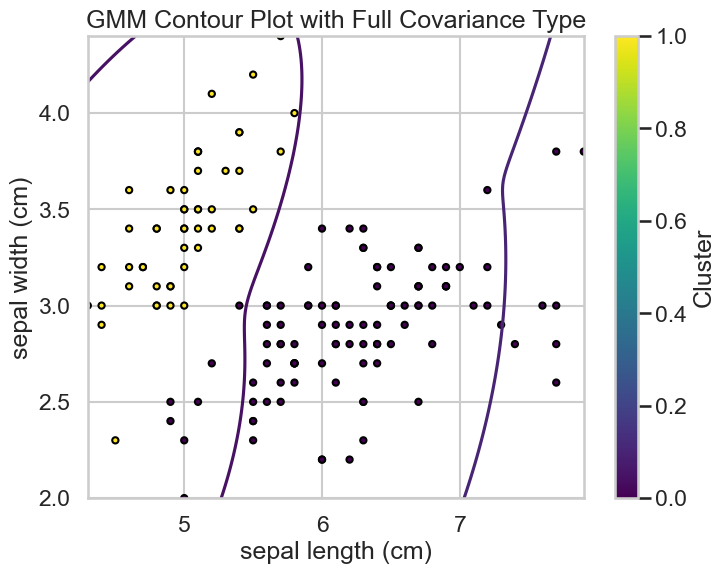

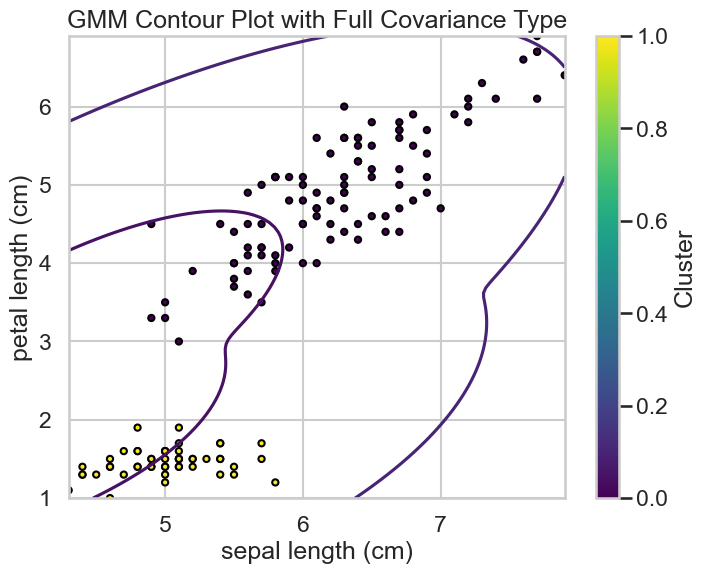

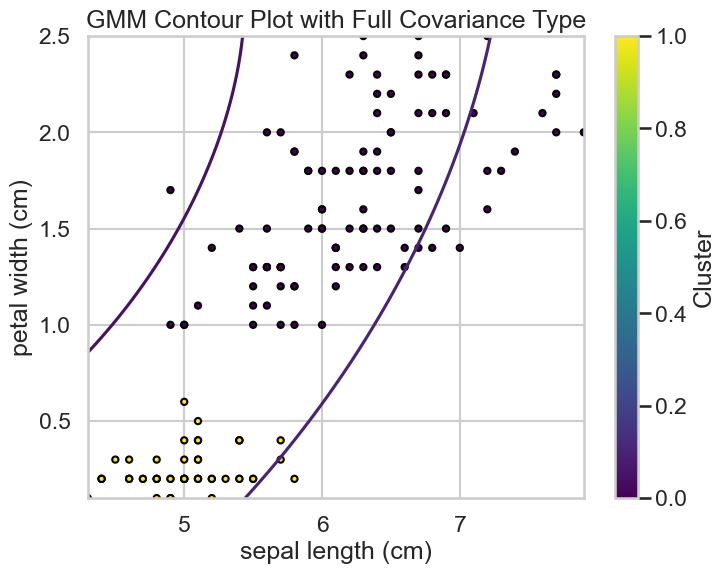

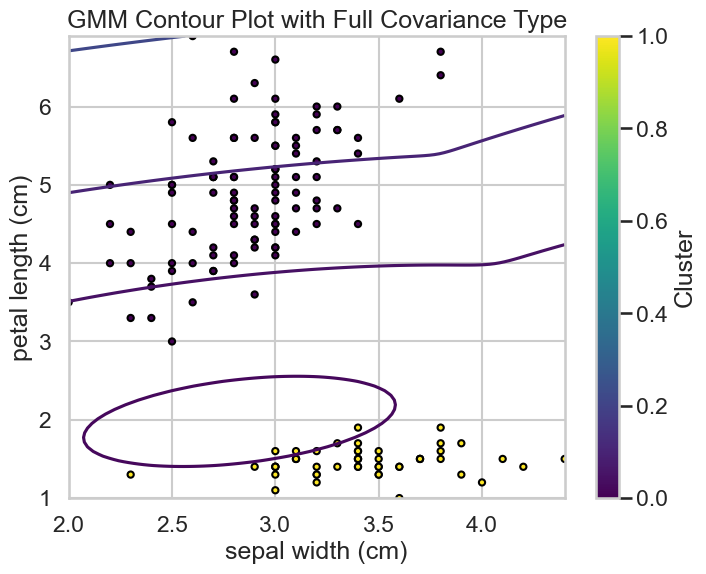

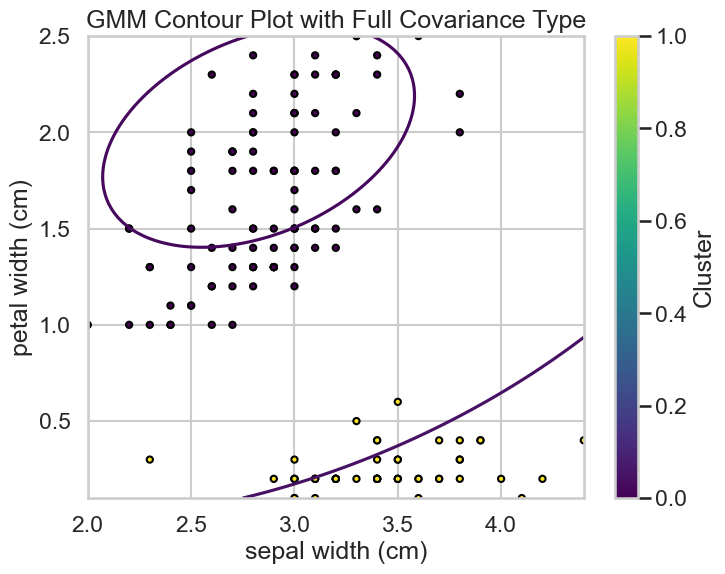

...

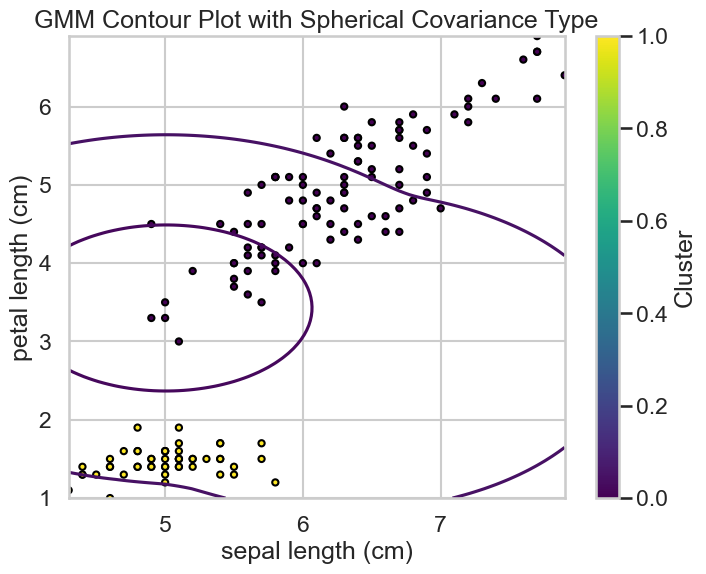

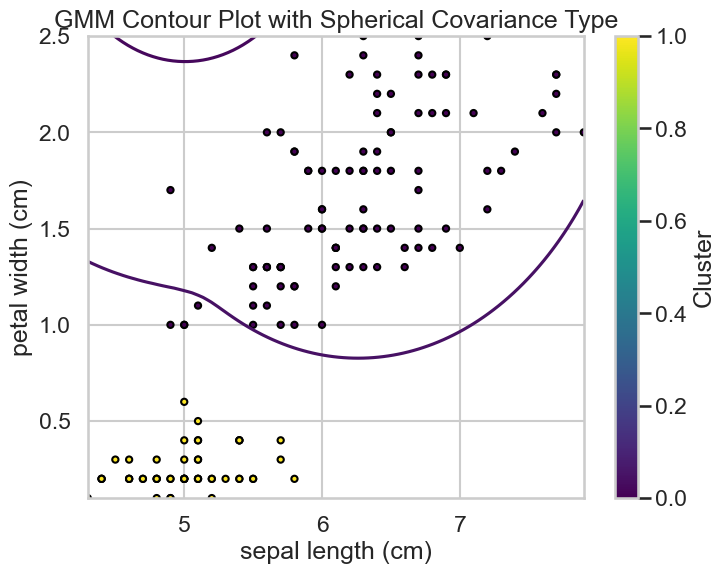

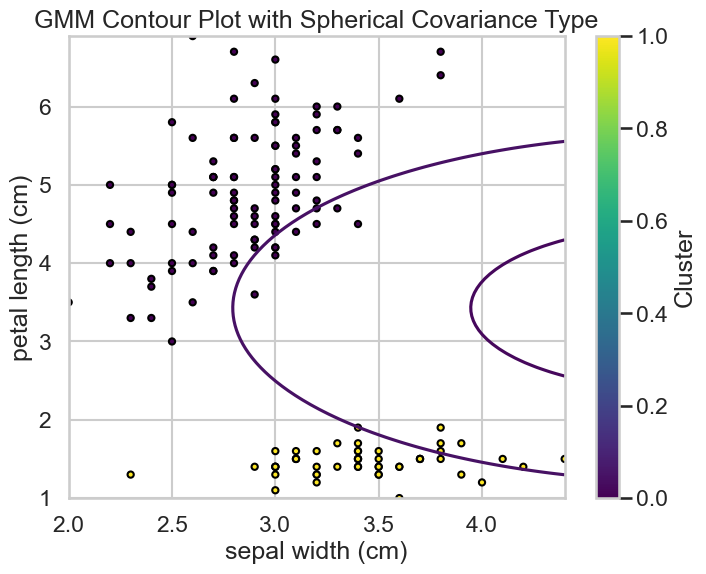

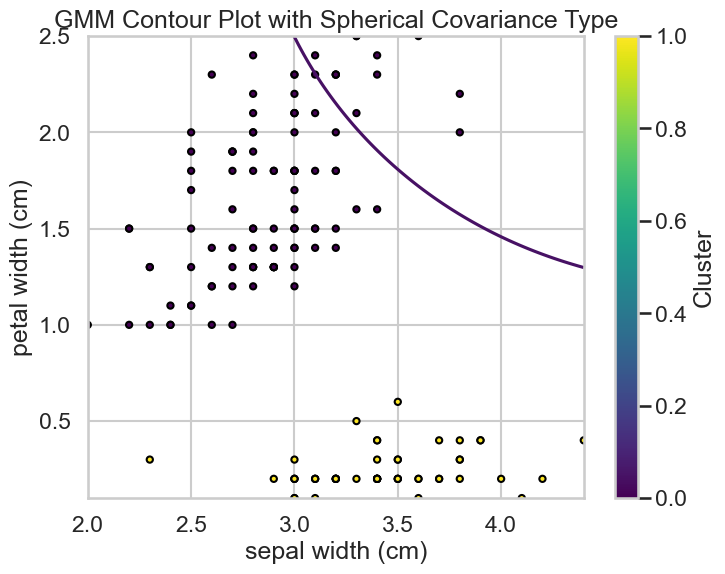

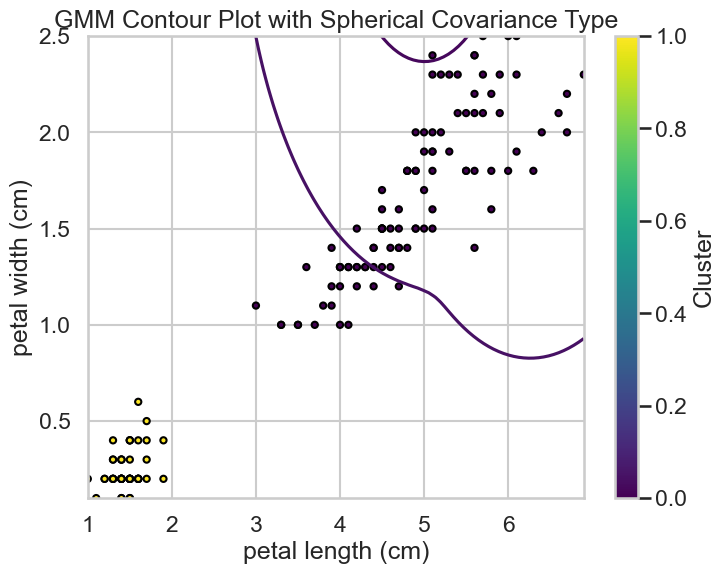

In [41]:
# Define pairs of features
feature_pairs = list(combinations(iris_df.columns, 2))

for covariance_type in covariance_types:
    # Create and fit the Gaussian Mixture Model
    gmm = GaussianMixture(n_components=2, covariance_type=covariance_type, random_state=42)
    gmm.fit(iris_df)
    
    for pair in feature_pairs:
        for pair in feature_pairs:
            # Create a meshgrid for plotting the contour plot
            x = np.linspace(iris_df[pair[0]].min(), iris_df[pair[0]].max(), 100)
            y = np.linspace(iris_df[pair[1]].min(), iris_df[pair[1]].max(), 100)
            X, Y = np.meshgrid(x, y)
            XX = np.array([X.ravel(), Y.ravel()]).T

            # Get the probabilities for each point in the meshgrid
            Z = -gmm.score_samples(np.hstack([XX, np.zeros((len(XX), 2))]))
            Z = Z.reshape(X.shape)

            # Plot the contour plot
            plt.figure(figsize=(8, 6))
            plt.contour(X, Y, Z, levels=np.logspace(0, 3, 10), cmap='viridis')
            plt.scatter(iris_df[pair[0]], iris_df[pair[1]], c=gmm.predict(iris_df), cmap='viridis', s=20, edgecolor='k')
            plt.title(f'GMM Contour Plot with {covariance_type.capitalize()} Covariance Type')
            plt.xlabel(pair[0])
            plt.ylabel(pair[1])
            plt.colorbar(label='Cluster')
            plt.show()

## Normalizing Iris

In [42]:
# Normalize the data using standard scaler because it is asked for normalization
scaler = StandardScaler()
iris_df_normalized = scaler.fit_transform(iris_df)
iris_df_normalized = pd.DataFrame(data=iris_df_normalized, columns=iris_df.columns)

## K-Means Normalized Iris dataste

In [44]:
# Define pairs of features
feature_pairs = list(combinations(iris_df_normalized.columns, 2))

# Define range of k values
k_values = range(2, 11)
distortions = [] 

# Loop over each k value
for k in k_values:
    km = KMeans(n_clusters=k)
    km.fit(iris_df_normalized)    
    distortion = km.inertia_
    distortions.append(distortion)
    
    # Plot clusters for each pair of features
    '''
    for pair in feature_pairs:
        plt.figure(figsize=(8, 6))
        plt.title(f'Clustering with k={k}') 
        display_cluster(iris_df_normalized[list(pair)].values, km=km, num_clusters=k,feature1= pair[0] ,feature2=pair[1]) 
        plt.show()
    '''

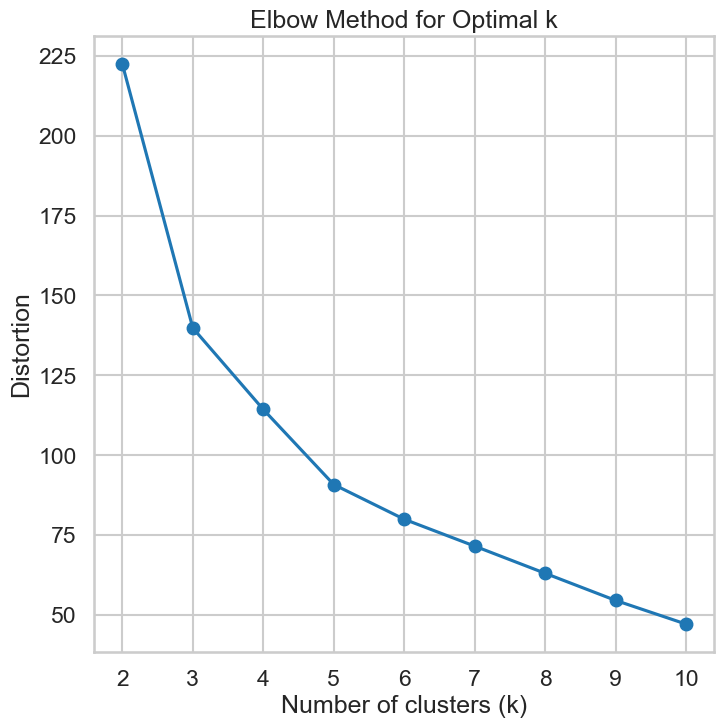

In [45]:
# Plot distortion values for k means for normalized iris dataset

plt.plot(k_values, distortions, marker='o')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Distortion')
plt.title('Elbow Method for Optimal k')
plt.show()

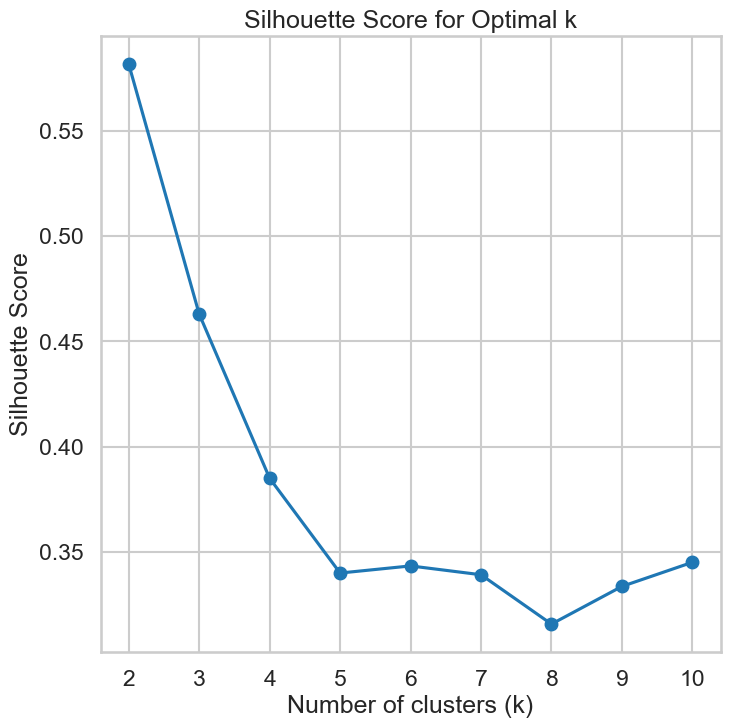

Best silhouette_score: 0.5817500491982808


In [46]:
k_values = range(2, 11)
K_Means_silhouette_scores = []

for k in k_values:
    km = KMeans(n_clusters=k)
    km.fit(iris_df_normalized)
    labels = km.labels_
    K_Means_silhouette_scores.append(silhouette_score(iris_df_normalized, labels))

# Plot silhouette scores for different k values
plt.plot(k_values, K_Means_silhouette_scores, marker='o')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score for Optimal k')
plt.show()
print(f"Best silhouette_score: {max(K_Means_silhouette_scores)}")

## Hierarchical Clustering Normalized iris

Affinity: euclidean, Linkage: average, Distance Threshold: 2
6
------------------------
Affinity: euclidean, Linkage: average, Distance Threshold: 2
Number of clusters: 6
Silhouette Score: 0.3248248440740702



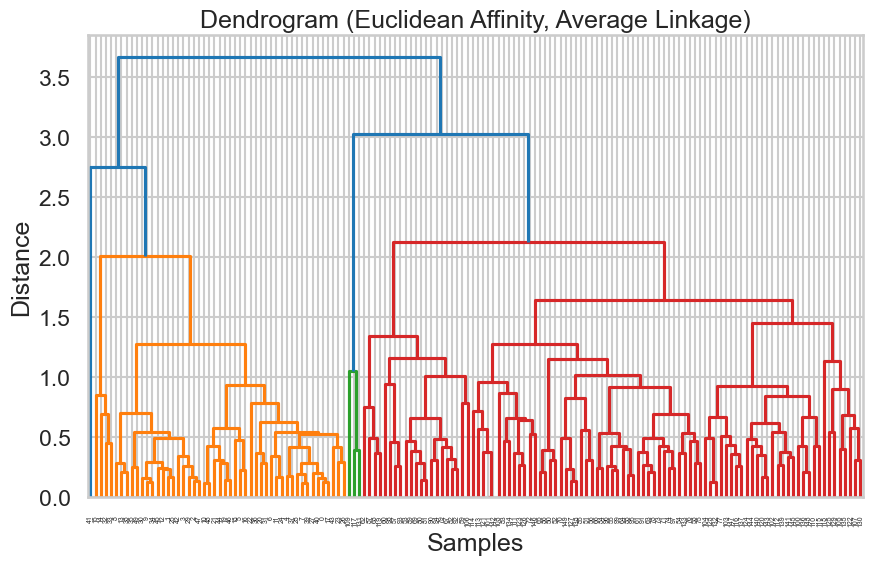

Affinity: euclidean, Linkage: average, Distance Threshold: 3
3
------------------------
Affinity: euclidean, Linkage: average, Distance Threshold: 3
Number of clusters: 3
Silhouette Score: 0.4802669329728697



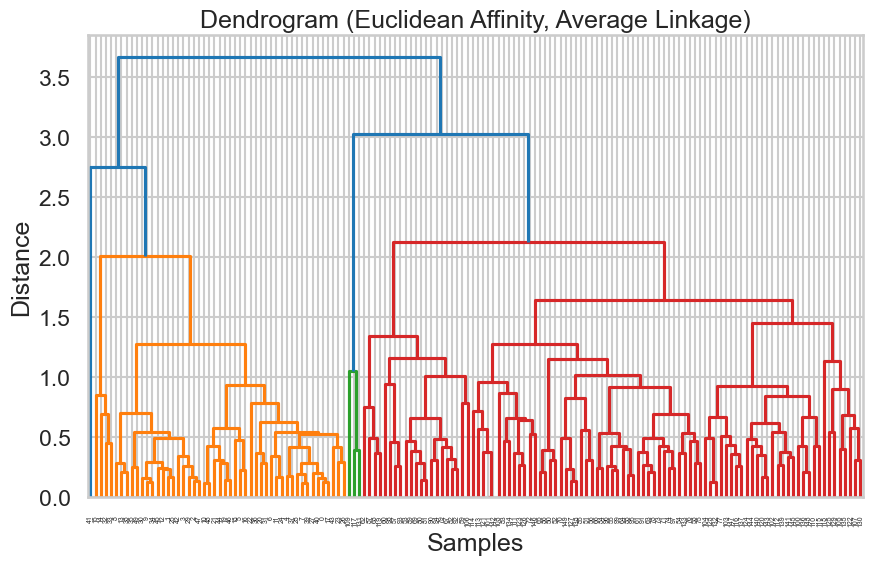

Affinity: euclidean, Linkage: average, Distance Threshold: 4
1
------------------------
Affinity: euclidean, Linkage: single, Distance Threshold: 2
1
------------------------
Affinity: euclidean, Linkage: single, Distance Threshold: 3
1
------------------------
Affinity: euclidean, Linkage: single, Distance Threshold: 4
1
------------------------
Affinity: cosine, Linkage: average, Distance Threshold: 2
1
------------------------
Affinity: cosine, Linkage: average, Distance Threshold: 3
1
------------------------
Affinity: cosine, Linkage: average, Distance Threshold: 4
1
------------------------
Affinity: cosine, Linkage: single, Distance Threshold: 2
1
------------------------
Affinity: cosine, Linkage: single, Distance Threshold: 3
1
------------------------
Affinity: cosine, Linkage: single, Distance Threshold: 4
1
------------------------


In [47]:
# Define the range of parameters
affinities = ['euclidean', 'cosine']
linkages = ['average', 'single']
distance_thresholds = range(2, 5)

best_silhouette_score = -1
best_parameters = {}

# Iterate over different parameter combinations
for affinity in affinities:
    for linkage_method in linkages:
        for distance_threshold in distance_thresholds:
            agg_clustering = AgglomerativeClustering(n_clusters=None, affinity=affinity, linkage=linkage_method, distance_threshold=distance_threshold)
            # Fit the model to the data
            agg_clustering.fit(iris_df_normalized)
            
            no_of_unique_clusters = len(np.unique(agg_clustering.labels_))
            
            print(f"Affinity: {affinity}, Linkage: {linkage_method}, Distance Threshold: {distance_threshold}")
            print(no_of_unique_clusters)
            
            print("------------------------")
            
            if no_of_unique_clusters > 1:
                # Compute silhouette score
                silhouette_avg = silhouette_score(iris_df_normalized, agg_clustering.labels_)
                # Check if the current silhouette score is the best so far
                if silhouette_avg > best_silhouette_score:
                    best_silhouette_score = silhouette_avg
                    best_parameters = {'Affinity': affinity, 'Linkage': linkage_method, 'Distance Threshold': distance_threshold}

                # Display the resulting clusters
                print(f"Affinity: {affinity}, Linkage: {linkage_method}, Distance Threshold: {distance_threshold}")
                print(f"Number of clusters: {agg_clustering.n_clusters_}")
                print(f"Silhouette Score: {silhouette_avg}\n")
                
                
                # Plot dendrogram
                plt.figure(figsize=(10, 6))
                dendrogram(linkage(iris_df_normalized, method=linkage_method, metric=affinity))
                plt.title(f'Dendrogram ({affinity.capitalize()} Affinity, {linkage_method.capitalize()} Linkage)')
                plt.xlabel('Samples')  # Fixing the x-axis label here
                plt.ylabel('Distance')
                plt.show()
                
                '''
                # Plot clusters for each pair of features
                for pair in feature_pairs:
                    plt.figure(figsize=(8, 6))
                    plt.title(f'Clustering with k={k}') 
                    
                    plt.scatter(iris_df_normalized[pair[0]],iris_df_normalized[pair[1]], c=agg_clustering.labels_, cmap='viridis')
                    plt.title(f'Clusters for Affinity: {affinity}, Linkage: {linkage_method}, Distance Threshold: {distance_threshold}')
                    plt.xlabel(pair[0])  # Fixing the x-axis label here
                    plt.ylabel(pair[1])
                    plt.colorbar(label='Cluster')
                    plt.show()                
               '''
                
            else:
                continue
                

## Hierarical Normalized iris Best Parameters

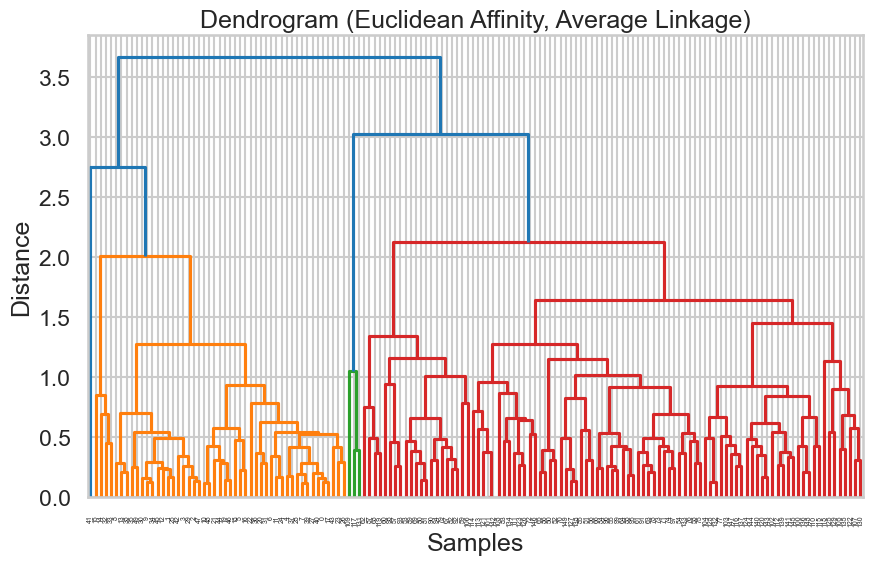

Best No.of clusters: 3
Best Parameters:
{'Affinity': 'euclidean', 'Linkage': 'average', 'Distance Threshold': 3}
Best silhouette score: 0.4802669329728697


In [48]:
plt.figure(figsize=(10, 6))
dendrogram(linkage(iris_df_normalized, method=best_parameters['Linkage'], metric=best_parameters['Affinity']))
plt.title(f'Dendrogram ({best_parameters["Affinity"].capitalize()} Affinity, {best_parameters["Linkage"].capitalize()} Linkage)')
plt.xlabel('Samples')
plt.ylabel('Distance')
plt.show()


agg_clustering = AgglomerativeClustering(n_clusters=None, affinity=best_parameters['Affinity'], linkage=best_parameters['Linkage'], distance_threshold=best_parameters['Distance Threshold'])
# Fit the model to the data
agg_clustering.fit(iris_df_normalized)


# Plot clusters for each pair of features
'''
for pair in feature_pairs:
    plt.figure(figsize=(8, 6))
    plt.title(f'Clustering with k={k}') 

    plt.scatter(iris_df_normalized[pair[0]],iris_df_normalized[pair[1]], c=agg_clustering.labels_, cmap='viridis')
    plt.title(f'Clusters for Affinity: {best_parameters["Affinity"]}, Linkage: {best_parameters["Linkage"]}, Distance Threshold: {best_parameters["Distance Threshold"]}')
    plt.xlabel(pair[0])  # Fixing the x-axis label here
    plt.ylabel(pair[1])
    plt.colorbar(label='Cluster')
    plt.show()
'''    
    
print(f"Best No.of clusters: {len(np.unique(agg_clustering.labels_))}")
print("Best Parameters:")
print(best_parameters)

print(f"Best silhouette score: {best_silhouette_score}")

## DBscan normalized iris 

In [49]:
best_silhouette_score = -1
best_parameters = {}

# Iterate over different parameter combinations
for EPS in EPS_range:
    for Min_samples in Min_samples_range:
        dbscan = DBSCAN(eps=EPS, min_samples=Min_samples)
        # Fit the model to the data
        dbscan.fit(iris_df_normalized)
        no_of_unique_clusters = len(np.unique(dbscan.labels_))
            
        if no_of_unique_clusters > 1:
        
            # Compute silhouette score
            silhouette_avg = silhouette_score(iris_df_normalized, dbscan.labels_)

           # Plot clusters for each pair of features
            '''
            for pair in feature_pairs:
                plt.figure(figsize=(8, 6)) 
                plt.title(f'Clusters for EPS: {EPS}, Min_samples: {Min_samples}')
                plt.scatter(iris_df_normalized[pair[0]],iris_df_normalized[pair[1]], c=dbscan.labels_, cmap='viridis')
                plt.xlabel(pair[0])  # Fixing the x-axis label here
                plt.ylabel(pair[1])
                plt.colorbar(label='Cluster')
                plt.show()
            '''

            # Print silhouette score and parameters
            print(f"EPS: {EPS}, Min_samples: {Min_samples}")
            print(f"Number of clusters: {len(np.unique(dbscan.labels_))}")  # Exclude noise label
            print(f"Silhouette Score: {silhouette_avg}\n")

            # Check if the current silhouette score is the best so far
            if silhouette_avg > best_silhouette_score:
                best_silhouette_score = silhouette_avg
                best_parameters = {'EPS': EPS, 'Min_samples': Min_samples}
        else:
            continue


EPS: 0.42222222222222217, Min_samples: 5
Number of clusters: 6
Silhouette Score: 0.06185841917440258

EPS: 0.42222222222222217, Min_samples: 6
Number of clusters: 4
Silhouette Score: 0.011198935873349202

EPS: 0.42222222222222217, Min_samples: 7
Number of clusters: 6
Silhouette Score: -0.10309857523659773

EPS: 0.42222222222222217, Min_samples: 8
Number of clusters: 3
Silhouette Score: 0.2967063489775823

EPS: 0.42222222222222217, Min_samples: 9
Number of clusters: 3
Silhouette Score: 0.28823574994029677

EPS: 0.42222222222222217, Min_samples: 10
Number of clusters: 3
Silhouette Score: 0.28823574994029677

EPS: 0.42222222222222217, Min_samples: 11
Number of clusters: 3
Silhouette Score: 0.2780838470700254

EPS: 0.42222222222222217, Min_samples: 12
Number of clusters: 3
Silhouette Score: 0.1995821073344806

EPS: 0.7444444444444444, Min_samples: 5
Number of clusters: 3
Silhouette Score: 0.523400848673573

EPS: 0.7444444444444444, Min_samples: 6
Number of clusters: 3
Silhouette Score: 0.5

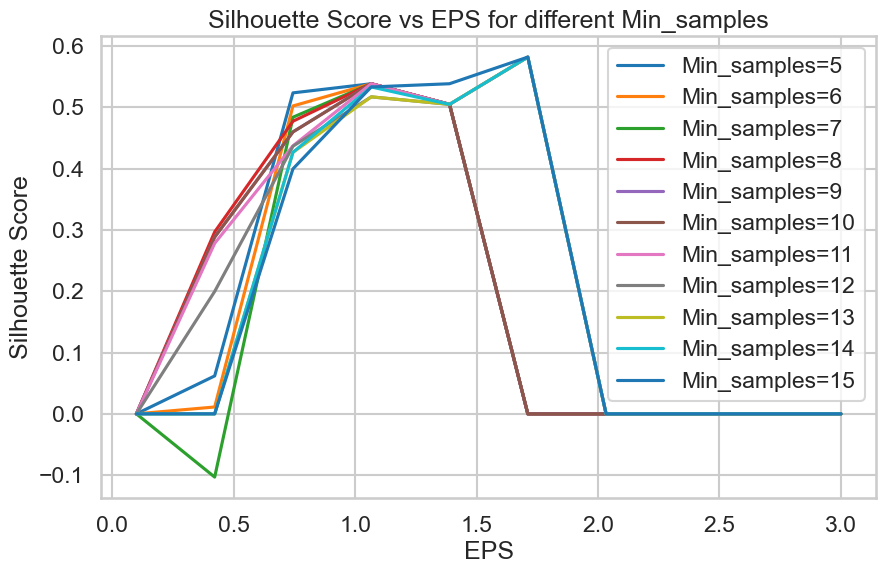

In [50]:
# Plot silhouette score versus variation in EPS and Min_samples
plt.figure(figsize=(10, 6))
for Min_samples in Min_samples_range:
    silhouette_scores = np.zeros_like(EPS_range)
    for i, EPS in enumerate(EPS_range):
        dbscan = DBSCAN(eps=EPS, min_samples=Min_samples)
        dbscan.fit(iris_df_normalized)
        no_of_unique_clusters = len(np.unique(dbscan.labels_))
            
        if no_of_unique_clusters > 1:
            silhouette_scores[i] = silhouette_score(iris_df_normalized, dbscan.labels_)
    plt.plot(EPS_range, silhouette_scores, label=f'Min_samples={Min_samples}')
plt.xlabel('EPS')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score vs EPS for different Min_samples')
plt.legend()
plt.show()

## DBscan best parameters normalized iris 

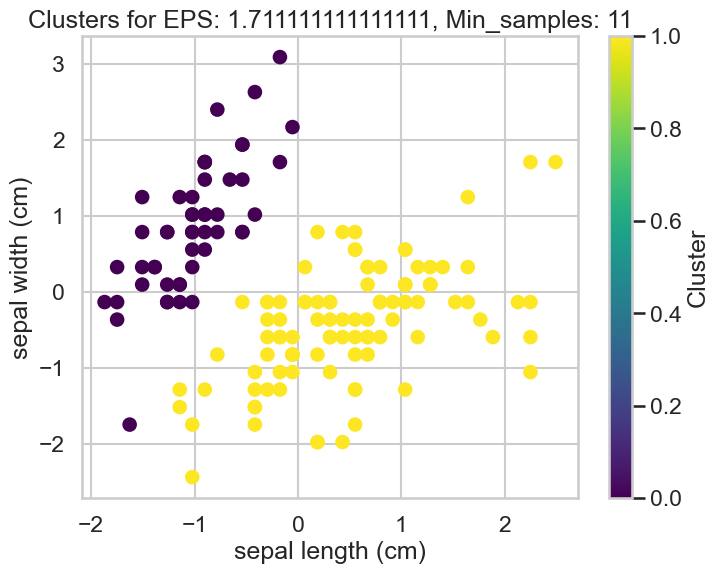

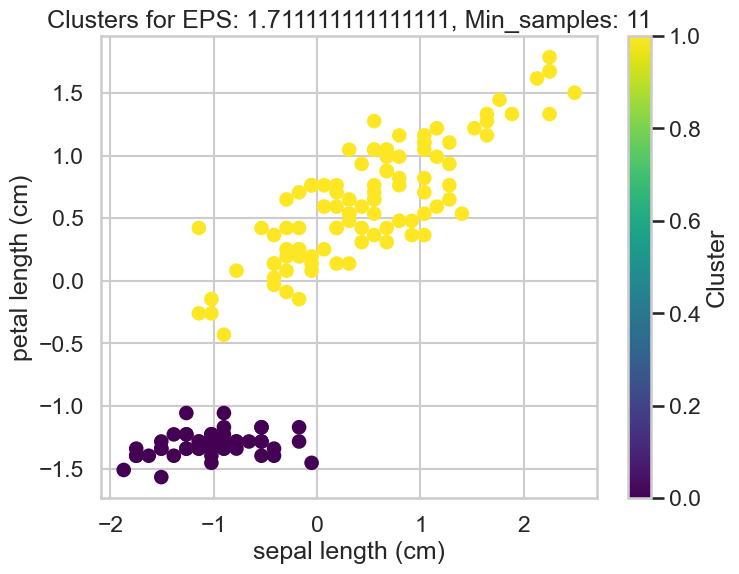

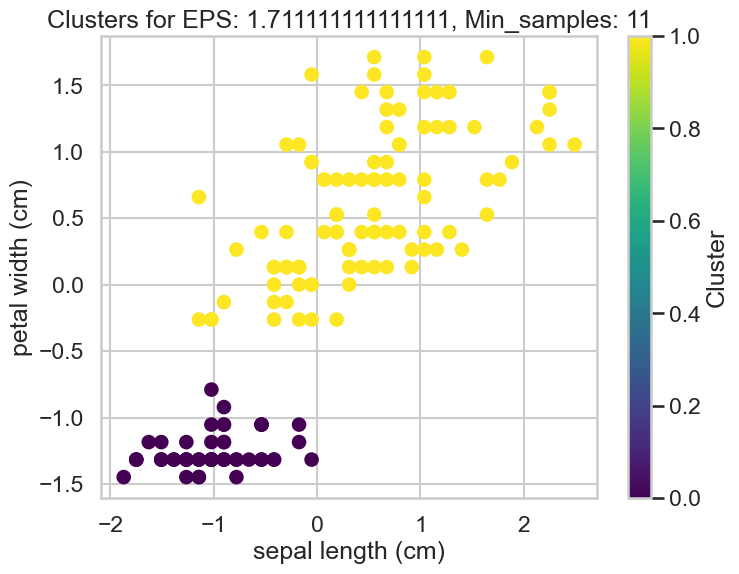

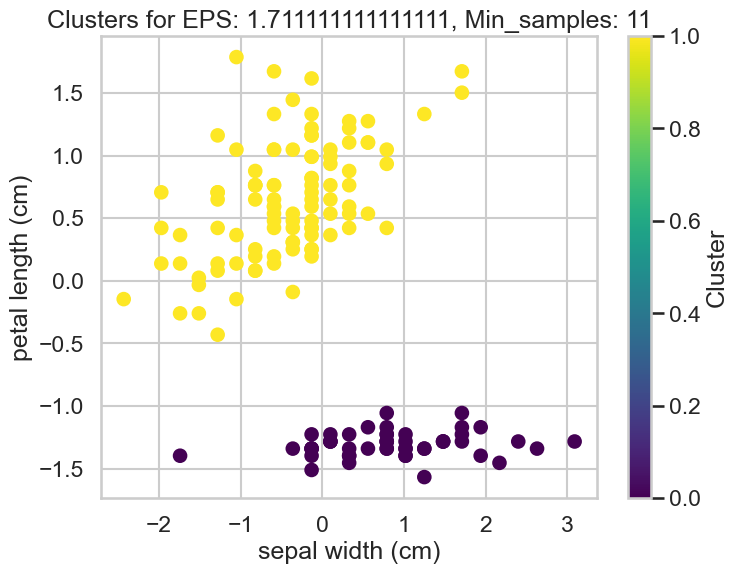

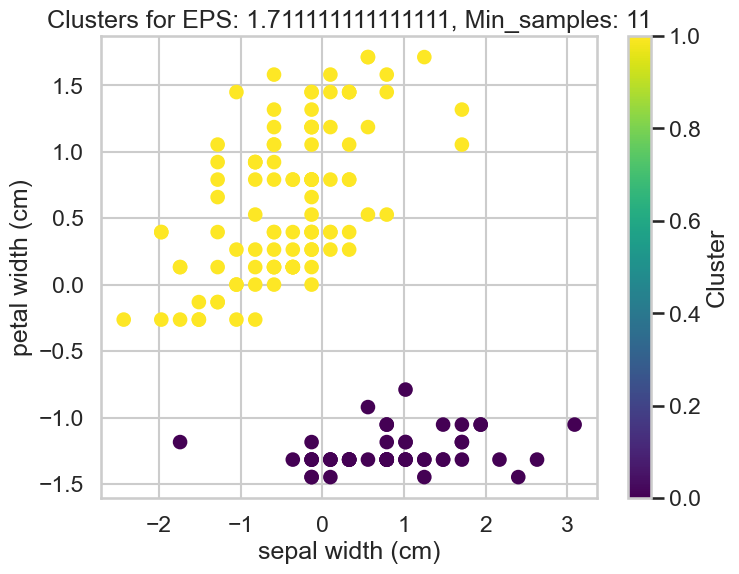

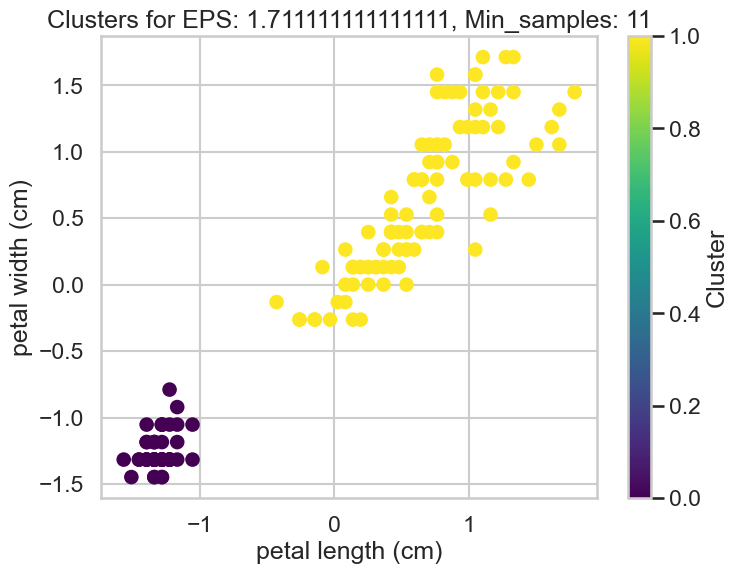

Best parameters:
{'EPS': 1.711111111111111, 'Min_samples': 11}
Best Silhouette Score: 0.5817500491982808
Best No.of Clusters: 2


In [51]:
# Create a DBSCAN instance with the best parameters
best_dbscan = DBSCAN(eps=best_parameters['EPS'], min_samples=best_parameters['Min_samples'])

# Fit the model to the data
best_dbscan.fit(iris_df_normalized)


# Plot clusters for each pair of features
for pair in feature_pairs:
    plt.figure(figsize=(8, 6)) 
    plt.title(f'Clusters for EPS: {best_parameters["EPS"]}, Min_samples: {best_parameters["Min_samples"]}')
    plt.scatter(iris_df_normalized[pair[0]],iris_df_normalized[pair[1]], c=best_dbscan.labels_, cmap='viridis')
    plt.xlabel(pair[0])  # Fixing the x-axis label here
    plt.ylabel(pair[1])
    plt.colorbar(label='Cluster')
    plt.show()
    
# Print the best parameters
print("Best parameters:")
print(best_parameters)
print(f"Best Silhouette Score: {best_silhouette_score}")
print(f"Best No.of Clusters: {len(np.unique(best_dbscan.labels_))}")

### Gaussian mixture Iris normalized dataset

In [52]:
k_values = range(2, 11)
GMM_silhouette_scores = []

best_silhouette_score = -1
best_k = None
best_covariance_type = None

for k in k_values:
    for covariance_type in covariance_types:
        # Create and fit the Gaussian Mixture Model
        gmm = GaussianMixture(n_components=k, covariance_type=covariance_type, random_state=42)
        gmm.fit(iris_df_normalized)

        # Calculate silhouette score
        labels = gmm.predict(iris_df_normalized)
        silhouette_avg = silhouette_score(iris_df_normalized, labels)
        GMM_silhouette_scores.append(silhouette_avg)

        # Check if the current silhouette score is better than the previous best score
        if silhouette_avg > best_silhouette_score:
            best_silhouette_score = silhouette_avg
            best_k = k
            best_covariance_type = covariance_type

# Print the best silhouette score, K, and covariance type
print("Best Silhouette Score:", best_silhouette_score)
print("Best K:", best_k)
print("Best Covariance Type:", best_covariance_type)


Best Silhouette Score: 0.5817500491982808
Best K: 2
Best Covariance Type: full


In [53]:
# Define pairs of features
feature_pairs = list(combinations(iris_df_normalized.columns, 2))
for covariance_type in covariance_types:
    # Create and fit the Gaussian Mixture Model
    gmm = GaussianMixture(n_components=2, covariance_type=covariance_type, random_state=42)
    gmm.fit(iris_df_normalized)
    
    for pair in feature_pairs:
        for pair in feature_pairs:
            # Create a meshgrid for plotting the contour plot
            x = np.linspace(iris_df_normalized[pair[0]].min(), iris_df_normalized[pair[0]].max(), 100)
            y = np.linspace(iris_df_normalized[pair[1]].min(), iris_df_normalized[pair[1]].max(), 100)
            X, Y = np.meshgrid(x, y)
            XX = np.array([X.ravel(), Y.ravel()]).T

            # Get the probabilities for each point in the meshgrid
            Z = -gmm.score_samples(np.hstack([XX, np.zeros((len(XX), 2))]))
            Z = Z.reshape(X.shape)
            '''
            # Plot the contour plot
            plt.figure(figsize=(8, 6))
            plt.contour(X, Y, Z, levels=np.logspace(0, 3, 10), cmap='viridis')
            plt.scatter(iris_df_normalized[pair[0]], iris_df_normalized[pair[1]], c=gmm.predict(iris_df_normalized), cmap='viridis', s=20, edgecolor='k')
            plt.title(f'GMM Contour Plot with {covariance_type.capitalize()} Covariance Type')
            plt.xlabel(pair[0])
            plt.ylabel(pair[1])
            plt.colorbar(label='Cluster')
            plt.show()
            '''

# Customer dataset
Note: for the customer dataset, most of the graphs have been removed to allow for notebook to be small enough to upload, mostly only best parameters were left to be graphed.

In [54]:
df1 = pd.read_csv(r'Customer data.csv')

In [55]:
customer_df = df1.copy()

In [56]:
# use min max scaler because we do not want to normalize, and also data is nor normally distributed so we can not use
# standard scaler
scaler = MinMaxScaler()
features_to_scale = ['Sex','Marital status','Age','Education','Income','Occupation','Settlement size']
customer_df[features_to_scale] = scaler.fit_transform(customer_df[features_to_scale])

In [57]:
# drop the ID column because we will not use it when clustering, because it is a useless feature
customer_df = customer_df.drop(columns=['ID'])

## K means clustering for customer dataset 

In [58]:
# Define pairs of features
feature_pairs = list(combinations(customer_df.columns, 2))

# Define range of k values
k_values = range(2, 11)
distortions = [] 

# Loop over each k value
for k in k_values:
    km = KMeans(n_clusters=k)
    km.fit(customer_df)    
    distortion = km.inertia_
    distortions.append(distortion)
    
#     # Plot clusters for each pair of features
#     for pair in feature_pairs:
#         plt.figure(figsize=(8, 6))
#         plt.title(f'Clustering with k={k}') 
#         display_cluster(customer_df[list(pair)].values, km=km, num_clusters=k,feature1= pair[0] ,feature2=pair[1]) 
#         plt.show()

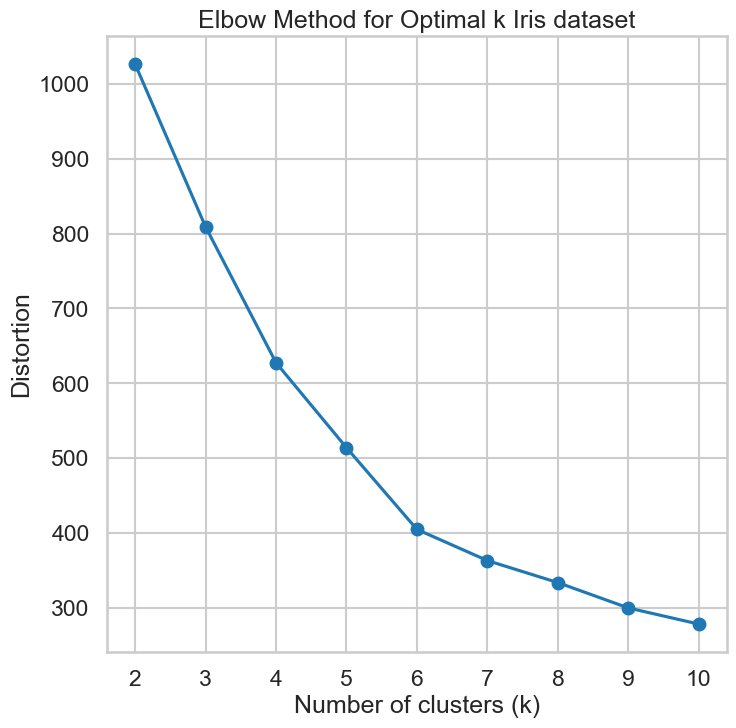

In [59]:
# Plot distortion values
plt.plot(k_values, distortions, marker='o')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Distortion')
plt.title('Elbow Method for Optimal k Iris dataset')
plt.show()

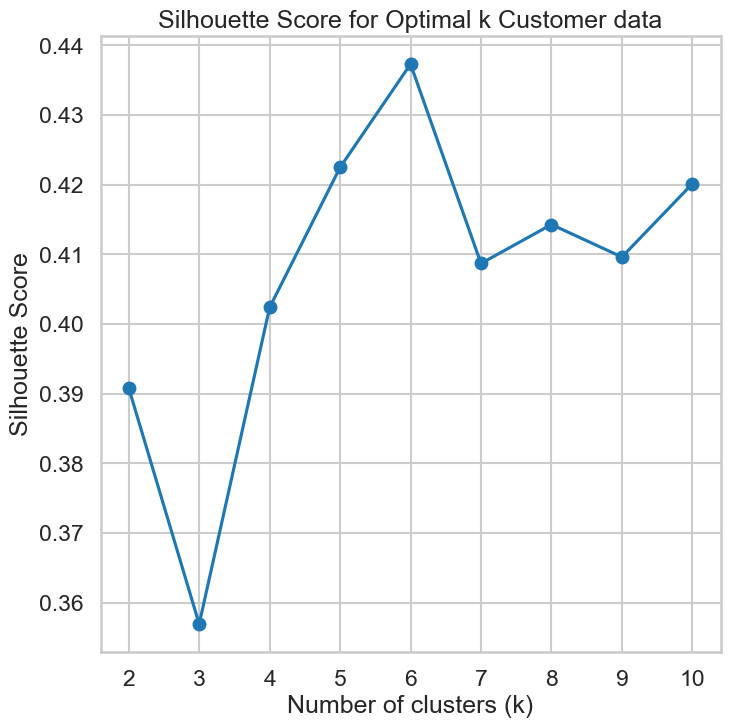

Best silhouette_score: 0.4373042442245209


In [60]:
k_values = range(2, 11)
K_Means_silhouette_scores = []

for k in k_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(customer_df)
    labels = km.labels_
    K_Means_silhouette_scores.append(silhouette_score(customer_df, labels))

# Plot silhouette scores for different k values
plt.plot(k_values, K_Means_silhouette_scores, marker='o')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score for Optimal k Customer data')
plt.show()

print(f"Best silhouette_score: {max(K_Means_silhouette_scores)}")

K = 7 is best silhouette score

## Hierarical clustering for customer dataset

In [61]:
# Define the range of parameters
affinities = ['euclidean', 'cosine']
linkages = ['average', 'single']
distance_thresholds = np.linspace(0.8,3,30)

best_silhouette_score = -1
best_parameters = {}

# Iterate over different parameter combinations
for affinity in affinities:
    for linkage_method in linkages:
        for distance_threshold in distance_thresholds:
            agg_clustering = AgglomerativeClustering(n_clusters=None, affinity=affinity, linkage=linkage_method, distance_threshold=distance_threshold)
            # Fit the model to the data
            agg_clustering.fit(customer_df)
            
            no_of_unique_clusters = len(np.unique(agg_clustering.labels_))
            
            print(f"Affinity: {affinity}, Linkage: {linkage_method}, Distance Threshold: {distance_threshold}")
            print(no_of_unique_clusters)
            
            print("------------------------")
            
            if no_of_unique_clusters > 1:
                # Compute silhouette score
                silhouette_avg = silhouette_score(customer_df, agg_clustering.labels_)
                # Check if the current silhouette score is the best so far
                if silhouette_avg > best_silhouette_score:
                    best_silhouette_score = silhouette_avg
                    best_parameters = {'Affinity': affinity, 'Linkage': linkage_method, 'Distance Threshold': distance_threshold}

                # Display the resulting clusters
                print(f"Affinity: {affinity}, Linkage: {linkage_method}, Distance Threshold: {distance_threshold}")
                print(f"Number of clusters: {agg_clustering.n_clusters_}")
                print(f"Silhouette Score: {silhouette_avg}\n")
                
                
                                 # Plot dendrogram
#                 plt.figure(figsize=(10, 6))
#                 dendrogram(linkage(customer_df, method=linkage_method, metric=affinity))
#                 plt.title(f'Dendrogram ({affinity.capitalize()} Affinity, {linkage_method.capitalize()} Linkage)')
#                 plt.xlabel('Samples')  # Fixing the x-axis label here
#                 plt.ylabel('Distance')
#                 plt.show()
                
                
#                 # Plot clusters for each pair of features
#                 for pair in feature_pairs:
#                     plt.figure(figsize=(8, 6))
#                     plt.title(f'Clustering with k={k}') 
                    
#                     plt.scatter(customer_df[pair[0]],customer_df[pair[1]], c=agg_clustering.labels_, cmap='viridis')
#                     plt.title(f'Clusters for Affinity: {affinity}, Linkage: {linkage_method}, Distance Threshold: {distance_threshold}')
#                     plt.xlabel(pair[0])  # Fixing the x-axis label here
#                     plt.ylabel(pair[1])
#                     plt.colorbar(label='Cluster')
#                     plt.show()
                
               
                
            else:
                continue
                

Affinity: euclidean, Linkage: average, Distance Threshold: 0.8
15
------------------------
Affinity: euclidean, Linkage: average, Distance Threshold: 0.8
Number of clusters: 15
Silhouette Score: 0.3717516254499508

Affinity: euclidean, Linkage: average, Distance Threshold: 0.8758620689655173
11
------------------------
Affinity: euclidean, Linkage: average, Distance Threshold: 0.8758620689655173
Number of clusters: 11
Silhouette Score: 0.37711431527690054

Affinity: euclidean, Linkage: average, Distance Threshold: 0.9517241379310346
8
------------------------
Affinity: euclidean, Linkage: average, Distance Threshold: 0.9517241379310346
Number of clusters: 8
Silhouette Score: 0.4030501405409442

Affinity: euclidean, Linkage: average, Distance Threshold: 1.0275862068965518
7
------------------------
Affinity: euclidean, Linkage: average, Distance Threshold: 1.0275862068965518
Number of clusters: 7
Silhouette Score: 0.40985394699786126

Affinity: euclidean, Linkage: average, Distance Thre

Best Parameters:
{'Affinity': 'euclidean', 'Linkage': 'average', 'Distance Threshold': 1.0275862068965518}
Best silhouette: 0.40985394699786126
Number of clusters: 7


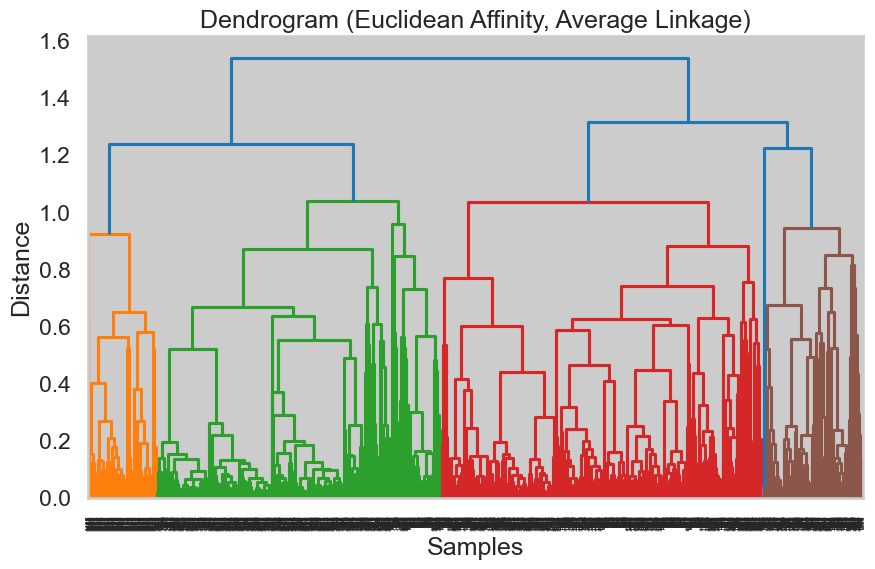

In [62]:
agg_clustering = AgglomerativeClustering(n_clusters=None, affinity=best_parameters['Affinity'], linkage=best_parameters['Linkage'], distance_threshold=best_parameters['Distance Threshold'])
# Fit the model to the data
agg_clustering.fit(customer_df)


print("Best Parameters:")
print(best_parameters)

print(f"Best silhouette: {best_silhouette_score}")

print(f"Number of clusters: {agg_clustering.n_clusters_}")

plt.figure(figsize=(10, 6))
dendrogram(linkage(customer_df, method=best_parameters['Linkage'], metric=best_parameters['Affinity']))
plt.title(f'Dendrogram ({best_parameters["Affinity"].capitalize()} Affinity, {best_parameters["Linkage"].capitalize()} Linkage)')
plt.xlabel('Samples')
plt.ylabel('Distance')
plt.show()


# # Plot clusters for each pair of features
# for pair in feature_pairs:
#     plt.figure(figsize=(8, 6))
#     plt.scatter(customer_df[pair[0]],customer_df[pair[1]], c=agg_clustering.labels_, cmap='viridis')
#     plt.title(f'Clusters for Affinity: {best_parameters["Affinity"]}, Linkage: {best_parameters["Linkage"]}, Distance Threshold: {best_parameters["Distance Threshold"]}')
#     plt.xlabel(pair[0])  # Fixing the x-axis label here
#     plt.ylabel(pair[1])
#     plt.colorbar(label='Cluster')
#     plt.show()


## DBscan clustering for customer dataset

In [63]:
best_silhouette_score = -1
best_parameters = {}

# Define the range of parameters
EPS_range = np.linspace(0.8, 3, 10)
Min_samples_range = range(5, 26)

# Iterate over different parameter combinations
for EPS in EPS_range:
    for Min_samples in Min_samples_range:
        dbscan = DBSCAN(eps=EPS, min_samples=Min_samples)
        # Fit the model to the data
        dbscan.fit(customer_df)
        no_of_unique_clusters = len(np.unique(dbscan.labels_))
            
        if no_of_unique_clusters > 1:
        
            # Compute silhouette score
            silhouette_avg = silhouette_score(customer_df, dbscan.labels_)

#            # Plot clusters for each pair of features
#             for pair in feature_pairs:
#                 plt.figure(figsize=(8, 6)) 
#                 plt.title(f'Clusters for EPS: {EPS}, Min_samples: {Min_samples}')
#                 plt.scatter(customer_df[pair[0]],customer_df[pair[1]], c=dbscan.labels_, cmap='viridis')
#                 plt.xlabel(pair[0])  # Fixing the x-axis label here
#                 plt.ylabel(pair[1])
#                 plt.colorbar(label='Cluster')
#                 plt.show()


            # Print silhouette score and parameters
            print(f"EPS: {EPS}, Min_samples: {Min_samples}")
            print(f"Number of clusters: {len(np.unique(dbscan.labels_))}")  # Exclude noise label
            print(f"Silhouette Score: {silhouette_avg}\n")

            # Check if the current silhouette score is the best so far
            if silhouette_avg > best_silhouette_score:
                best_silhouette_score = silhouette_avg
                best_parameters = {'EPS': EPS, 'Min_samples': Min_samples}
        else:
            continue


EPS: 0.8, Min_samples: 5
Number of clusters: 4
Silhouette Score: 0.40358876358465273

EPS: 0.8, Min_samples: 6
Number of clusters: 4
Silhouette Score: 0.40358876358465273

EPS: 0.8, Min_samples: 7
Number of clusters: 4
Silhouette Score: 0.40358876358465273

EPS: 0.8, Min_samples: 8
Number of clusters: 4
Silhouette Score: 0.40358876358465273

EPS: 0.8, Min_samples: 9
Number of clusters: 4
Silhouette Score: 0.40358876358465273

EPS: 0.8, Min_samples: 10
Number of clusters: 4
Silhouette Score: 0.40358876358465273

EPS: 0.8, Min_samples: 11
Number of clusters: 4
Silhouette Score: 0.40358876358465273

EPS: 0.8, Min_samples: 12
Number of clusters: 4
Silhouette Score: 0.40358876358465273

EPS: 0.8, Min_samples: 13
Number of clusters: 4
Silhouette Score: 0.40358876358465273

EPS: 0.8, Min_samples: 14
Number of clusters: 4
Silhouette Score: 0.40358876358465273

EPS: 0.8, Min_samples: 15
Number of clusters: 4
Silhouette Score: 0.40358876358465273

EPS: 0.8, Min_samples: 16
Number of clusters: 4


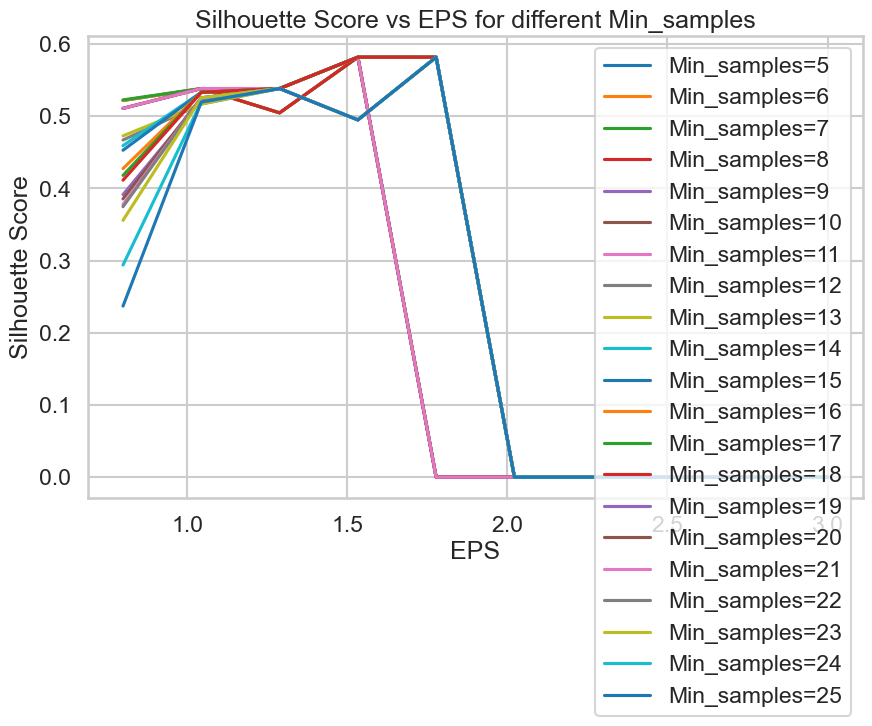

In [64]:
# Plot silhouette score versus variation in EPS and Min_samples
plt.figure(figsize=(10, 6))
for Min_samples in Min_samples_range:
    silhouette_scores = np.zeros_like(EPS_range)
    for i, EPS in enumerate(EPS_range):
        dbscan = DBSCAN(eps=EPS, min_samples=Min_samples)
        dbscan.fit(iris_df_normalized)
        no_of_unique_clusters = len(np.unique(dbscan.labels_))
            
        if no_of_unique_clusters > 1:
            silhouette_scores[i] = silhouette_score(iris_df_normalized, dbscan.labels_)
    plt.plot(EPS_range, silhouette_scores, label=f'Min_samples={Min_samples}')
plt.xlabel('EPS')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score vs EPS for different Min_samples')
plt.legend()
plt.show()

## DBscan best parameters 

In [65]:
# Create a DBSCAN instance with the best parameters
best_dbscan = DBSCAN(eps=best_parameters['EPS'], min_samples=best_parameters['Min_samples'])

# Fit the model to the data
best_dbscan.fit(customer_df)


# Plot clusters for each pair of features
'''
for pair in feature_pairs:
    plt.figure(figsize=(8, 6)) 
    plt.title(f'Clusters for EPS: {best_parameters["EPS"]}, Min_samples: {best_parameters["Min_samples"]}')
    plt.scatter(customer_df[pair[0]],customer_df[pair[1]], c=best_dbscan.labels_, cmap='viridis')
    plt.xlabel(pair[0])  # Fixing the x-axis label here
    plt.ylabel(pair[1])
    plt.colorbar(label='Cluster')
    plt.show()
'''    
# Print the best parameters
print("Best parameters:")
print(best_parameters)
print(f"Best Silhouette Score: {best_silhouette_score}")
print(f"Best No.of Clusters: {len(np.unique(best_dbscan.labels_))}")

Best parameters:
{'EPS': 0.8, 'Min_samples': 5}
Best Silhouette Score: 0.40358876358465273
Best No.of Clusters: 4


### Gaussian mixture clustering for customer dataset

In [66]:
k_values = range(2, 11)
GMM_silhouette_scores = []

best_silhouette_score = -1
best_k = None
best_covariance_type = None

for k in k_values:
    for covariance_type in covariance_types:
        # Create and fit the Gaussian Mixture Model
        gmm = GaussianMixture(n_components=k, covariance_type=covariance_type, random_state=42)
        gmm.fit(customer_df)

        # Calculate silhouette score
        labels = gmm.predict(customer_df)
        silhouette_avg = silhouette_score(customer_df, labels)
        GMM_silhouette_scores.append(silhouette_avg)

        # Check if the current silhouette score is better than the previous best score
        if silhouette_avg > best_silhouette_score:
            best_silhouette_score = silhouette_avg
            best_k = k
            best_covariance_type = covariance_type

# Print the best silhouette score, K, and covariance type
print("Best Silhouette Score:", best_silhouette_score)
print("Best K:", best_k)
print("Best Covariance Type:", best_covariance_type)


Best Silhouette Score: 0.43622901776342066
Best K: 8
Best Covariance Type: diag


In [67]:
from sklearn.metrics import silhouette_score

# Initialize variables to store the best silhouette score and covariance type
best_silhouette_score = -1
best_covariance_type = None

# Iterate over each covariance type
for covariance_type in covariance_types:
    silhouette_scores = []  # Store silhouette scores for each covariance type
    
    # Create and fit the Gaussian Mixture Model
    gmm = GaussianMixture(n_components=6, covariance_type=covariance_type, random_state=42)
    gmm.fit(customer_df)
    
    for pair in feature_pairs:
        # Create a meshgrid for plotting the contour plot
        x = np.linspace(customer_df[pair[0]].min(), customer_df[pair[0]].max(), 100)
        y = np.linspace(customer_df[pair[1]].min(), customer_df[pair[1]].max(), 100)
        X, Y = np.meshgrid(x, y)
        XX = np.array([X.ravel(), Y.ravel()]).T

        # Get the probabilities for each point in the meshgrid
        Z = -gmm.score_samples(np.hstack([XX, np.zeros((len(XX), len(customer_df.columns) - 2))]))
        Z = Z.reshape(X.shape)

        # Plot the contour plot
        '''
        plt.figure(figsize=(8, 6))
        plt.contour(X, Y, Z, levels=np.logspace(0, 3, 10), cmap='viridis')
        plt.scatter(customer_df[pair[0]], customer_df[pair[1]], c=gmm.predict(customer_df), cmap='viridis', s=20, edgecolor='k')
        plt.title(f'GMM Contour Plot with {covariance_type.capitalize()} Covariance Type')
        plt.xlabel(pair[0])
        plt.ylabel(pair[1])
        plt.colorbar(label='Cluster')
        plt.show()
        '''
    # Calculate the silhouette score for the current covariance type
    cluster_labels = gmm.predict(customer_df)
    silhouette_avg = silhouette_score(customer_df, cluster_labels)
    silhouette_scores.append(silhouette_avg)
    
    # Check if the current silhouette score is better than the previous best score
    if silhouette_avg > best_silhouette_score:
        best_silhouette_score = silhouette_avg
        best_covariance_type = covariance_type

# Print the best covariance type and its corresponding silhouette score
print("Best Covariance Type:", best_covariance_type)
print("Best Silhouette Score:", best_silhouette_score)


Best Covariance Type: diag
Best Silhouette Score: 0.40662895037621977
